# Traffic Sign Detection

## [1] Business Problem
Traffic signs are an important part of road safety when it comes to driving vehicles. They provide critical information using which users can avoid road accidents. These are enforced by the government to ensure road safety. 

The objective here is to automatically classify a traffic sign using deep learning techniques.

Source - http://benchmark.ini.rub.de/?section=gtsrb&subsection=dataset

## [2] About the data

*   This is a single image multiclass classification problem.
*   Dataset contains a total of 43 classes.
*   More than 50,000 images (data points).

### [2.1] Image format

*   The images contain one traffic sign each.
*   Images are stored in PPM(portable pixmap) format.
*   Image sizes vary between 15x15 to 250x250 pixels.
*   Images are not necessarily squared.

### [2.2] Annotations format

Annotations are provided in CSV files. Fields are separated by ";"   (semicolon). Annotations contain the following information:

*   **Filename:** Filename of corresponding image.
*   **Width:** Width of the image.
*   **Height:** Height of the image.
*   **ROI.x1:** X-coordinate of top-left corner of traffic sign bounding box.
*   **ROI.y1:** Y-coordinate of top-left corner of traffic sign bounding box.
*   **ROI.x2:** X-coordinate of bottom-right corner of traffic sign bounding box.
*   **ROI.y2:** Y-coordinate of bottom-right corner of traffic sign bounding box.
*   **ClassId:** Assigned class label.







## [3] Data Munging
### [3.1] Data download and extract

In [0]:
!ls

sample_data


In [1]:
!wget https://sid.erda.dk/public/archives/daaeac0d7ce1152aea9b61d9f1e19370/GTSRB_Final_Training_Images.zip
!mkdir images
!unzip GTSRB_Final_Training_Images.zip -d images
!ls

--2019-06-29 10:18:16--  https://sid.erda.dk/public/archives/daaeac0d7ce1152aea9b61d9f1e19370/GTSRB_Final_Training_Images.zip
Resolving sid.erda.dk (sid.erda.dk)... 130.225.104.13
Connecting to sid.erda.dk (sid.erda.dk)|130.225.104.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 276294756 (263M) [application/zip]
Saving to: ‘GTSRB_Final_Training_Images.zip’

GTSRB_Final_Trainin 100%[===================>] 263.50M  23.3MB/s    in 12s     

2019-06-29 10:18:29 (21.6 MB/s) - ‘GTSRB_Final_Training_Images.zip’ saved [276294756/276294756]

Archive:  GTSRB_Final_Training_Images.zip
  inflating: images/GTSRB/Final_Training/Images/00000/00000_00000.ppm  
  inflating: images/GTSRB/Final_Training/Images/00000/00000_00001.ppm  
  inflating: images/GTSRB/Final_Training/Images/00000/00000_00002.ppm  
  inflating: images/GTSRB/Final_Training/Images/00000/00000_00003.ppm  
  inflating: images/GTSRB/Final_Training/Images/00000/00000_00004.ppm  
  inflating: images/GTSRB/Fina

In [2]:
!ls images/GTSRB/Final_Training/Images

00000  00004  00008  00012  00016  00020  00024  00028	00032  00036  00040
00001  00005  00009  00013  00017  00021  00025  00029	00033  00037  00041
00002  00006  00010  00014  00018  00022  00026  00030	00034  00038  00042
00003  00007  00011  00015  00019  00023  00027  00031	00035  00039


In [3]:
#importing necessary libraries
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
import os
import glob
import pandas as pd
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import seaborn as sns
from sklearn.metrics import f1_score

import keras
from keras.models import Model
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.layers import Conv2D, MaxPooling2D
from keras import backend as K
from keras.layers.normalization import BatchNormalization

dir_path = 'images/GTSRB/Final_Training/Images'

Using TensorFlow backend.


In [4]:
# each class has a separate directory and each directory contains a csv
# so here we are loading all the csv and merging them into one dataframe while
# we preserve the classes
flag = False
for dir_ in os.listdir(dir_path):
    if flag == False:
        df = pd.read_csv(os.path.join(dir_path, dir_, 'GT-'+dir_+'.csv'), sep=';')
        flag = True
    else:
        df_temp = pd.read_csv(os.path.join(dir_path, dir_, 'GT-'+dir_+'.csv'), sep=';')
        df = pd.concat([df, df_temp])
df.reset_index(drop=True, inplace=True)
df.head()

,Filename,Width,Height,Roi.X1,Roi.Y1,Roi.X2,Roi.Y2,ClassId
0,00000_00000.ppm,26,26,6,6,21,21,18
1,00000_00001.ppm,27,27,5,6,21,22,18
2,00000_00002.ppm,27,27,5,6,22,22,18
3,00000_00003.ppm,27,27,5,6,22,22,18
4,00000_00004.ppm,27,27,5,6,22,22,18


In [5]:
# moving the images into one folder for better accessibility
!mkdir data
for dir_ in os.listdir(dir_path):
    for img in os.listdir(os.path.join(dir_path, dir_)):
        if img.endswith('.ppm'):
            os.rename(os.path.join(dir_path, dir_, img), os.path.join('data', str(int(dir_))+'_'+img))
!ls data

0_00000_00000.ppm   13_00064_00023.ppm	25_00037_00016.ppm  38_00066_00010.ppm
0_00000_00001.ppm   13_00064_00024.ppm	25_00037_00017.ppm  38_00066_00011.ppm
0_00000_00002.ppm   13_00064_00025.ppm	25_00037_00018.ppm  38_00066_00012.ppm
0_00000_00003.ppm   13_00064_00026.ppm	25_00037_00019.ppm  38_00066_00013.ppm
0_00000_00004.ppm   13_00064_00027.ppm	25_00037_00020.ppm  38_00066_00014.ppm
0_00000_00005.ppm   13_00064_00028.ppm	25_00037_00021.ppm  38_00066_00015.ppm
0_00000_00006.ppm   13_00064_00029.ppm	25_00037_00022.ppm  38_00066_00016.ppm
0_00000_00007.ppm   13_00065_00000.ppm	25_00037_00023.ppm  38_00066_00017.ppm
0_00000_00008.ppm   13_00065_00001.ppm	25_00037_00024.ppm  38_00066_00018.ppm
0_00000_00009.ppm   13_00065_00002.ppm	25_00037_00025.ppm  38_00066_00019.ppm
0_00000_00010.ppm   13_00065_00003.ppm	25_00037_00026.ppm  38_00066_00020.ppm
0_00000_00011.ppm   13_00065_00004.ppm	25_00037_00027.ppm  38_00066_00021.ppm
0_00000_00012.ppm   13_00065_00005.ppm	25_00037_00028.ppm  38_00

In [6]:
df['Filename'] = df['ClassId'].astype(str) + '_' + df['Filename']
df.head()

,Filename,Width,Height,Roi.X1,Roi.Y1,Roi.X2,Roi.Y2,ClassId
0,18_00000_00000.ppm,26,26,6,6,21,21,18
1,18_00000_00001.ppm,27,27,5,6,21,22,18
2,18_00000_00002.ppm,27,27,5,6,22,22,18
3,18_00000_00003.ppm,27,27,5,6,22,22,18
4,18_00000_00004.ppm,27,27,5,6,22,22,18


In [0]:
df['ClassId'].value_counts()

2     2250
1     2220
13    2160
12    2100
38    2070
10    2010
4     1980
5     1860
25    1500
9     1470
7     1440
8     1410
3     1410
11    1320
18    1200
35    1200
17    1110
31     780
14     780
33     689
15     630
26     600
28     540
23     510
30     450
34     420
6      420
16     420
22     390
36     390
40     360
20     360
21     330
39     300
24     270
29     270
32     240
42     240
41     240
27     240
37     210
19     210
0      210
Name: ClassId, dtype: int64

### [3.2] Distribution of classes
We have an im-balanced data here, with most of data points belonging to class 2 and the least of the data points belonging to class 0.

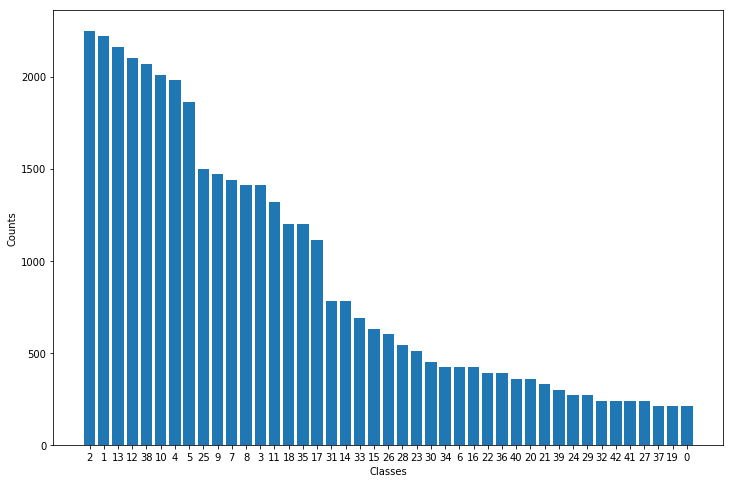

In [0]:
plt.figure(figsize=(12, 8))
x = df['ClassId'].value_counts().index
y = df['ClassId'].value_counts().values
plt.bar([str(i) for i in x], y)
plt.xlabel("Classes")
plt.ylabel("Counts")
plt.show()

### [3.3] Image cropping and Grey scale conversion

*   We have been given the bounding box positions for each which contains the traffic sign. We'll use those coordinates to extract the traffic sign for our classification problem for better accuracy.
*   We find the optimal image size for training so that while we reshape each image, losing information is avoided for most of the images.
*   We convert each image into Grey scale for training our network.



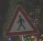

In [0]:
im = Image.open('data/27_00000_00000.ppm')
im

In [0]:
df['Width'].describe()

count    39209.000000
mean        50.835880
std         24.306933
min         25.000000
25%         35.000000
50%         43.000000
75%         58.000000
max        243.000000
Name: Width, dtype: float64

In [0]:
df['Height'].describe()

count    39209.000000
mean        50.328930
std         23.115423
min         25.000000
25%         35.000000
50%         43.000000
75%         58.000000
max        225.000000
Name: Height, dtype: float64

In [0]:
im.size

(43, 41)

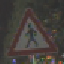

In [0]:
im_new = im.resize((64, 64))
im_new

In [0]:
df.loc[df['Height'].idxmax()]

Filename    25_00003_00029.ppm
Width                      243
Height                     225
Roi.X1                      20
Roi.Y1                      20
Roi.X2                     223
Roi.Y2                     205
ClassId                     25
Name: 18569, dtype: object

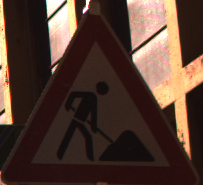

In [0]:
im_temp = Image.open('data/25_00003_00029.ppm')
im_temp = im_temp.crop((20, 20, 223, 205))
im_temp

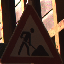

In [0]:
im_temp.resize((64, 64))

In [7]:
# this code snippet contains code for cropping the images based on coordinates
# and resizing the image 
!mkdir cropped_data
for idx, row in tqdm(df.iterrows(), total=df.shape[0]):
    im = Image.open('data/'+row['Filename'])
    im_crop = im.crop((row['Roi.X1'], row['Roi.Y1'], row['Roi.X2'], row['Roi.Y2']))
    im_resize = im_crop.resize((64, 64))
    im_resize.save('cropped_data/'+row['Filename'])

100%|██████████| 39209/39209 [00:19<00:00, 2036.30it/s]


In [8]:
# this code snippet contains code for grey scale conversion of each image
!mkdir grey_data
for idx, row in tqdm(df.iterrows(), total=df.shape[0]):
    im = Image.open('cropped_data/'+row['Filename']).convert('L')
    im.save('grey_data/'+row['Filename'].split(".")[0]+".png", format='png')

100%|██████████| 39209/39209 [00:26<00:00, 1465.12it/s]


In [9]:
# we extract features from each image in ndarray format
labels = []
img_feats_grey = []
for img in tqdm(os.listdir('grey_data')):
        im = Image.open('grey_data/'+img)
        img_feats_grey.append(np.array(im))
        labels.append(int(img.split("_")[0]))
img_feats_grey = np.array(img_feats_grey)
img_feats_grey.shape, len(labels)

100%|██████████| 39209/39209 [00:06<00:00, 6160.36it/s]


((39209, 64, 64), 39209)

### [3.4] Train - Test split

In [0]:
x_train, x_test, y_train, y_test = train_test_split(img_feats_grey, labels, test_size=0.3, random_state=42)
x_train.shape, len(y_train)

((27446, 64, 64), 27446)

### [3.5] Data normalization and reshaping

In [0]:
input_shape = (64, 64, 1)

In [0]:
batch_size = 128
num_classes = 43

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
# convert class vectors to binary class matrices
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)
x_train = x_train.reshape(x_train.shape[0], 64, 64, 1)
x_test = x_test.reshape(x_test.shape[0], 64, 64, 1)
x_train.shape, len(y_train)

((27446, 64, 64, 1), 27446)

## [4] Utility Functions

*   **plt_dynamic:** A function that plots a graph given training and validation loss.
*   **display_activation:** A function that displays the feature (visualization) of each kernel given an image, layer number and the number of visualizations you want in each row and column.
*   **display_feature_spike:** We take the output of each kernel in a layer and take the mean of values of each kernel output. For example, if we have 64 kernels (3x3) in a 2nd layer and we input an image of shape 64x64, we get an output of 62x62x64. If we take the mean of all 62x62 values, then we have a total of 64 means which we plot in a graph in this function. If we get a spike at 12 index in the graph for example, then we know for this particular input image, 12th kernel in 2nd layer responds!
* **display_activation_kernel:** Once we get the kernel number from display_feature_spike() and layer number, we display the output image (after it passes through the kernel). 
* **call_utilities_features:** Calls all the above functions one after the other. Also prints the probablities of top 5 classes in a bar graph.



In [0]:
# utility functions

def plt_dynamic(fig, x, vy, ty, ax, colors=['b']):
    ax.plot(x, vy, 'b', label="Validation Loss")
    ax.plot(x, ty, 'r', label="Train Loss")
    plt.legend()
    plt.grid()
    fig.canvas.draw()

def display_activation(activations, col_size, row_size, act_index): 
    activation = activations[act_index]
    activation_index=0
    fig, ax = plt.subplots(row_size, col_size, figsize=(row_size*2.5,col_size*1.5))
    for row in range(0,row_size):
        for col in range(0,col_size):
            ax[row][col].imshow(activation[0, :, :, activation_index], cmap='gray')
            activation_index += 1
    plt.show()
    print("Multiple kernel activations starting from 0")
            
def display_activation_kernel(activations, col_size, row_size, act_index, kernel_index):
    activation = activations[act_index]
    plt.figure(figsize=(7, 4))
    plt.imshow(activation[0, :, :, kernel_index], cmap='gray')
    plt.show()
    print("Activation for", kernel_index, "kernel in", act_index, "layer.")

#https://towardsdatascience.com/how-to-visualize-convolutional-features-in-40-lines-of-code-70b7d87b0030
def display_feature_spike(activations, col_size, row_size, act_index):
    activation = activations[act_index]
    means = []
    for act in range(activation.shape[3]):
        means.append(np.mean(activation[0, :, :, act]))
    print("The kernel which activates/recognizes the shape:", np.argmax(means))
    plt.figure(figsize=(12, 8))
    plt.plot([str(i) for i in range(len(means))], means)
    plt.xticks(rotation=90)
    plt.show()
    return np.argmax(means)


In [0]:
def call_utilities_features(img_idx, activations, col_size, row_size, act_index, y_true, y_pred):
    print("Actual class it belongs to:", y_true[img_idx])
    print("Predicted class", np.argmax(y_pred[img_idx]))
    print("Actual training image")
    plt.imshow(x_test[img_idx].reshape(64,64))
    plt.show()
    kernel_index = display_feature_spike(activations, col_size, row_size, act_index)
    display_activation(activations, col_size, row_size, act_index)
    display_activation_kernel(activations, col_size, row_size, act_index, kernel_index)
    classes = np.array([str(i) for i in range(num_classes)])
    probs = y_pred[img_idx]
    idxs = probs.argsort()
    probs = probs[idxs][::-1][:5]
    classes = classes[idxs][::-1][:5]
    plt.figure()
    plt.bar(classes, probs)
    plt.show()
    print("Probabilities of top 5 classes.")

## [5] Models building

### [5.1] Conv(8 -- 3x3) - Conv(16 -- 3x3) - MaxPool(2x2) - Dropout(0.75) - Dense(128) - Dropout(0.5)

In [0]:
epochs = 10
model = Sequential()
model.add(Conv2D(
    8, kernel_size=(3, 3), activation='relu', input_shape=input_shape
))
model.add(Conv2D(16, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(rate=0.75))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

W0627 05:25:59.127976 140709411673984 nn_ops.py:4224] Large dropout rate: 0.75 (>0.5). In TensorFlow 2.x, dropout() uses dropout rate instead of keep_prob. Please ensure that this is intended.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_3 (Conv2D)            (None, 62, 62, 8)         80        
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 60, 60, 16)        1168      
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 30, 30, 16)        0         
_________________________________________________________________
dropout_3 (Dropout)          (None, 30, 30, 16)        0         
_________________________________________________________________
flatten_2 (Flatten)          (None, 14400)             0         
_________________________________________________________________
dense_3 (Dense)              (None, 128)               1843328   
_________________________________________________________________
dropout_4 (Dropout)          (None, 128)               0         
__________

Test loss: 0.134081609957259
Test accuracy: 0.9728810677548244


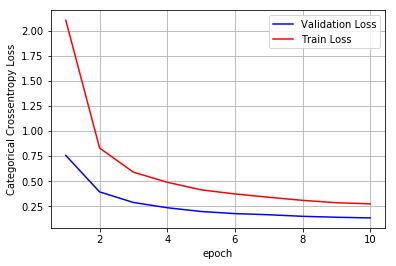

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9713559900036074
------------------------------------------------------


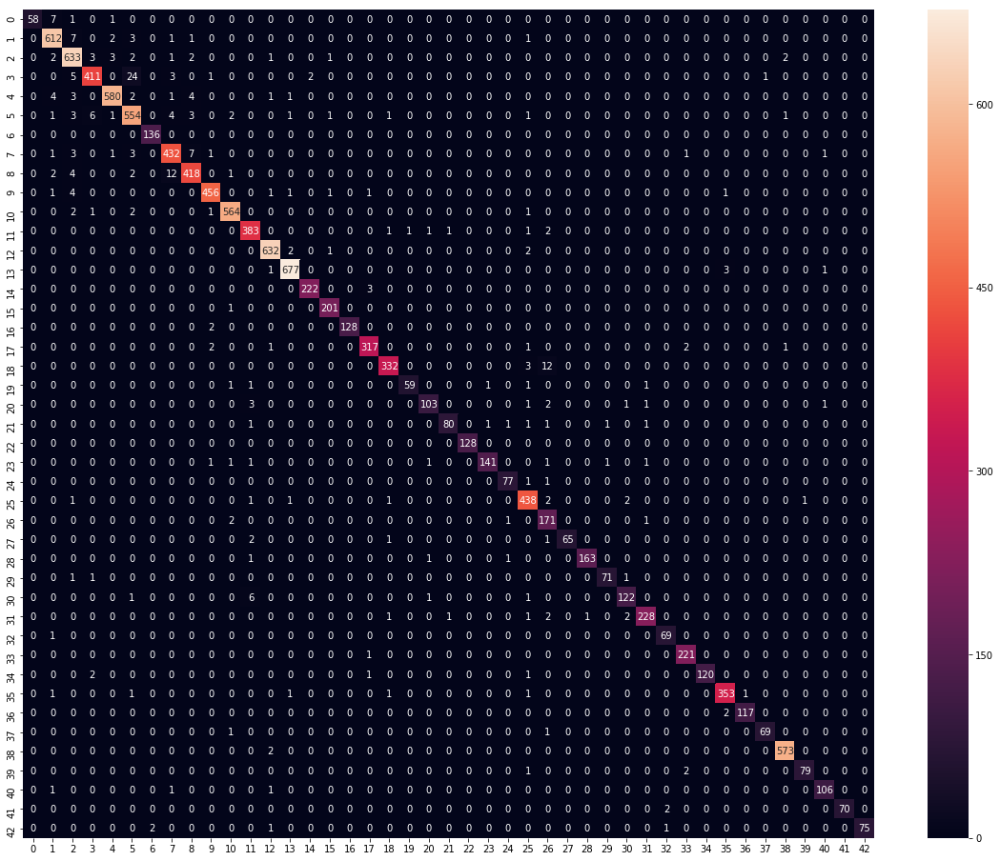

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 9
Predicted class 9
Actual training image


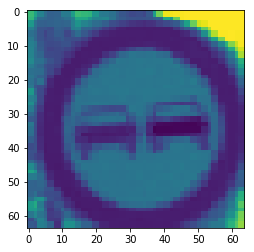

The kernel which activates/recognizes the shape: 4


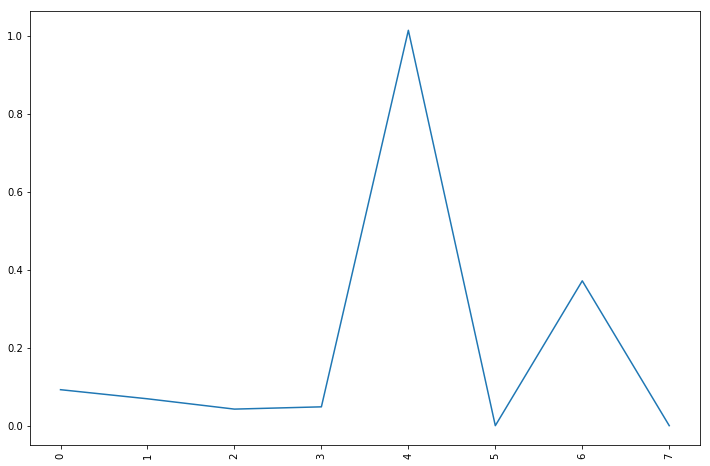

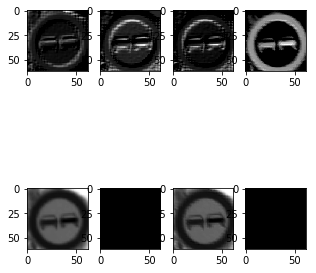

Multiple kernel activations starting from 0


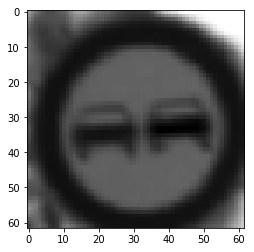

Activation for 4 kernel in 0 layer.


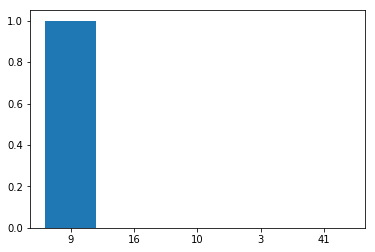

Probabilities of top 5 classes.


In [0]:
idx = 25
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 2, 0, y_true, y_prediction)

Actual class it belongs to: 9
Predicted class 9
Actual training image


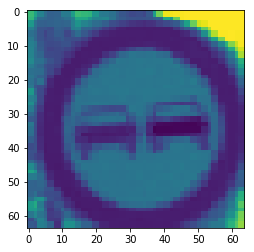

The kernel which activates/recognizes the shape: 2


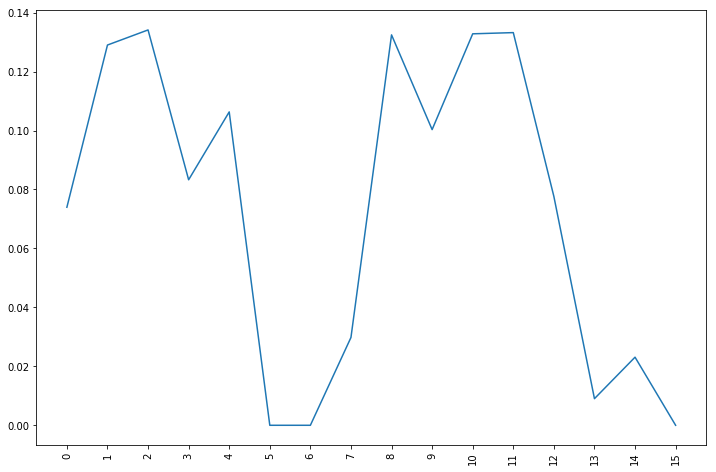

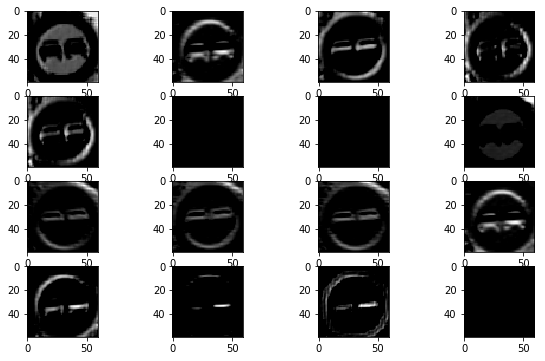

Multiple kernel activations starting from 0


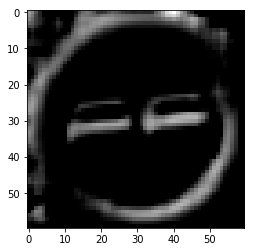

Activation for 2 kernel in 1 layer.


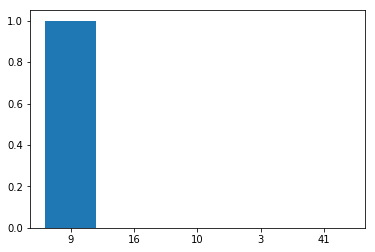

Probabilities of top 5 classes.


In [0]:
call_utilities_features(idx, activations, 4, 4, 1, y_true, y_prediction)

Actual class it belongs to: 40
Predicted class 40
Actual training image


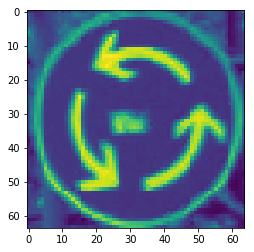

The kernel which activates/recognizes the shape: 4


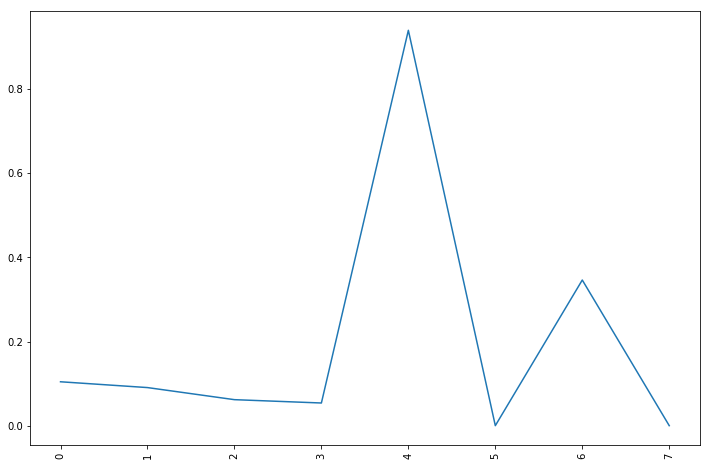

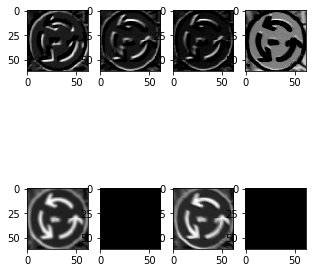

Multiple kernel activations starting from 0


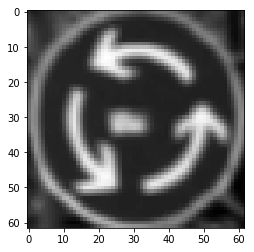

Activation for 4 kernel in 0 layer.


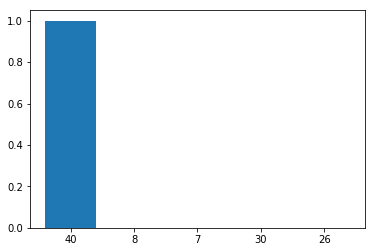

Probabilities of top 5 classes.
Actual class it belongs to: 40
Predicted class 40
Actual training image


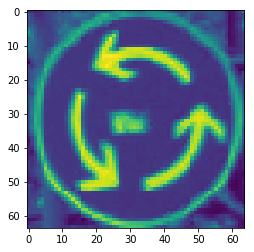

The kernel which activates/recognizes the shape: 11


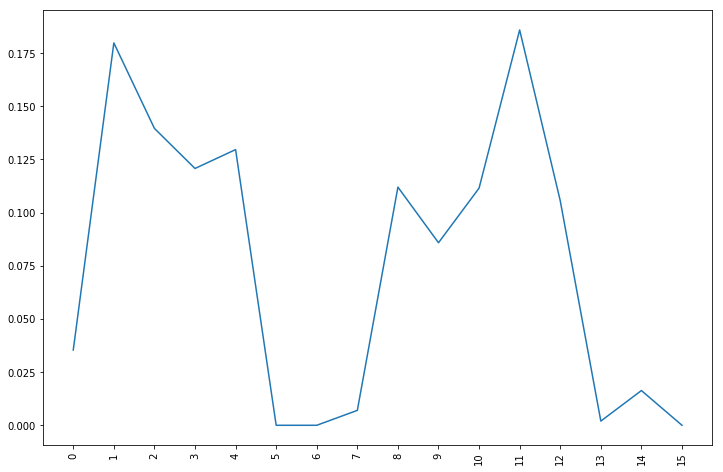

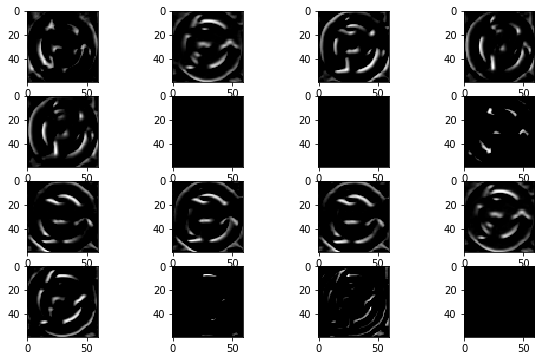

Multiple kernel activations starting from 0


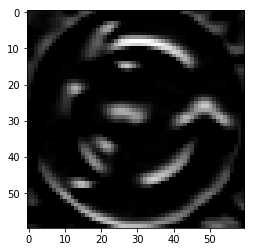

Activation for 11 kernel in 1 layer.


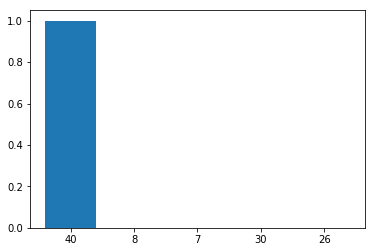

Probabilities of top 5 classes.


In [0]:
idx = 100
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 2, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 4, 4, 1, y_true, y_prediction)

In [0]:
actual_class = []
index_image = []
predicted_class = []
for idx, im in enumerate(y_true):
    if im != np.argmax(y_prediction[idx]):
        actual_class.append(im)
        predicted_class.append(np.argmax(y_prediction[idx]))
        index_image.append(idx)
np.array(index_image)

array([   11,    20,    41,    88,   126,   151,   157,   163,   215,
         250,   258,   358,   365,   434,   569,   576,   592,   643,
         684,   696,   803,   836,   882,   981,  1053,  1097,  1105,
        1107,  1108,  1145,  1148,  1152,  1182,  1188,  1210,  1243,
        1275,  1278,  1314,  1320,  1321,  1391,  1394,  1478,  1485,
        1578,  1587,  1609,  1689,  1728,  1737,  1748,  1750,  1755,
        1774,  1811,  1840,  1880,  1915,  1926,  1998,  2028,  2033,
        2045,  2082,  2166,  2218,  2283,  2288,  2336,  2361,  2516,
        2534,  2657,  2680,  2722,  2735,  2791,  2831,  2869,  2873,
        2925,  2978,  3050,  3055,  3113,  3450,  3470,  3489,  3510,
        3513,  3523,  3530,  3551,  3576,  3592,  3665,  3669,  3730,
        3846,  3853,  3909,  3962,  3989,  4028,  4046,  4083,  4144,
        4157,  4277,  4302,  4316,  4319,  4369,  4375,  4435,  4477,
        4553,  4558,  4611,  4636,  4646,  4738,  4743,  4889,  4921,
        4926,  4953,

Actual class it belongs to: 33
Predicted class 14
Actual training image


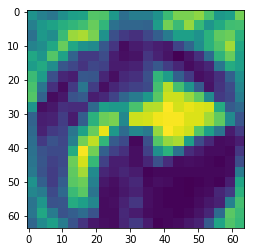

The kernel which activates/recognizes the shape: 4


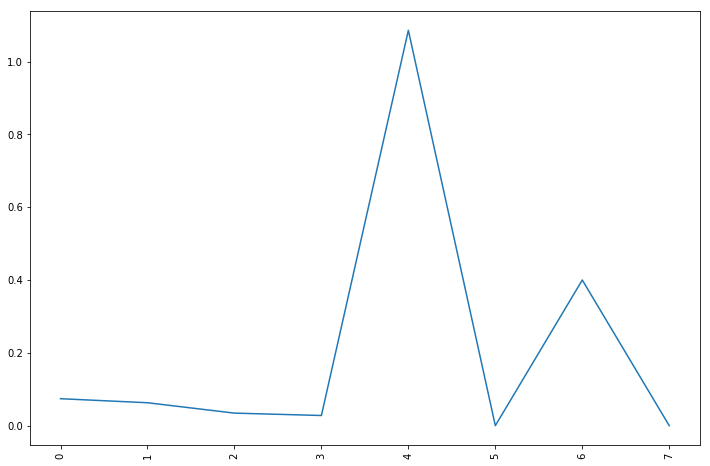

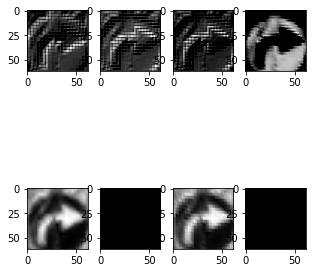

Multiple kernel activations starting from 0


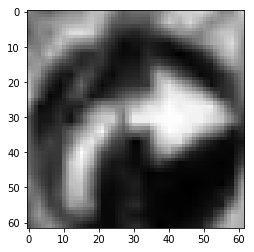

Activation for 4 kernel in 0 layer.


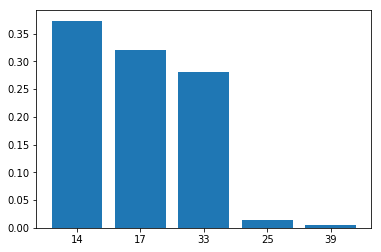

Probabilities of top 5 classes.
Actual class it belongs to: 33
Predicted class 14
Actual training image


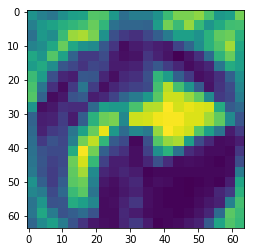

The kernel which activates/recognizes the shape: 11


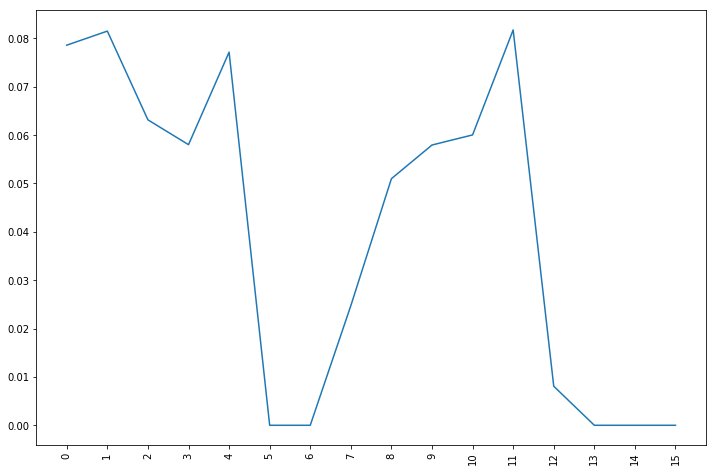

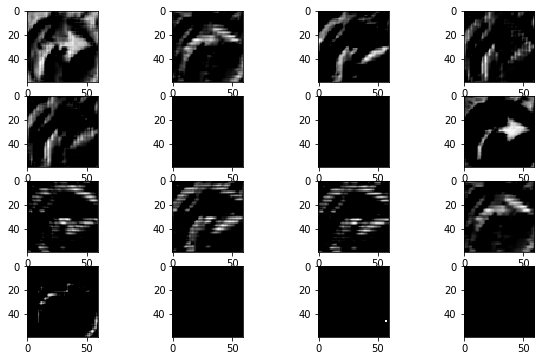

Multiple kernel activations starting from 0


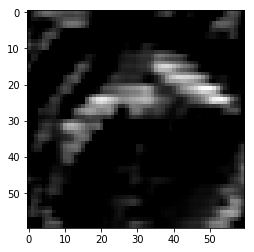

Activation for 11 kernel in 1 layer.


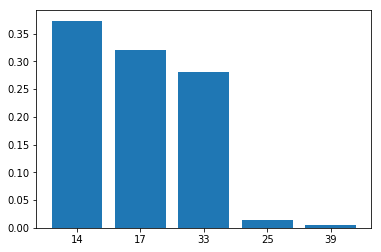

Probabilities of top 5 classes.


In [0]:
idx = 9942
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 2, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 4, 4, 1, y_true, y_prediction)

Actual class it belongs to: 5
Predicted class 2
Actual training image


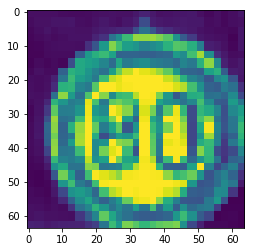

The kernel which activates/recognizes the shape: 4


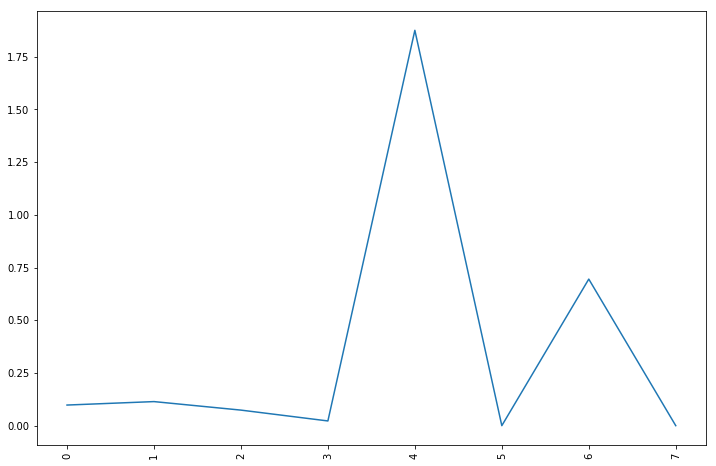

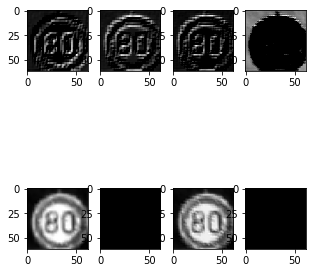

Multiple kernel activations starting from 0


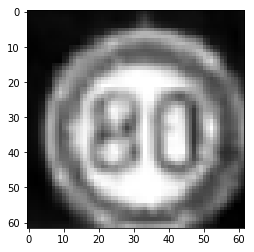

Activation for 4 kernel in 0 layer.


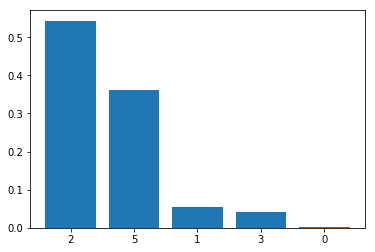

Probabilities of top 5 classes.
Actual class it belongs to: 5
Predicted class 2
Actual training image


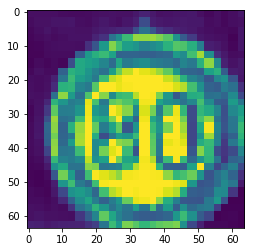

The kernel which activates/recognizes the shape: 11


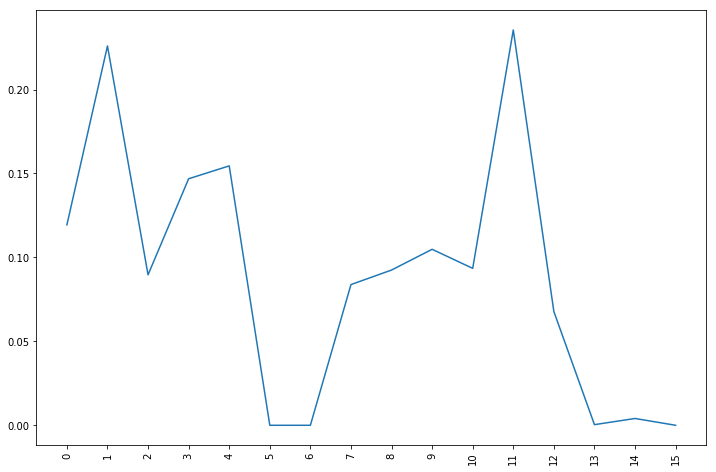

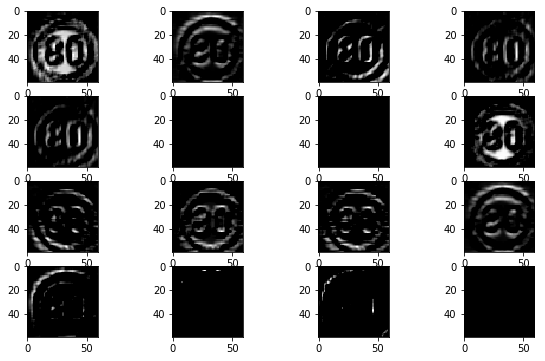

Multiple kernel activations starting from 0


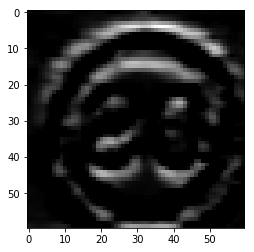

Activation for 11 kernel in 1 layer.


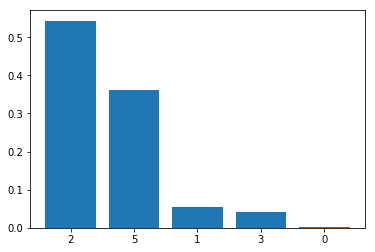

Probabilities of top 5 classes.


In [0]:
idx = 11722
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 2, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 4, 4, 1, y_true, y_prediction)

Actual class it belongs to: 31
Predicted class 26
Actual training image


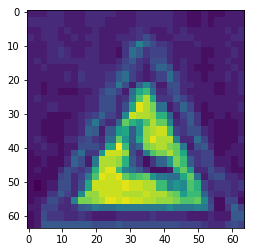

The kernel which activates/recognizes the shape: 3


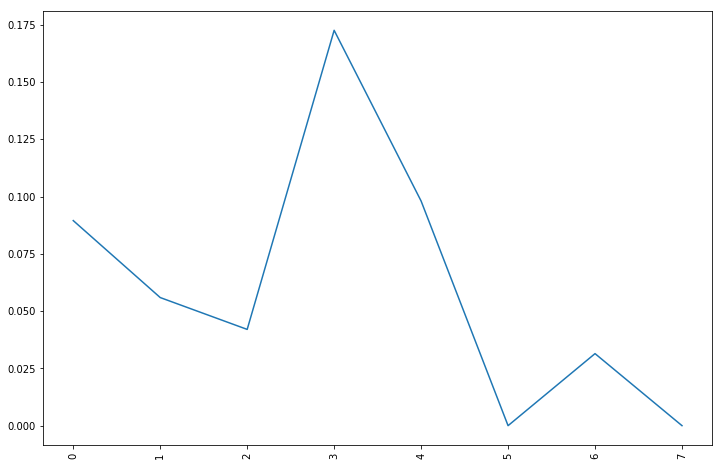

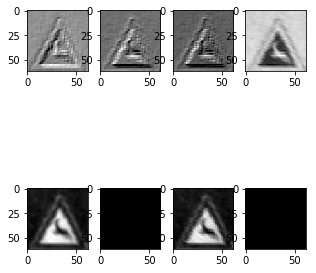

Multiple kernel activations starting from 0


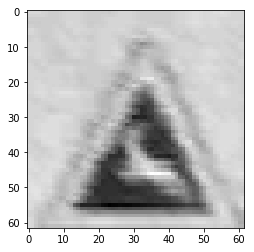

Activation for 3 kernel in 0 layer.


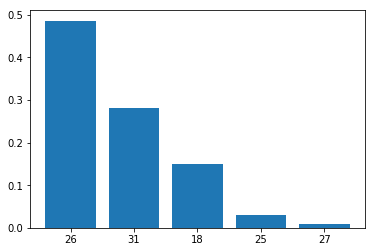

Probabilities of top 5 classes.
Actual class it belongs to: 31
Predicted class 26
Actual training image


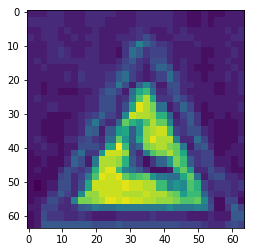

The kernel which activates/recognizes the shape: 13


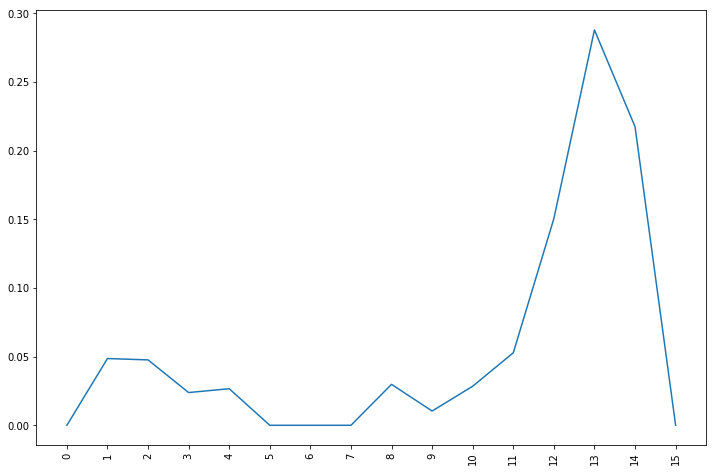

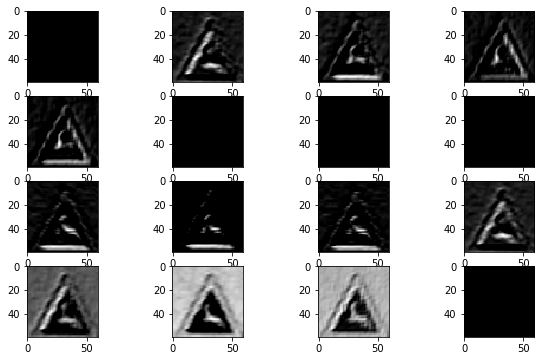

Multiple kernel activations starting from 0


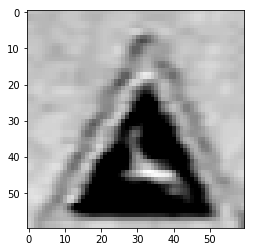

Activation for 13 kernel in 1 layer.


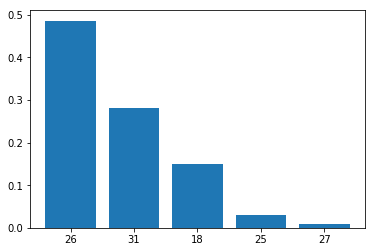

Probabilities of top 5 classes.


In [0]:
idx = 7861
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 2, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 4, 4, 1, y_true, y_prediction)

### [5.2] Conv(16 -- 3x3) - Conv(32 -- 3x3) - MaxPool(2x2) - Dropout(0.75) - Dense(128) - Dropout(0.5)

In [0]:
epochs = 15
model = Sequential()
model.add(Conv2D(
    16, kernel_size=(3, 3), activation='relu', input_shape=input_shape
))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(rate=0.75))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

W0627 05:54:49.848729 140709411673984 nn_ops.py:4224] Large dropout rate: 0.75 (>0.5). In TensorFlow 2.x, dropout() uses dropout rate instead of keep_prob. Please ensure that this is intended.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_5 (Conv2D)            (None, 62, 62, 16)        160       
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 60, 60, 32)        4640      
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 30, 30, 32)        0         
_________________________________________________________________
dropout_5 (Dropout)          (None, 30, 30, 32)        0         
_________________________________________________________________
flatten_3 (Flatten)          (None, 28800)             0         
_________________________________________________________________
dense_5 (Dense)              (None, 128)               3686528   
_________________________________________________________________
dropout_6 (Dropout)          (None, 128)               0         
__________

Test loss: 0.07920110077060165
Test accuracy: 0.9833375839851426


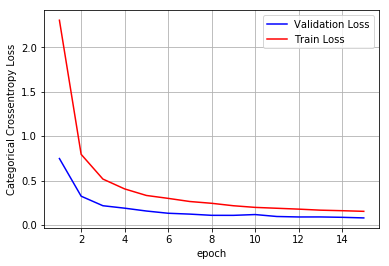

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9825943781471229
------------------------------------------------------


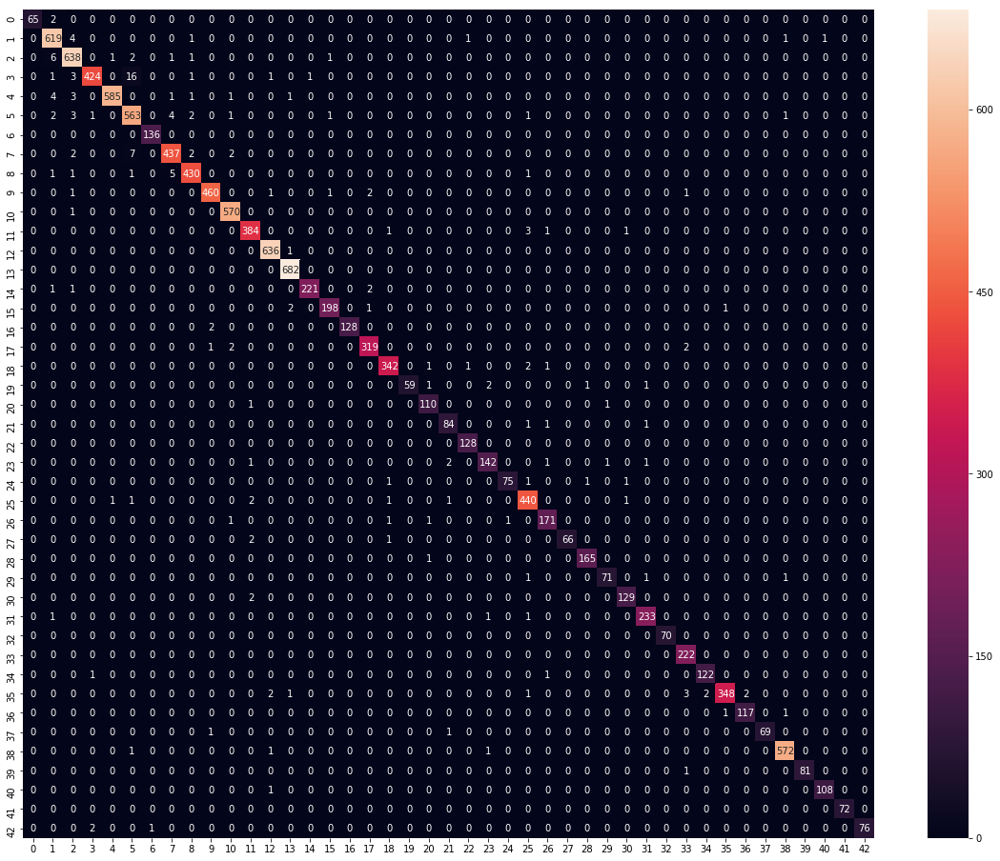

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 33
Predicted class 33
Actual training image


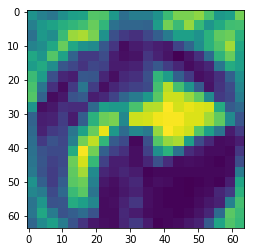

The kernel which activates/recognizes the shape: 1


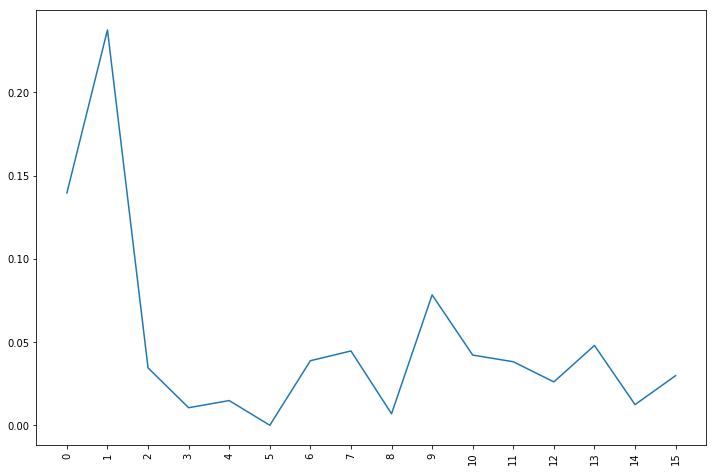

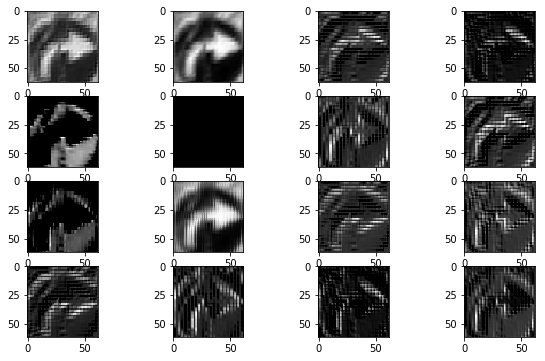

Multiple kernel activations starting from 0


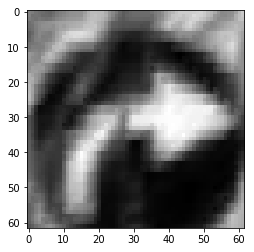

Activation for 1 kernel in 0 layer.


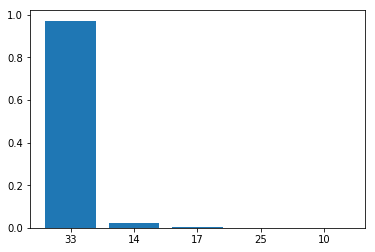

Probabilities of top 5 classes.
Actual class it belongs to: 33
Predicted class 33
Actual training image


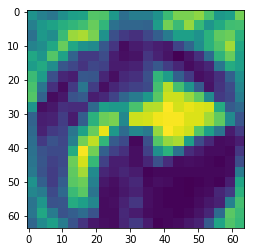

The kernel which activates/recognizes the shape: 13


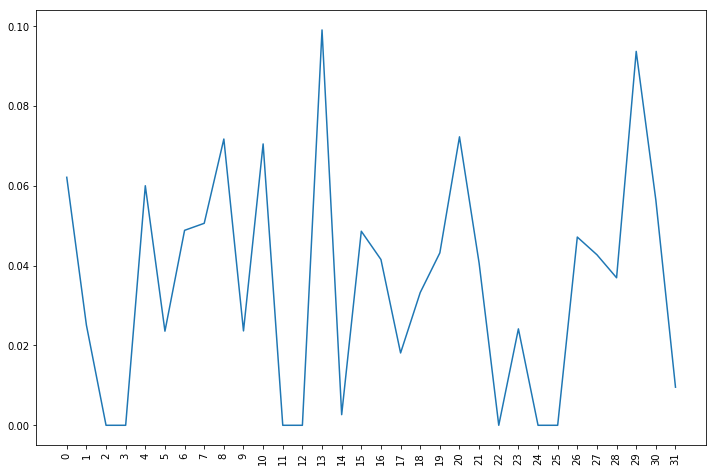

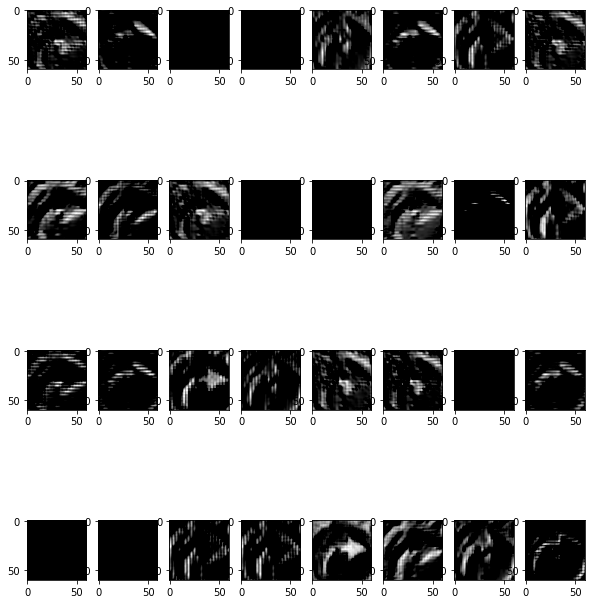

Multiple kernel activations starting from 0


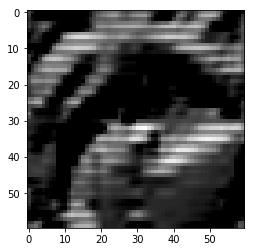

Activation for 13 kernel in 1 layer.


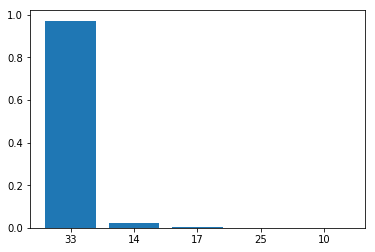

Probabilities of top 5 classes.


In [0]:
idx = 9942
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 1, y_true, y_prediction)

Actual class it belongs to: 5
Predicted class 5
Actual training image


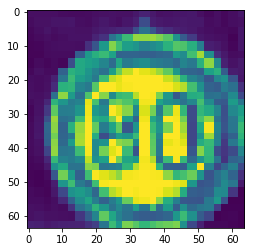

The kernel which activates/recognizes the shape: 1


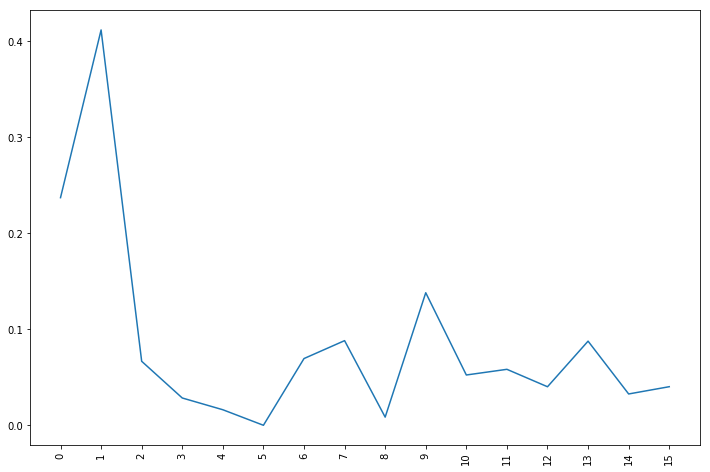

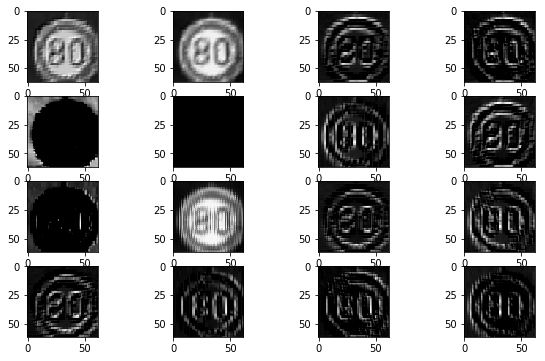

Multiple kernel activations starting from 0


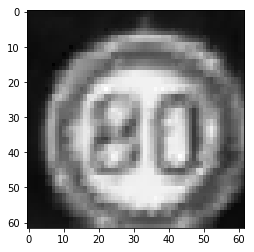

Activation for 1 kernel in 0 layer.


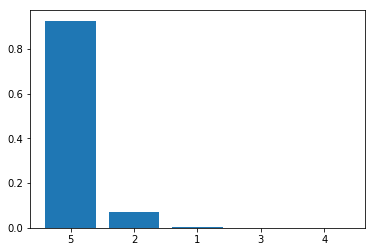

Probabilities of top 5 classes.
Actual class it belongs to: 5
Predicted class 5
Actual training image


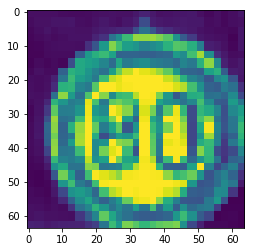

The kernel which activates/recognizes the shape: 29


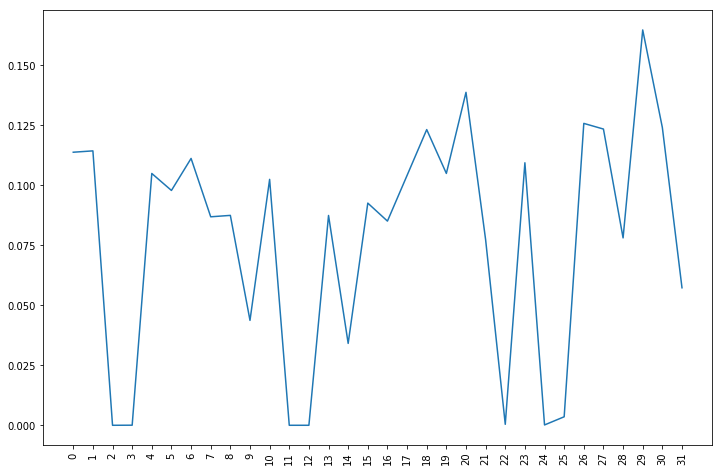

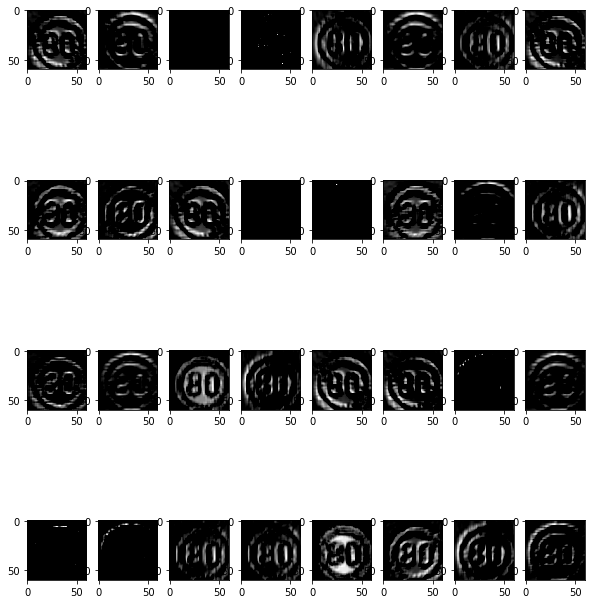

Multiple kernel activations starting from 0


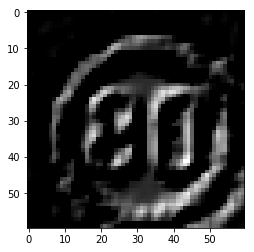

Activation for 29 kernel in 1 layer.


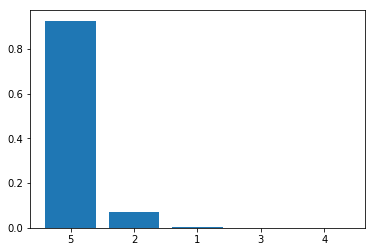

Probabilities of top 5 classes.


In [0]:
idx = 11722
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 1, y_true, y_prediction)

Actual class it belongs to: 31
Predicted class 31
Actual training image


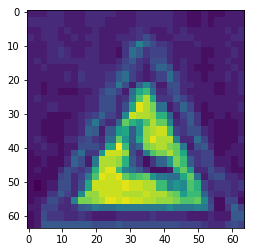

The kernel which activates/recognizes the shape: 4


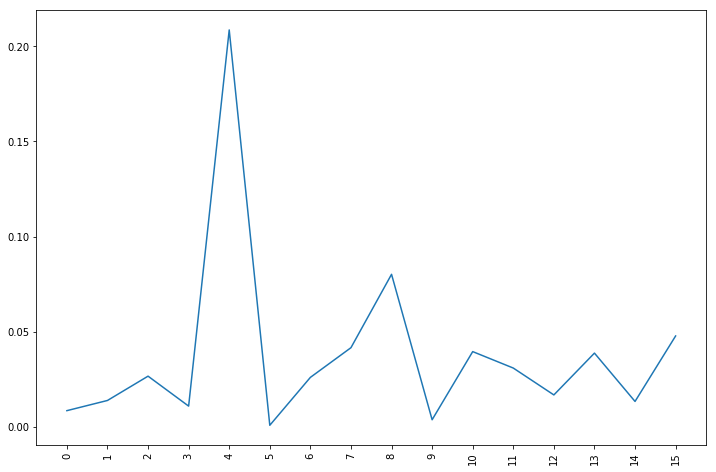

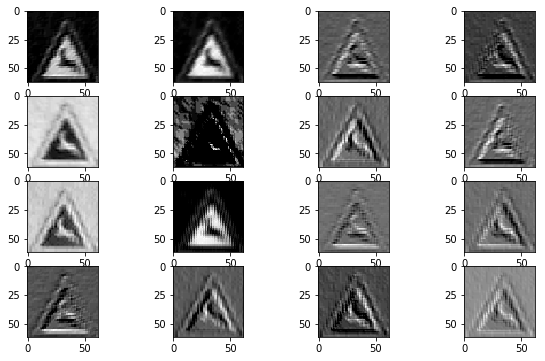

Multiple kernel activations starting from 0


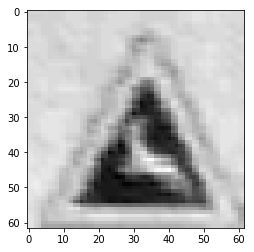

Activation for 4 kernel in 0 layer.


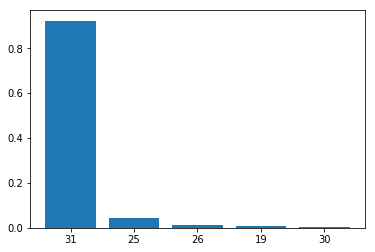

Probabilities of top 5 classes.
Actual class it belongs to: 31
Predicted class 31
Actual training image


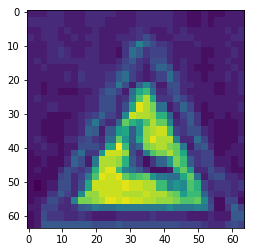

The kernel which activates/recognizes the shape: 2


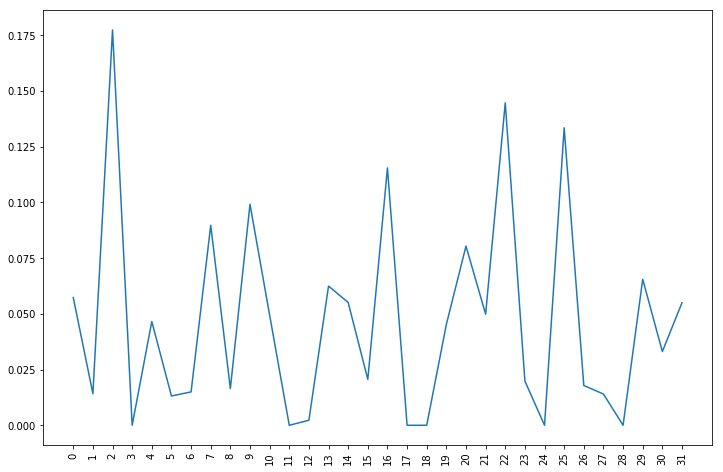

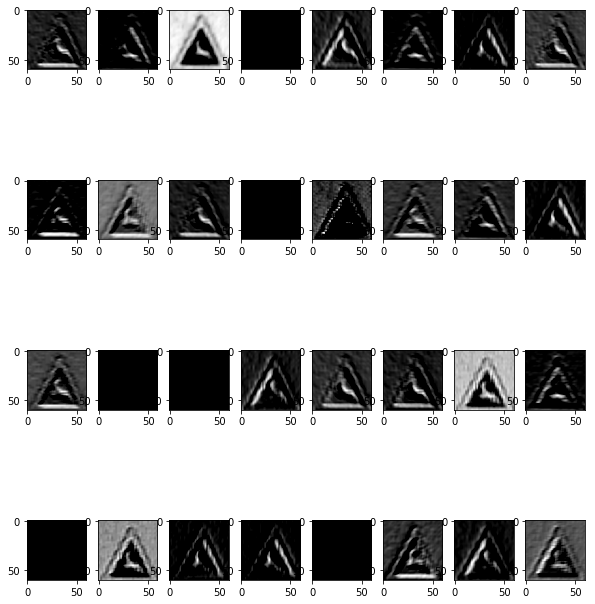

Multiple kernel activations starting from 0


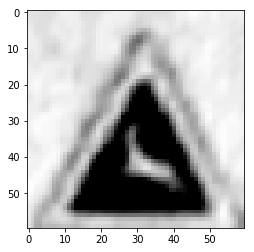

Activation for 2 kernel in 1 layer.


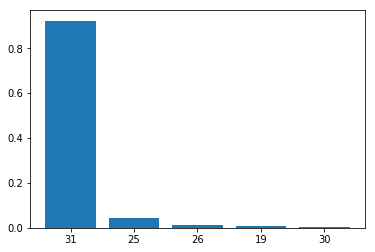

Probabilities of top 5 classes.


In [0]:
idx = 7861
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 1, y_true, y_prediction)

In [0]:
actual_class = []
index_image = []
predicted_class = []
for idx, im in enumerate(y_true):
    if im != np.argmax(y_prediction[idx]):
        actual_class.append(im)
        predicted_class.append(np.argmax(y_prediction[idx]))
        index_image.append(idx)
np.array(index_image)

array([   20,    41,   126,   157,   496,   522,   569,   579,   592,
         621,   696,   711,   836,   882,   981,  1009,  1053,  1148,
        1152,  1188,  1193,  1210,  1275,  1321,  1391,  1478,  1485,
        1578,  1609,  1689,  1750,  1774,  1840,  1880,  1915,  1926,
        1993,  1998,  2082,  2288,  2361,  2552,  2657,  2722,  2791,
        2873,  2925,  2978,  3050,  3055,  3080,  3113,  3226,  3290,
        3319,  3441,  3450,  3470,  3509,  3510,  3513,  3551,  3576,
        3592,  3629,  3665,  3669,  3846,  3853,  3962,  4028,  4083,
        4101,  4157,  4302,  4316,  4340,  4375,  4558,  4629,  4646,
        4781,  4921,  4926,  4953,  4975,  5032,  5082,  5089,  5223,
        5240,  5269,  5446,  5491,  5513,  5666,  5677,  5802,  5818,
        5855,  6018,  6028,  6037,  6102,  6112,  6128,  6157,  6166,
        6167,  6175,  6324,  6384,  6464,  6483,  6669,  6684,  6795,
        6806,  6857,  6930,  7072,  7086,  7269,  7271,  7358,  7378,
        7436,  7481,

Actual class it belongs to: 23
Predicted class 30
Actual training image


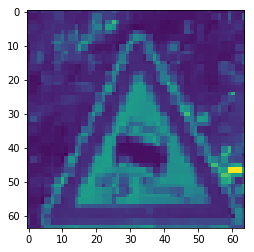

The kernel which activates/recognizes the shape: 1


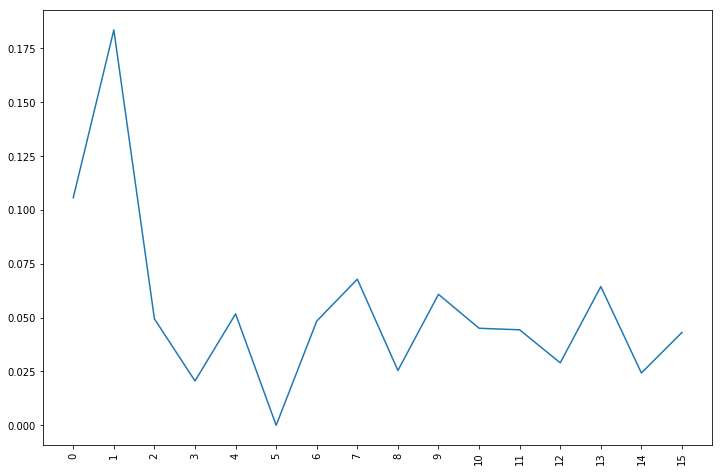

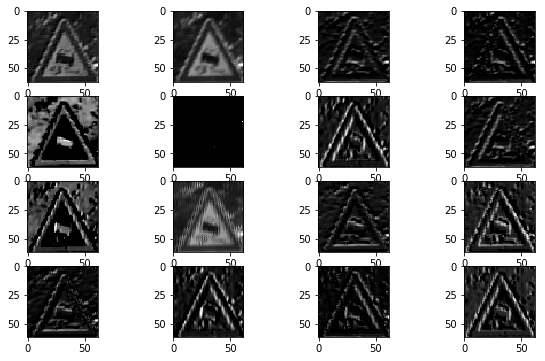

Multiple kernel activations starting from 0


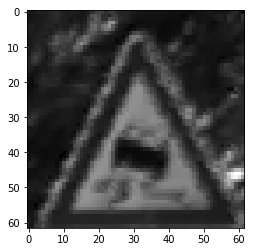

Activation for 1 kernel in 0 layer.


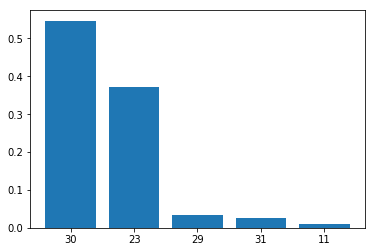

Probabilities of top 5 classes.
Actual class it belongs to: 23
Predicted class 30
Actual training image


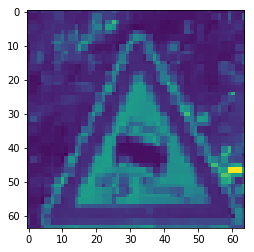

The kernel which activates/recognizes the shape: 30


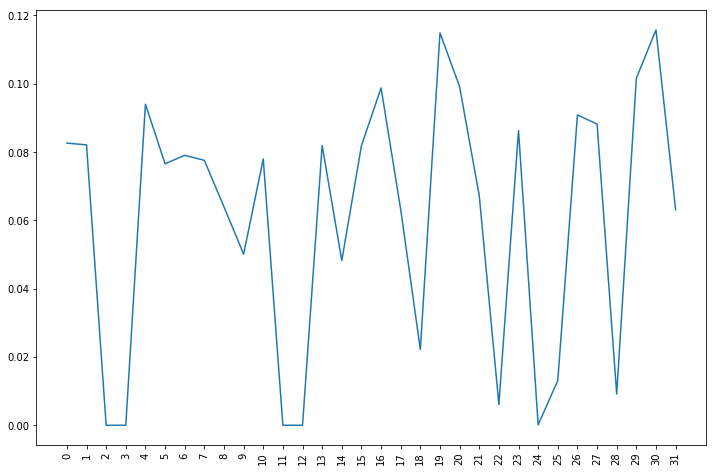

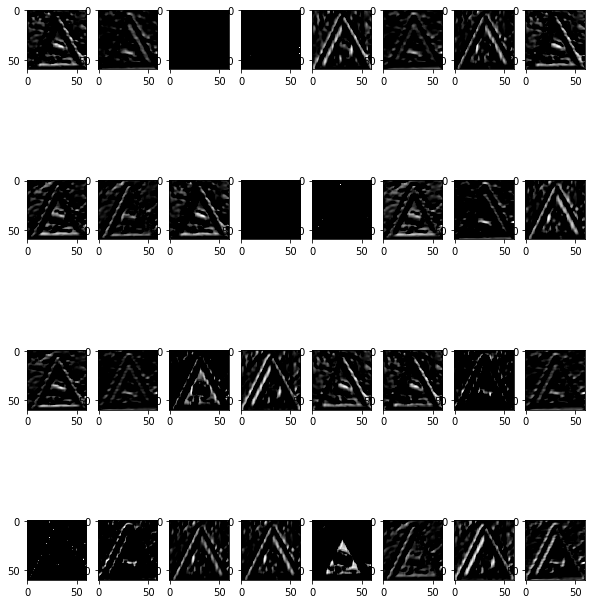

Multiple kernel activations starting from 0


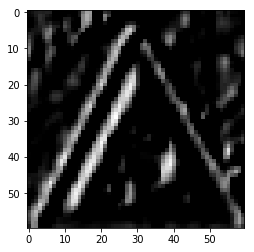

Activation for 30 kernel in 1 layer.


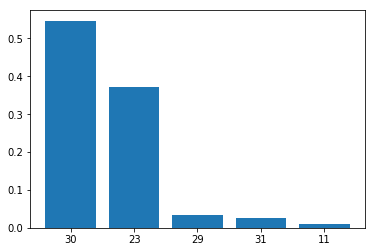

Probabilities of top 5 classes.


In [0]:
idx = 711
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 1, y_true, y_prediction)

Actual class it belongs to: 1
Predicted class 2
Actual training image


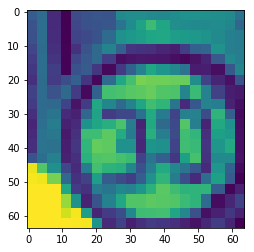

The kernel which activates/recognizes the shape: 1


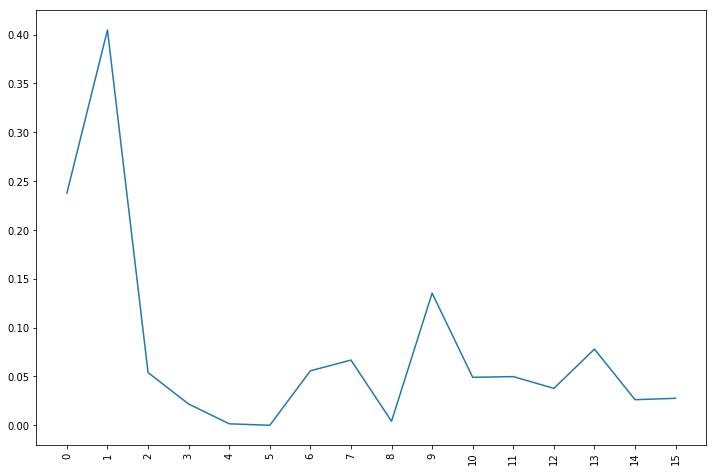

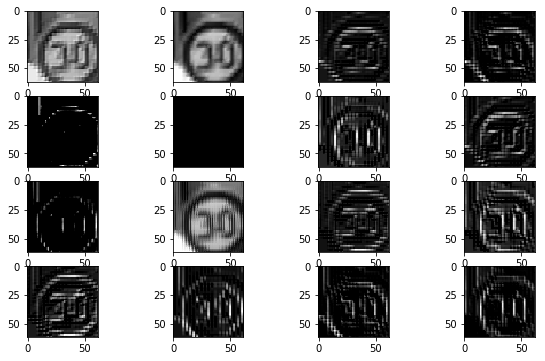

Multiple kernel activations starting from 0


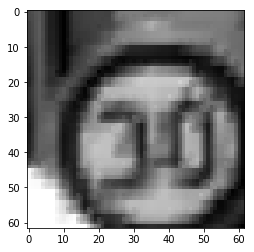

Activation for 1 kernel in 0 layer.


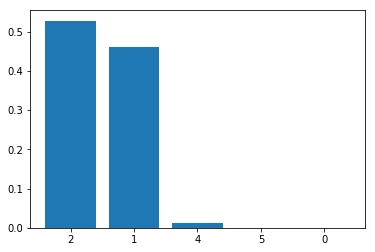

Probabilities of top 5 classes.
Actual class it belongs to: 1
Predicted class 2
Actual training image


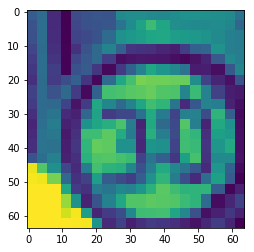

The kernel which activates/recognizes the shape: 29


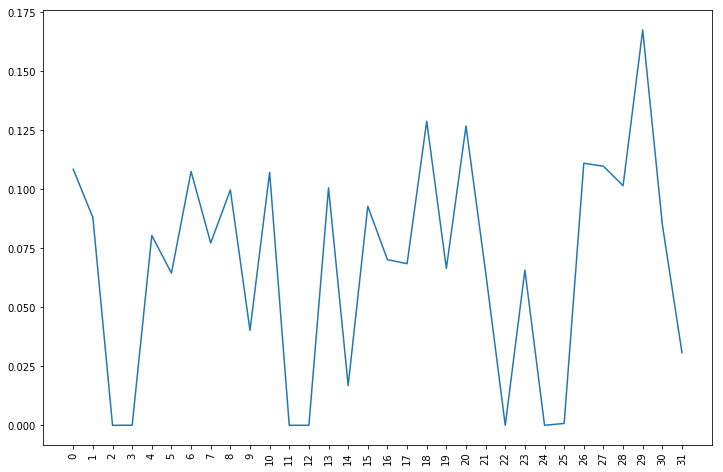

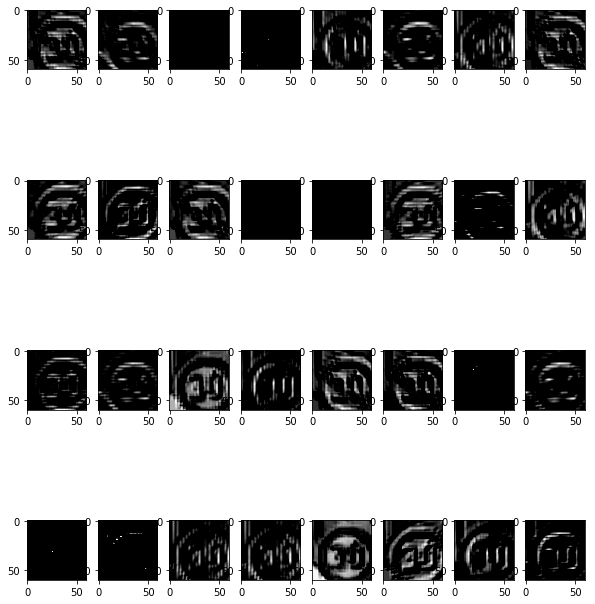

Multiple kernel activations starting from 0


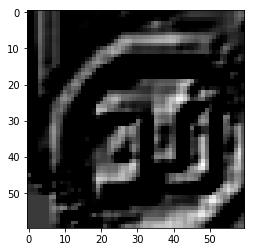

Activation for 29 kernel in 1 layer.


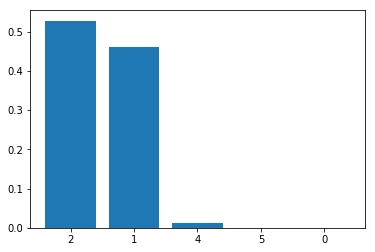

Probabilities of top 5 classes.


In [0]:
idx = 8627
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 4, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 1, y_true, y_prediction)

### [5.3] Conv(32 -- 4x4) - Conv(64 -- 3x3) - MaxPool(2x2) - Dropout(0.75) - Dense(128) - Dropout(0.5)

In [0]:
epochs = 15
model = Sequential()
model.add(Conv2D(
    32, kernel_size=(4, 4), activation='relu', input_shape=input_shape
))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(rate=0.75))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

W0627 05:56:16.388385 140709411673984 nn_ops.py:4224] Large dropout rate: 0.75 (>0.5). In TensorFlow 2.x, dropout() uses dropout rate instead of keep_prob. Please ensure that this is intended.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_7 (Conv2D)            (None, 61, 61, 32)        544       
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 59, 59, 64)        18496     
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 29, 29, 64)        0         
_________________________________________________________________
dropout_7 (Dropout)          (None, 29, 29, 64)        0         
_________________________________________________________________
flatten_4 (Flatten)          (None, 53824)             0         
_________________________________________________________________
dense_7 (Dense)              (None, 128)               6889600   
_________________________________________________________________
dropout_8 (Dropout)          (None, 128)               0         
__________

Test loss: 0.0629336034949474
Test accuracy: 0.9858879537532942


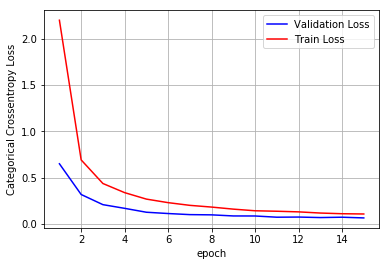

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9849328128373525
------------------------------------------------------


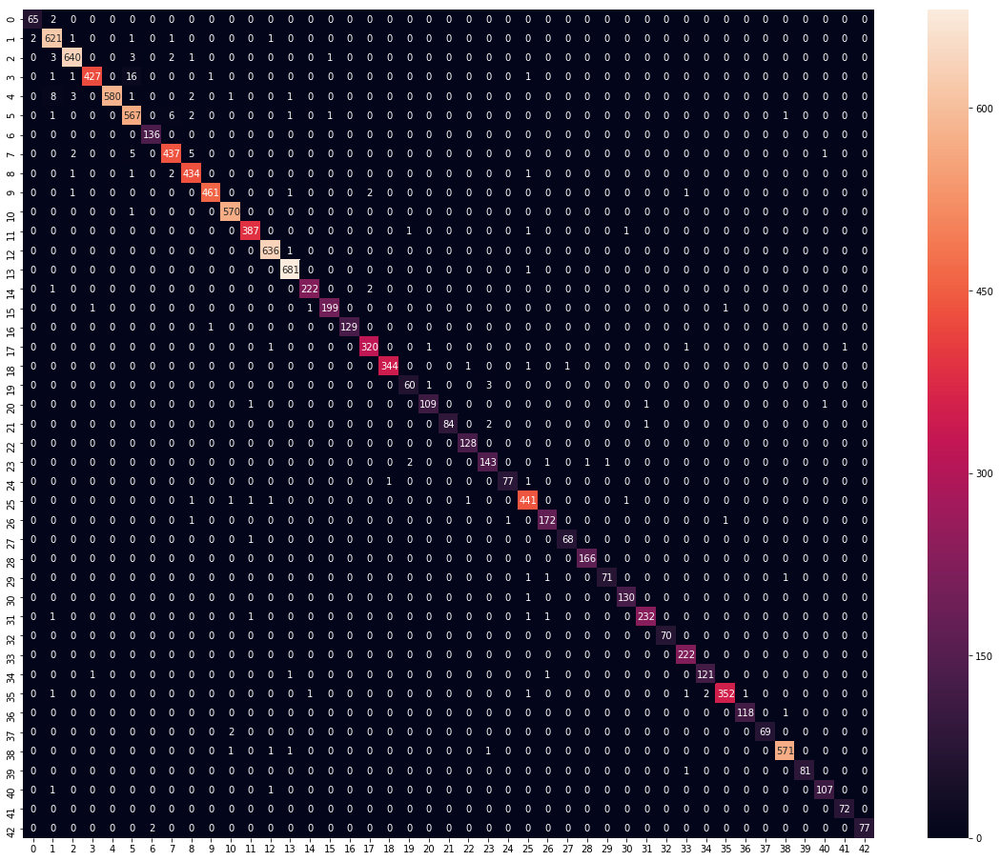

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 23
Predicted class 23
Actual training image


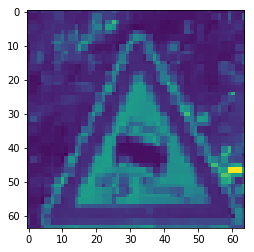

The kernel which activates/recognizes the shape: 2


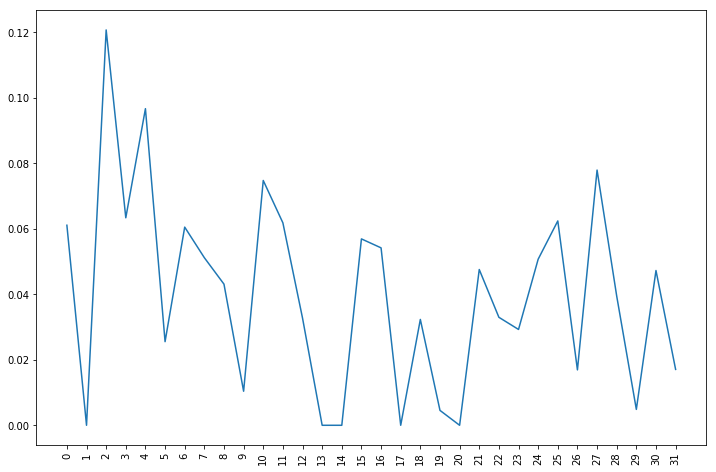

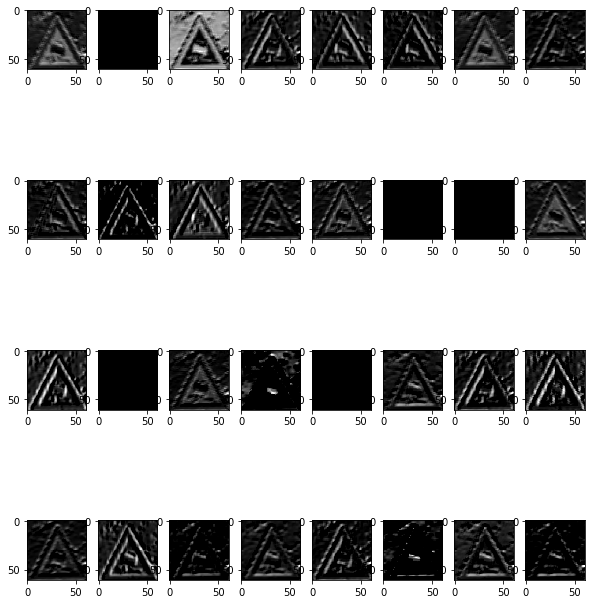

Multiple kernel activations starting from 0


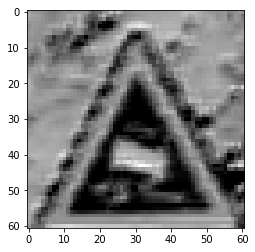

Activation for 2 kernel in 0 layer.


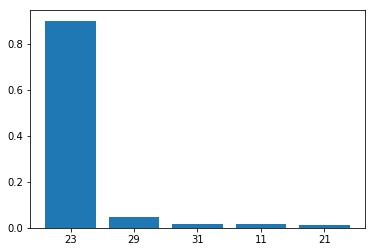

Probabilities of top 5 classes.
Actual class it belongs to: 23
Predicted class 23
Actual training image


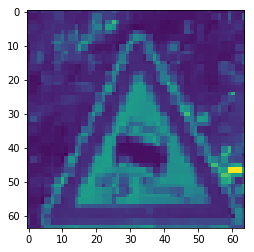

The kernel which activates/recognizes the shape: 55


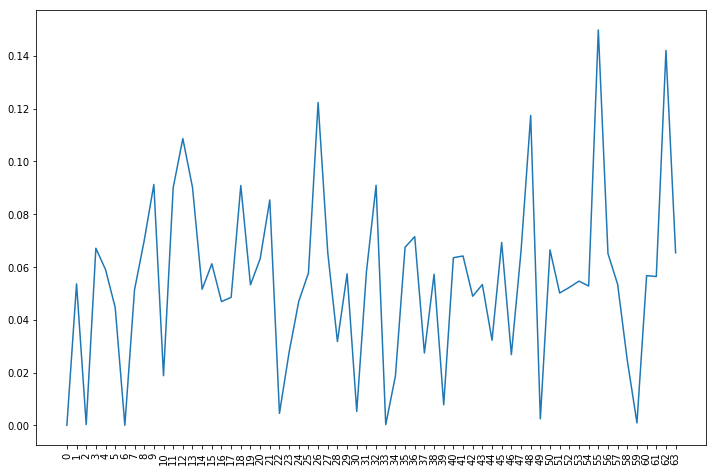

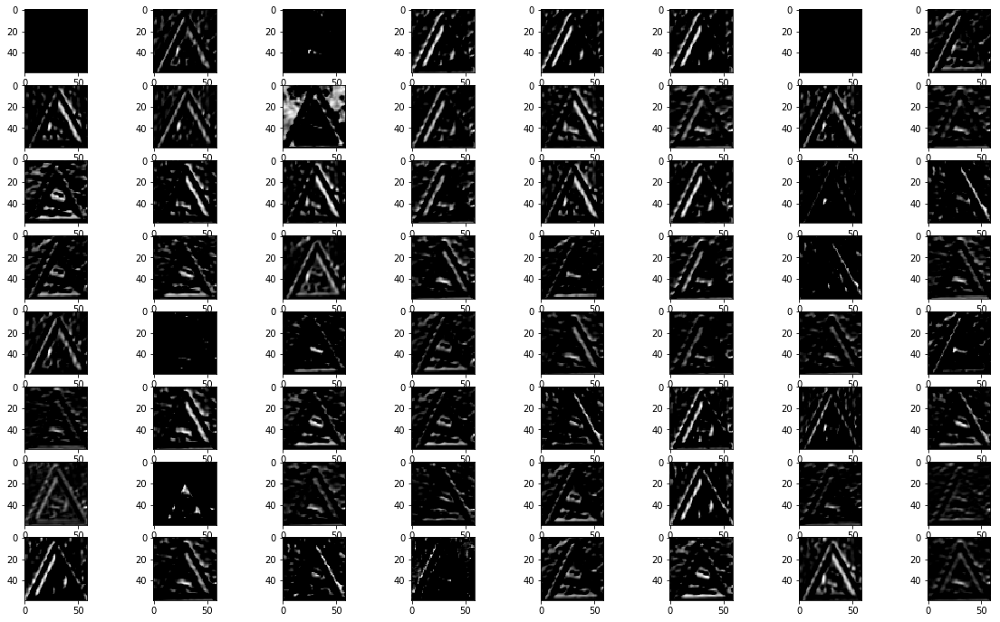

Multiple kernel activations starting from 0


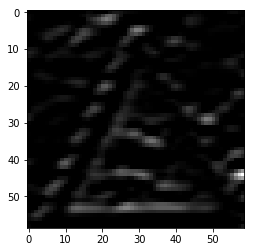

Activation for 55 kernel in 1 layer.


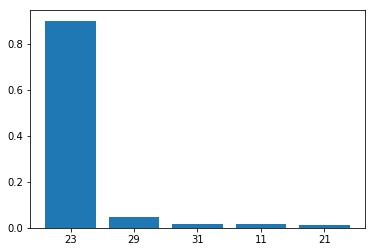

Probabilities of top 5 classes.


In [0]:
idx = 711
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)

Actual class it belongs to: 1
Predicted class 1
Actual training image


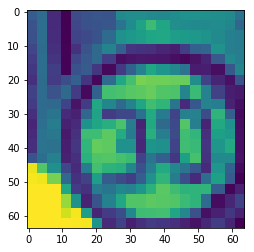

The kernel which activates/recognizes the shape: 6


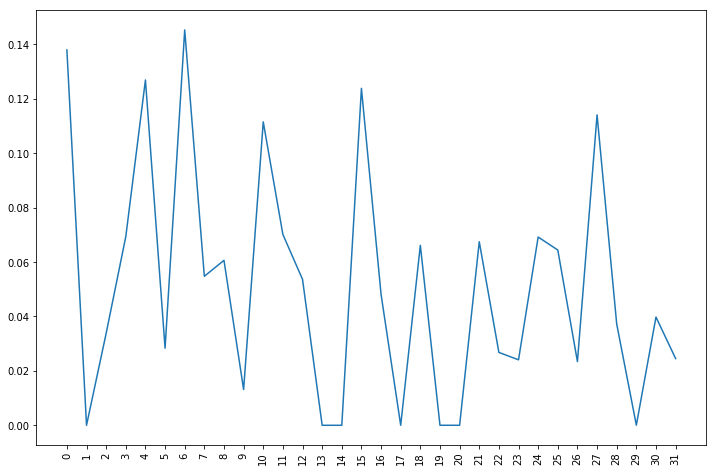

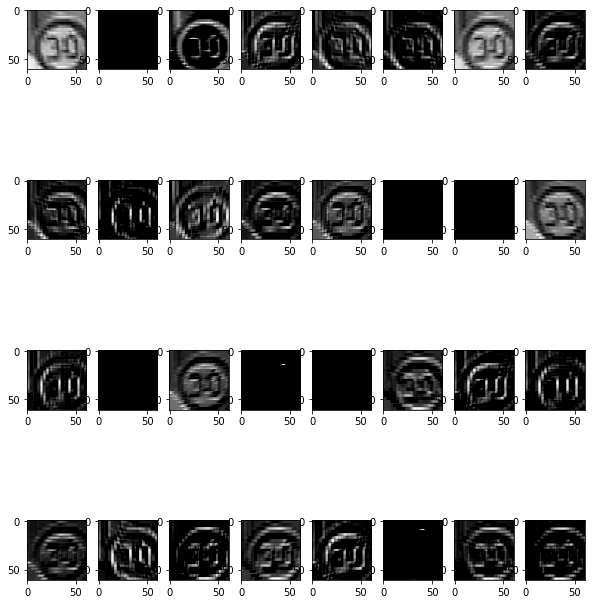

Multiple kernel activations starting from 0


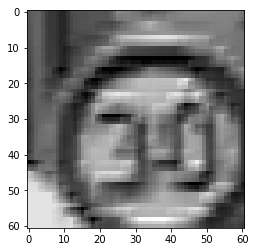

Activation for 6 kernel in 0 layer.


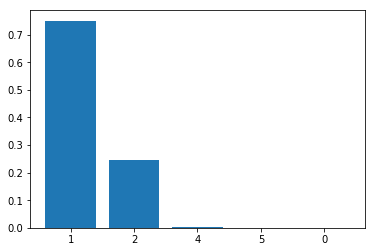

Probabilities of top 5 classes.
Actual class it belongs to: 1
Predicted class 1
Actual training image


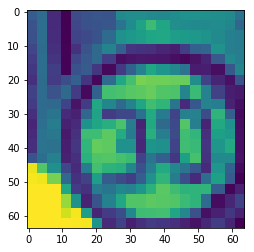

The kernel which activates/recognizes the shape: 62


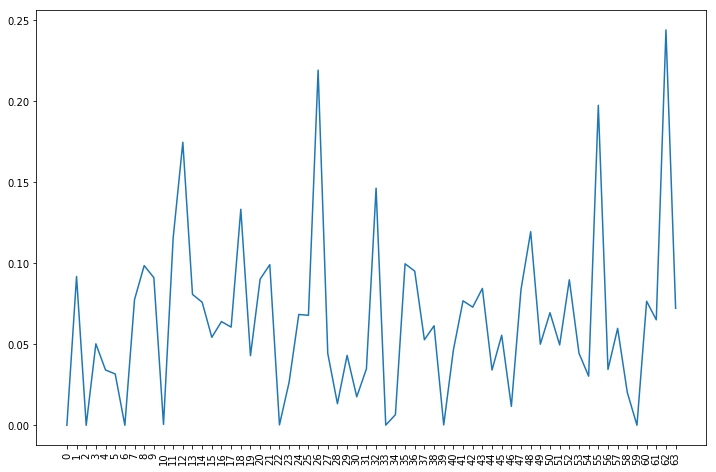

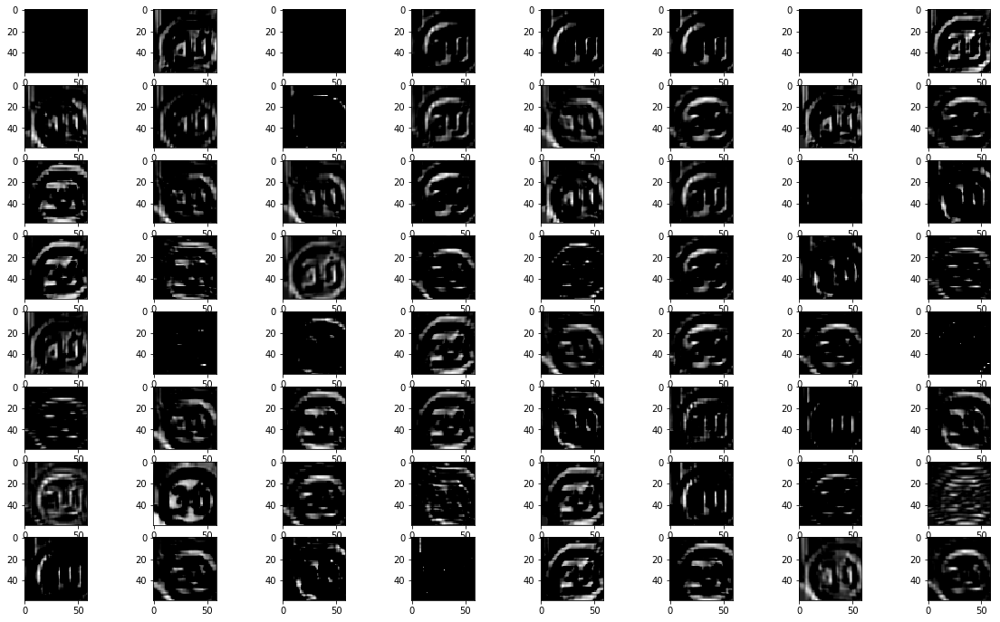

Multiple kernel activations starting from 0


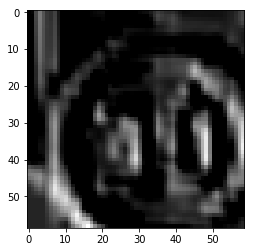

Activation for 62 kernel in 1 layer.


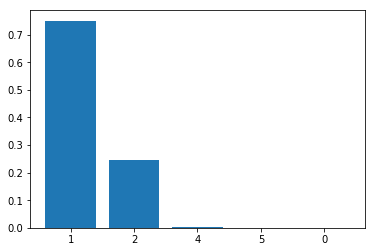

Probabilities of top 5 classes.


In [0]:
idx = 8627
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)

In [0]:
actual_class = []
index_image = []
predicted_class = []
for idx, im in enumerate(y_true):
    if im != np.argmax(y_prediction[idx]):
        actual_class.append(im)
        predicted_class.append(np.argmax(y_prediction[idx]))
        index_image.append(idx)
np.array(index_image)

array([   20,    37,    41,   151,   157,   163,   569,   592,   621,
         684,   696,   803,   836,   981,  1097,  1188,  1193,  1210,
        1321,  1391,  1404,  1478,  1609,  1737,  1748,  1750,  1840,
        1880,  1915,  1926,  1993,  1998,  2325,  2361,  2365,  2722,
        2791,  2873,  2967,  2978,  3055,  3080,  3113,  3450,  3489,
        3509,  3510,  3513,  3559,  3576,  3592,  3629,  3665,  3669,
        3785,  3846,  3853,  3953,  4083,  4101,  4123,  4302,  4316,
        4375,  4558,  4921,  4926,  5082,  5089,  5240,  5446,  5470,
        5491,  5513,  5802,  5855,  6017,  6102,  6157,  6166,  6170,
        6175,  6384,  6669,  6795,  6806,  6867,  6930,  6985,  6995,
        7269,  7295,  7358,  7377,  7378,  7481,  7496,  7520,  7521,
        7570,  7626,  7700,  7745,  7796,  7871,  7968,  8047,  8200,
        8207,  8235,  8346,  8348,  8412,  8492,  8510,  8578,  8598,
        8632,  8677,  8723,  8735,  8739,  8876,  9477,  9584,  9749,
        9892, 10073,

Actual class it belongs to: 26
Predicted class 31
Actual training image


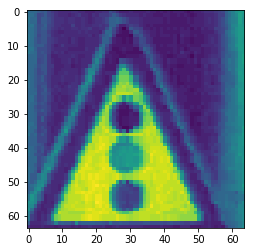

The kernel which activates/recognizes the shape: 2


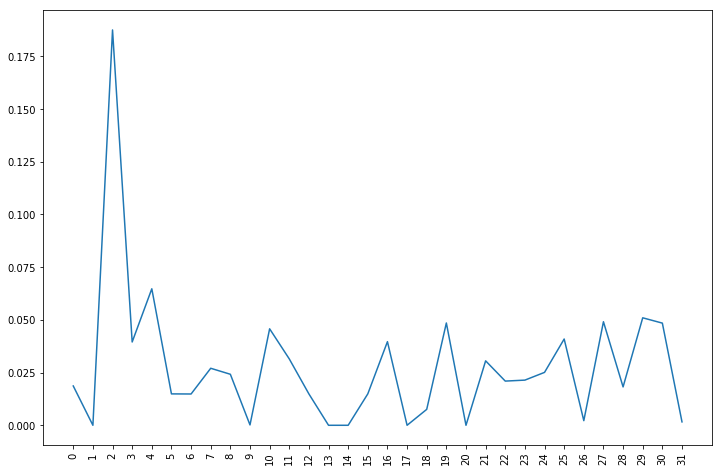

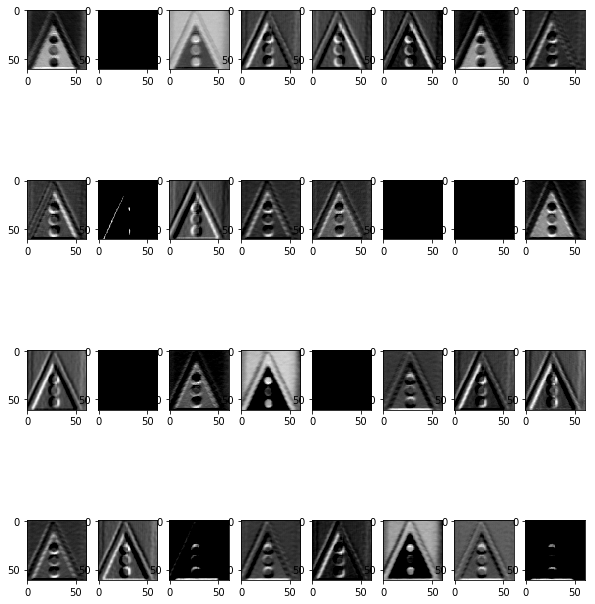

Multiple kernel activations starting from 0


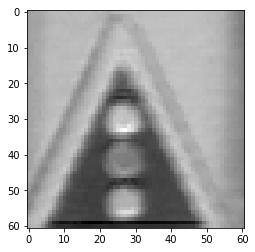

Activation for 2 kernel in 0 layer.


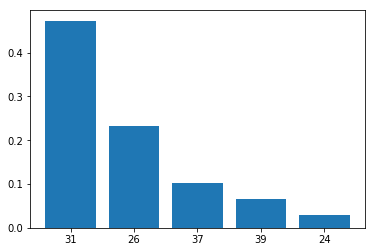

Probabilities of top 5 classes.
Actual class it belongs to: 26
Predicted class 31
Actual training image


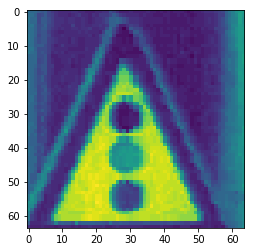

The kernel which activates/recognizes the shape: 46


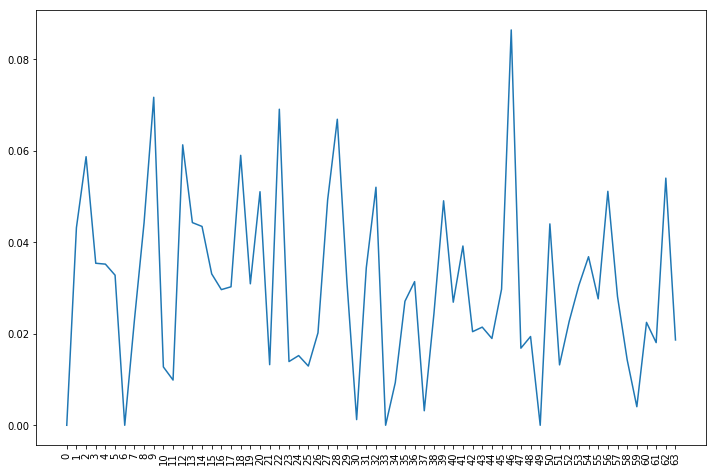

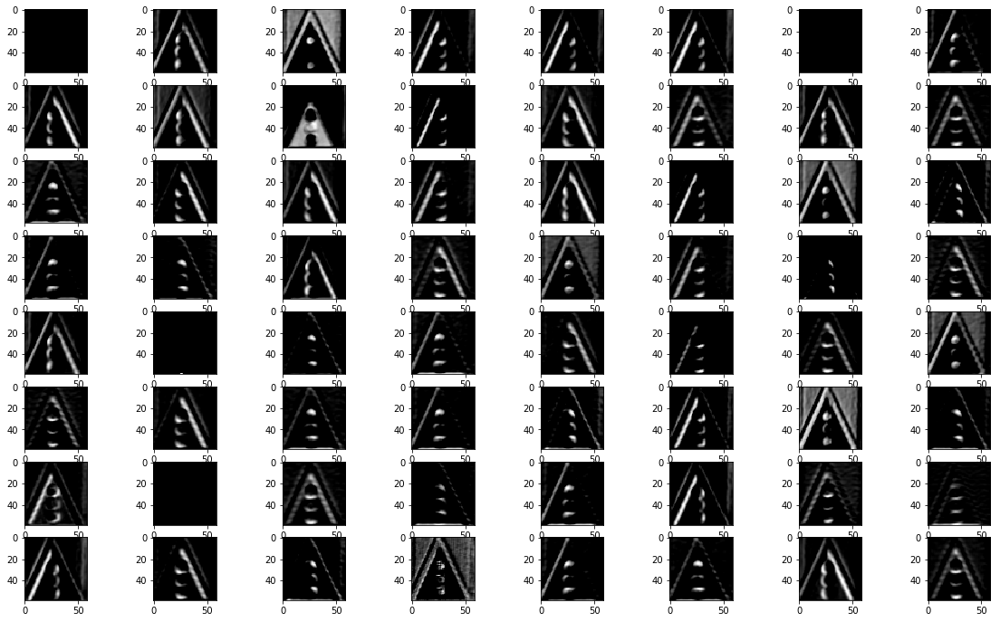

Multiple kernel activations starting from 0


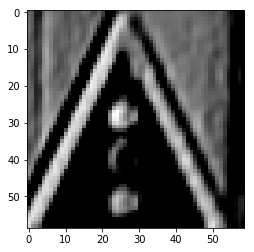

Activation for 46 kernel in 1 layer.


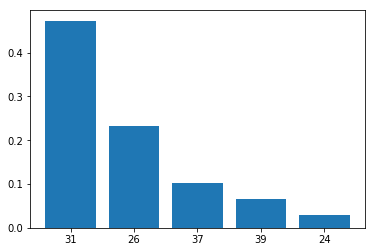

Probabilities of top 5 classes.


In [0]:
idx = 684
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)

Actual class it belongs to: 2
Predicted class 8
Actual training image


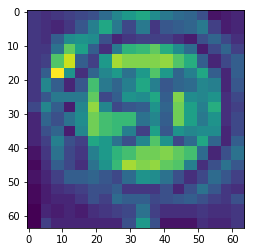

The kernel which activates/recognizes the shape: 2


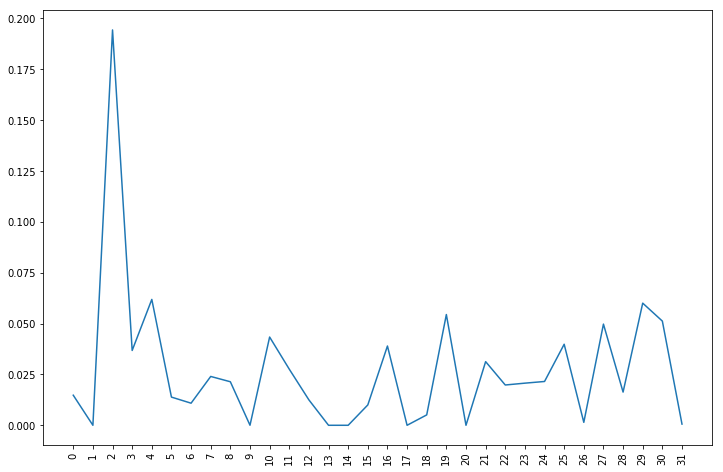

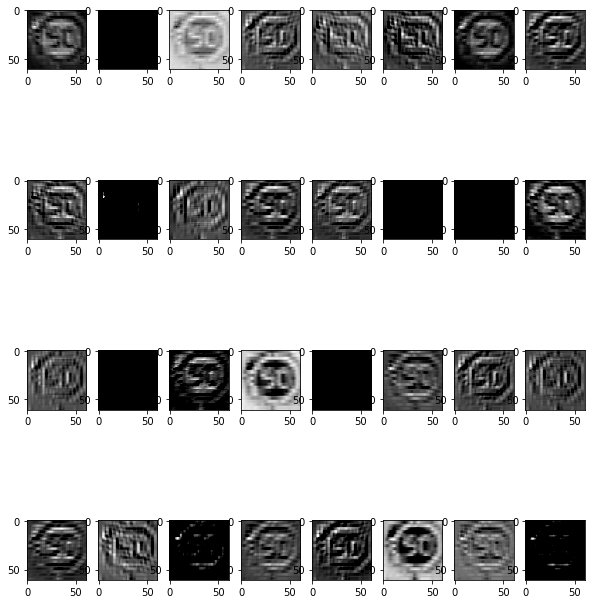

Multiple kernel activations starting from 0


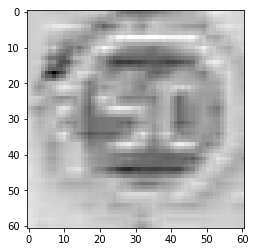

Activation for 2 kernel in 0 layer.


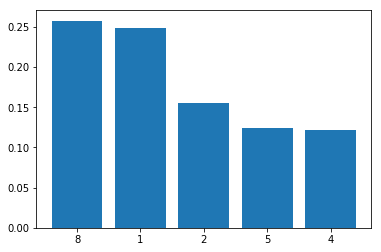

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 8
Actual training image


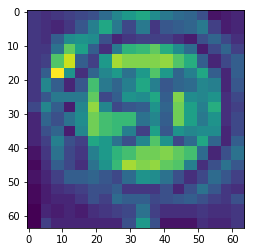

The kernel which activates/recognizes the shape: 28


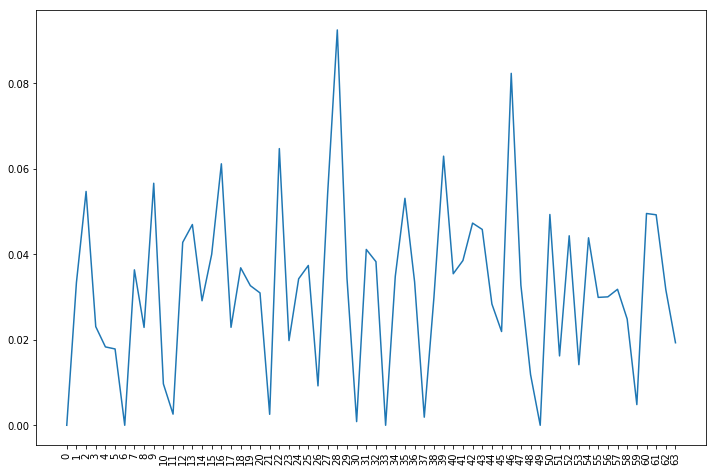

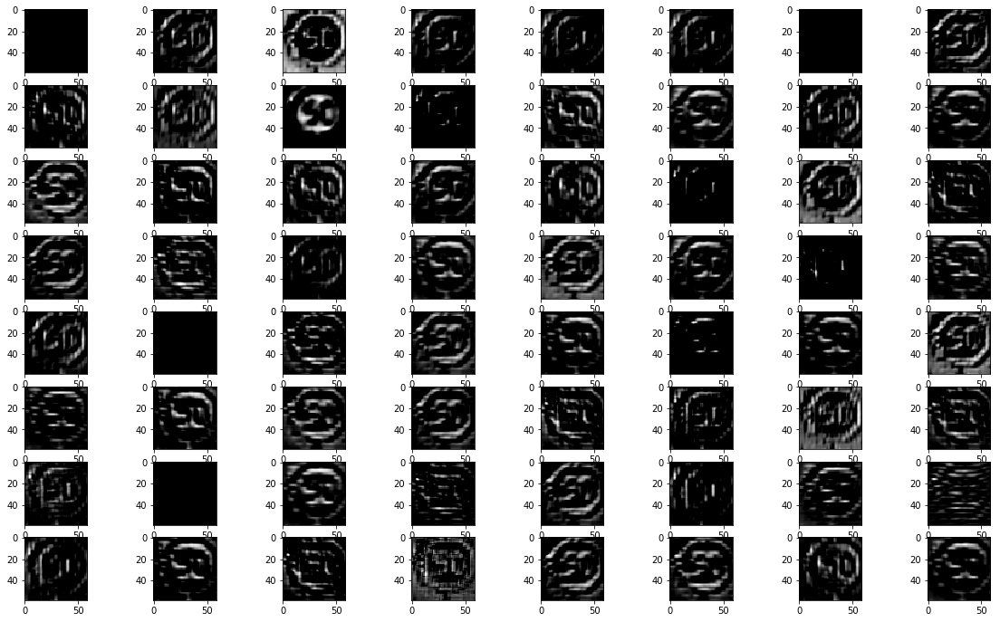

Multiple kernel activations starting from 0


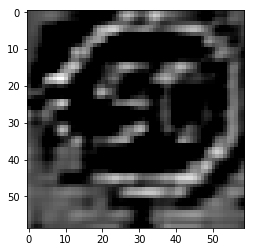

Activation for 28 kernel in 1 layer.


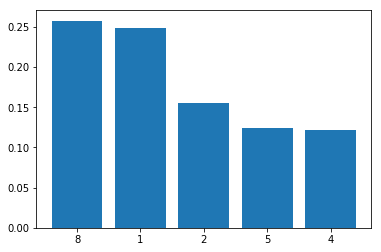

Probabilities of top 5 classes.


In [0]:
idx = 11078
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)

Actual class it belongs to: 2
Predicted class 1
Actual training image


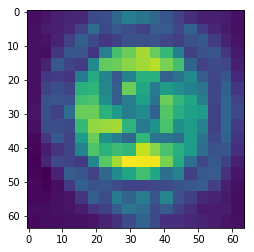

The kernel which activates/recognizes the shape: 2


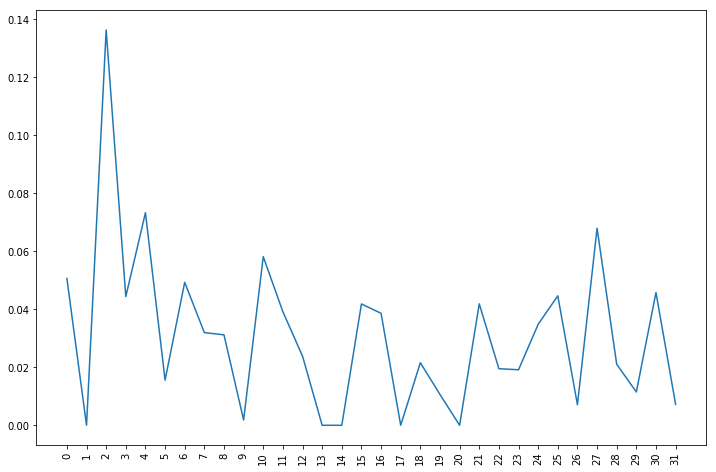

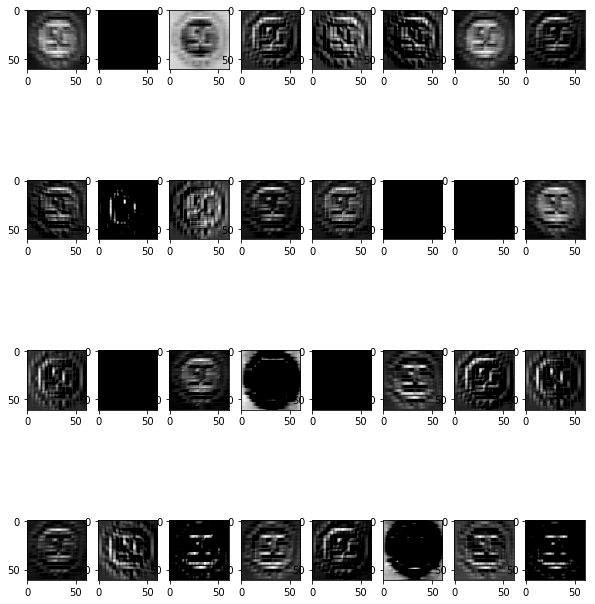

Multiple kernel activations starting from 0


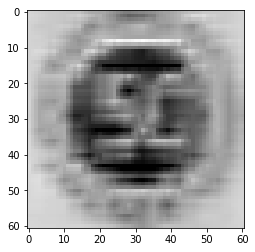

Activation for 2 kernel in 0 layer.


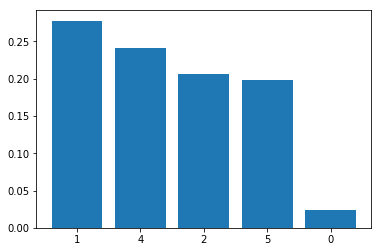

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 1
Actual training image


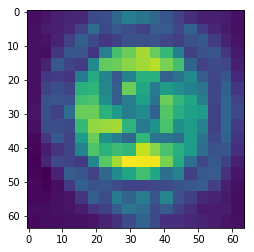

The kernel which activates/recognizes the shape: 62


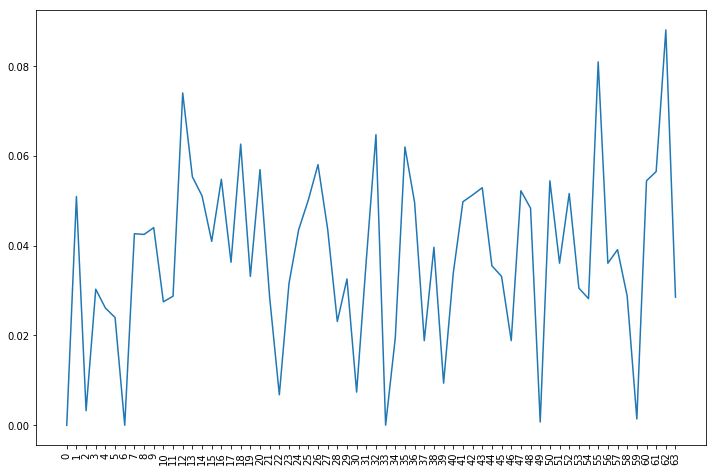

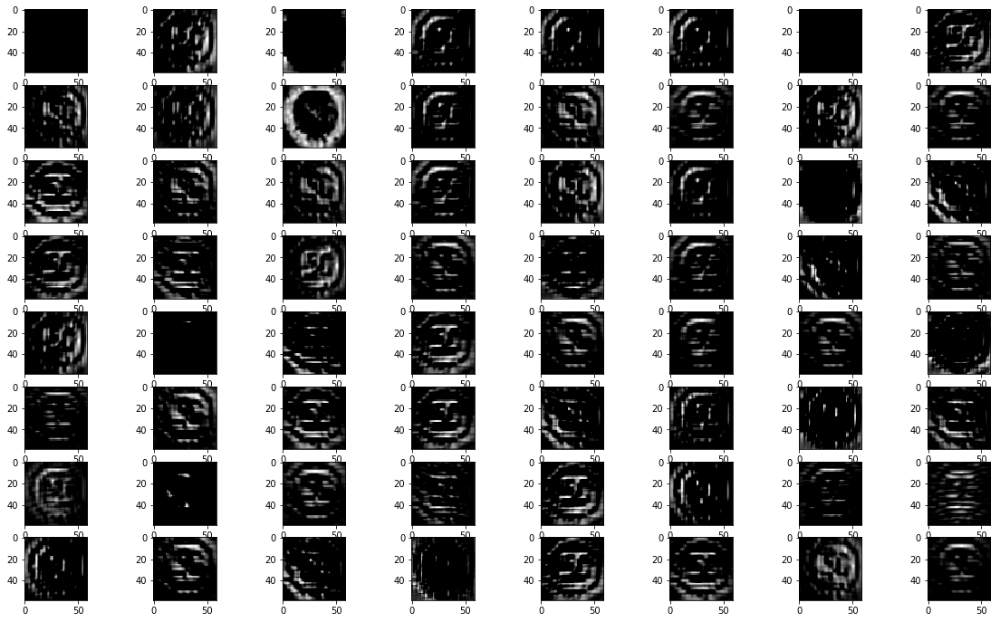

Multiple kernel activations starting from 0


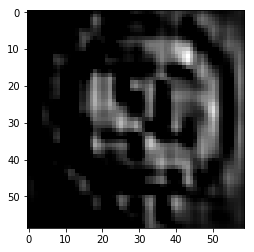

Activation for 62 kernel in 1 layer.


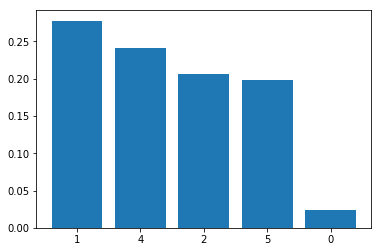

Probabilities of top 5 classes.


In [0]:
idx = 11527
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)

### [5.4] Conv(32 -- 4x4) - Conv(64 -- 3x3) -  MaxPool(2x2) - Conv(32 -- 4x4) - Dropout(0.75) - Dense(128) - Dropout(0.5)

In [0]:
epochs = 15
model = Sequential()
model.add(Conv2D(
    32, kernel_size=(4, 4), activation='relu', input_shape=input_shape
))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (4, 4), activation='relu'))
model.add(Dropout(rate=0.75))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

W0627 05:58:48.219085 140709411673984 nn_ops.py:4224] Large dropout rate: 0.75 (>0.5). In TensorFlow 2.x, dropout() uses dropout rate instead of keep_prob. Please ensure that this is intended.


_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_9 (Conv2D)            (None, 61, 61, 32)        544       
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 59, 59, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 29, 29, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 26, 26, 32)        32800     
_________________________________________________________________
dropout_9 (Dropout)          (None, 26, 26, 32)        0         
_________________________________________________________________
flatten_5 (Flatten)          (None, 21632)             0         
_________________________________________________________________
dense_9 (Dense)              (None, 128)               2769024   
__________

Test loss: 0.04195932970551171
Test accuracy: 0.9909886933605373


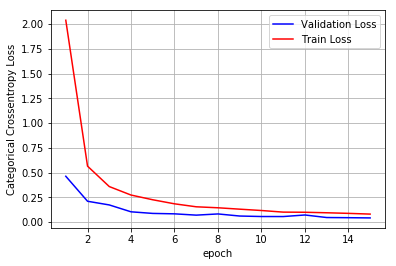

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.989949258229611
------------------------------------------------------


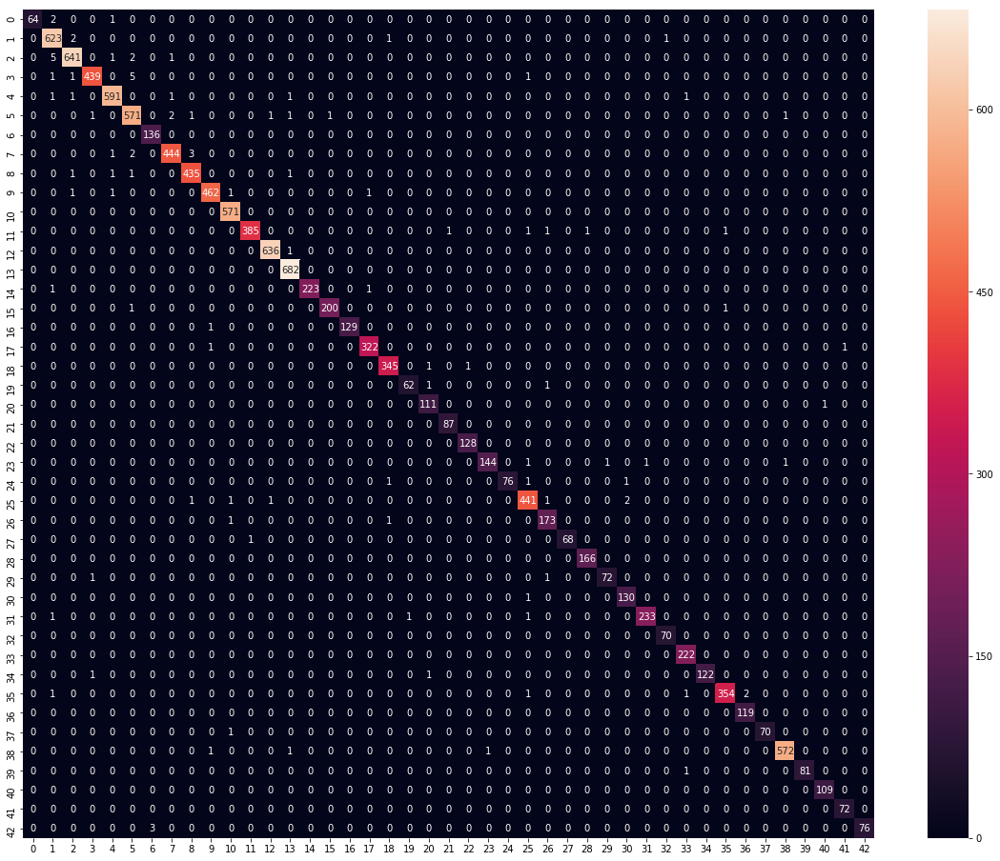

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 26
Predicted class 26
Actual training image


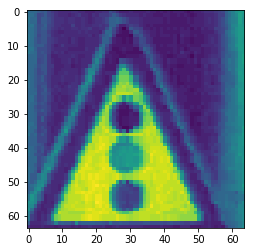

The kernel which activates/recognizes the shape: 4


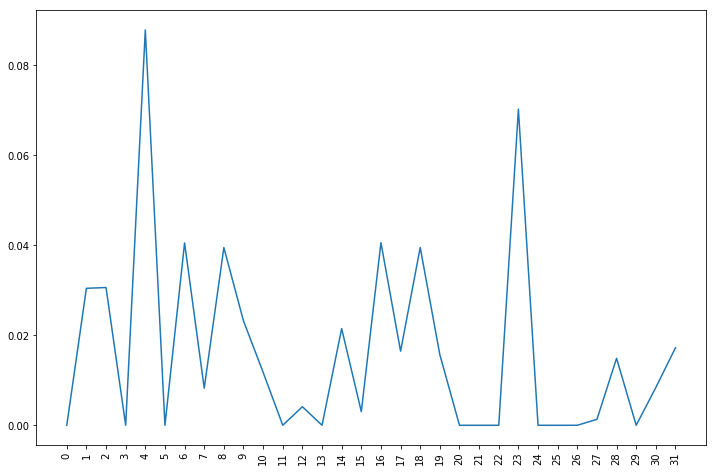

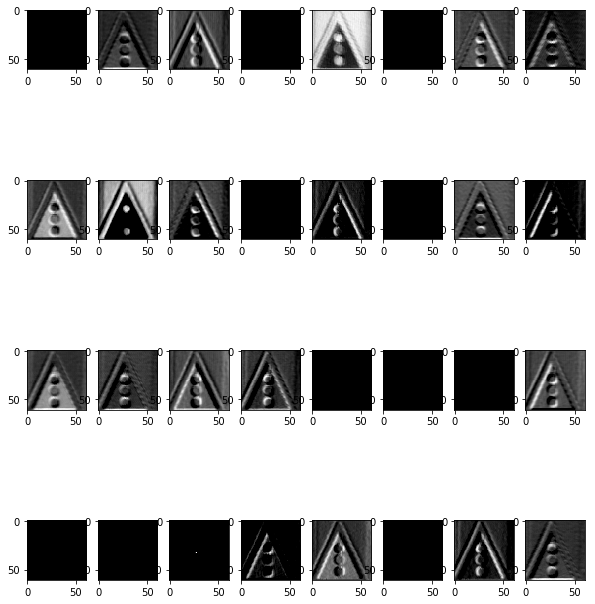

Multiple kernel activations starting from 0


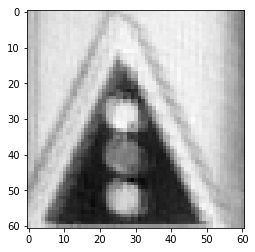

Activation for 4 kernel in 0 layer.


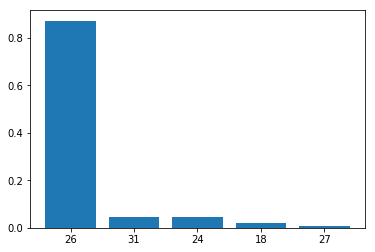

Probabilities of top 5 classes.
Actual class it belongs to: 26
Predicted class 26
Actual training image


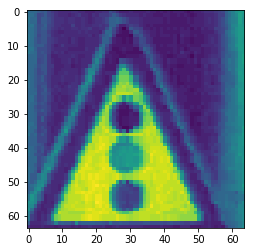

The kernel which activates/recognizes the shape: 46


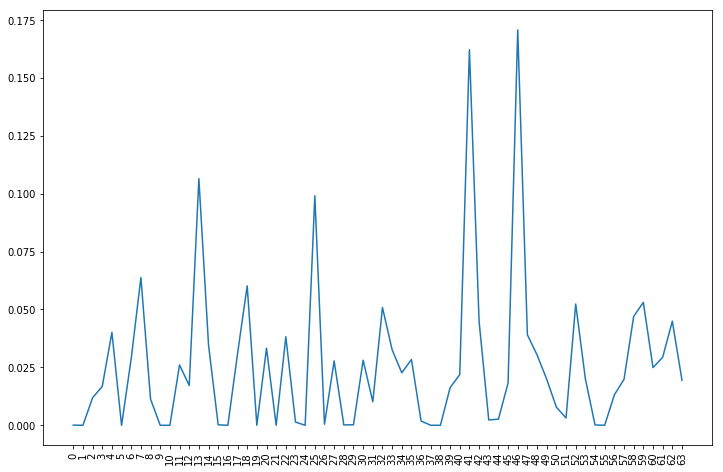

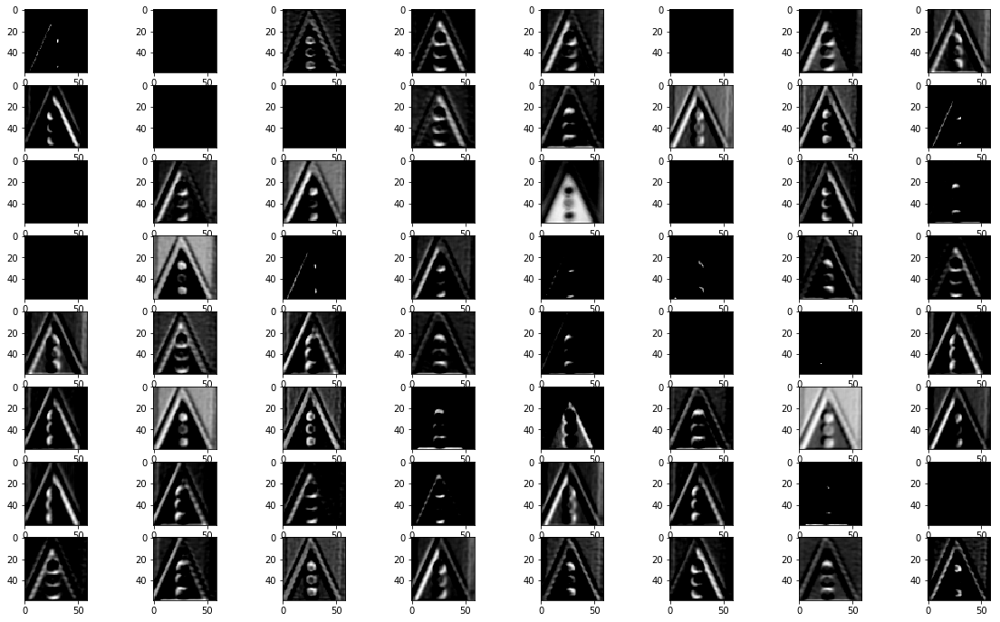

Multiple kernel activations starting from 0


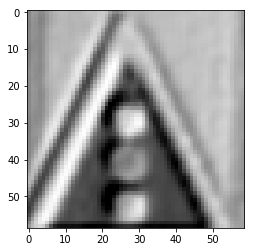

Activation for 46 kernel in 1 layer.


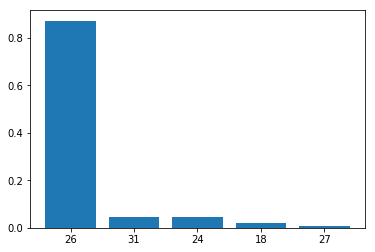

Probabilities of top 5 classes.
Actual class it belongs to: 26
Predicted class 26
Actual training image


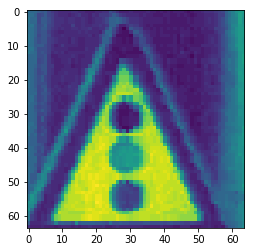

The kernel which activates/recognizes the shape: 41


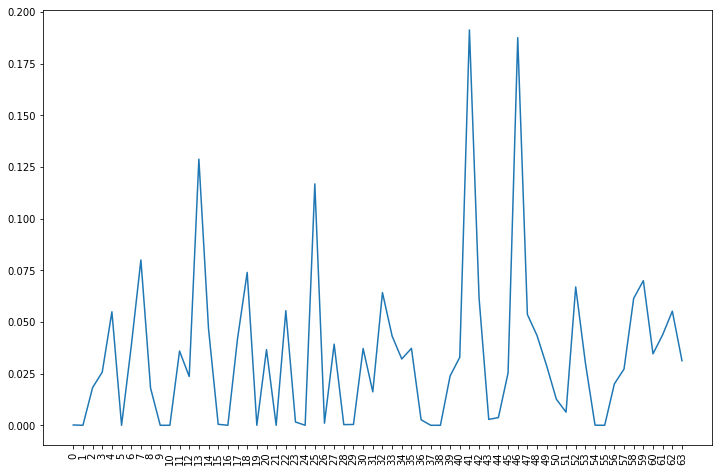

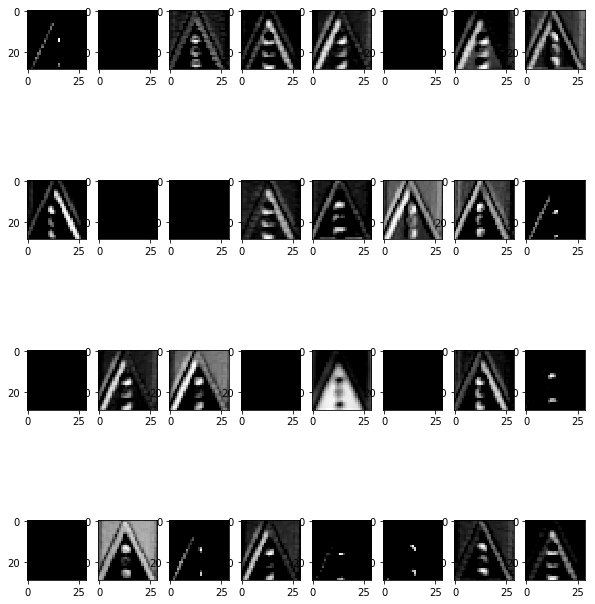

Multiple kernel activations starting from 0


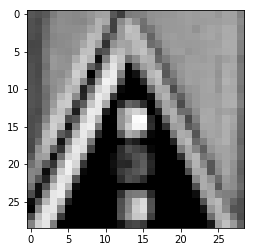

Activation for 41 kernel in 2 layer.


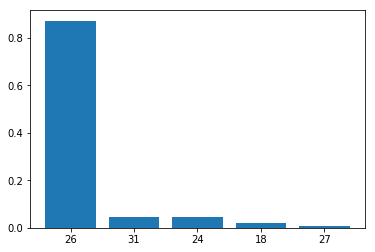

Probabilities of top 5 classes.


In [0]:
idx = 684
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 2, y_true, y_prediction)

Actual class it belongs to: 2
Predicted class 4
Actual training image


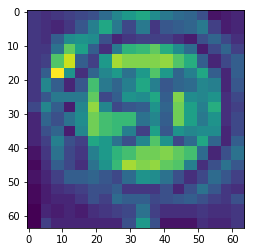

The kernel which activates/recognizes the shape: 4


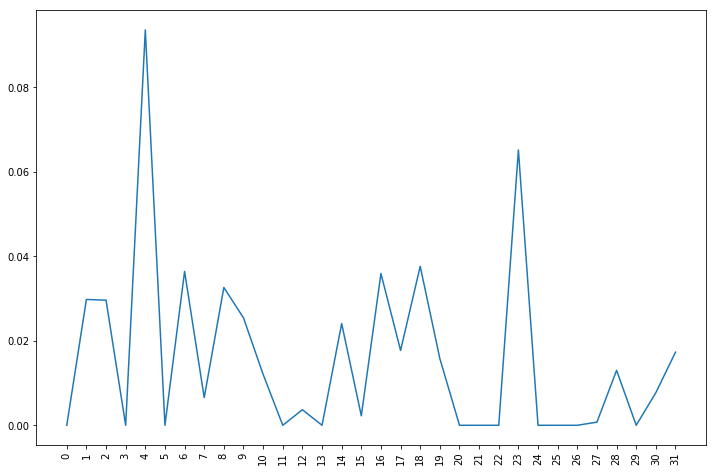

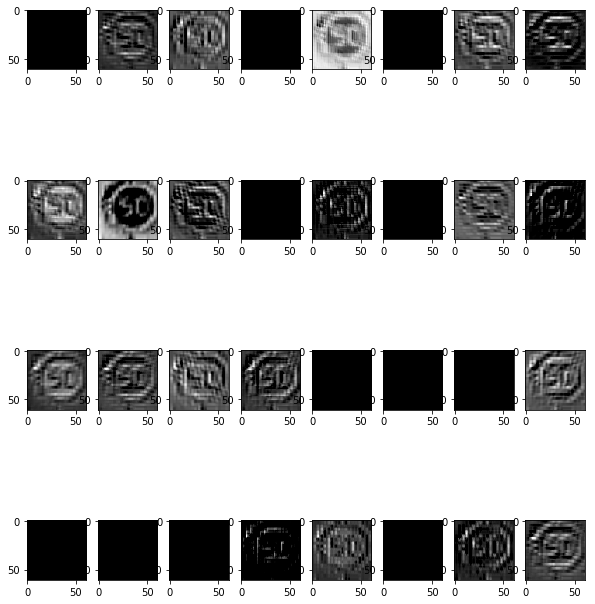

Multiple kernel activations starting from 0


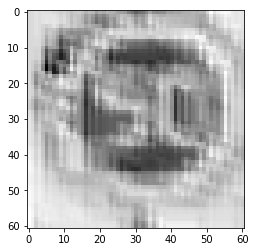

Activation for 4 kernel in 0 layer.


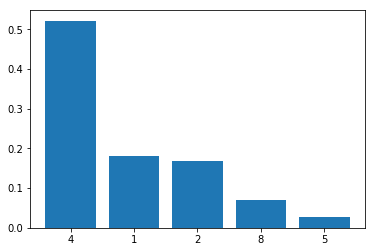

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 4
Actual training image


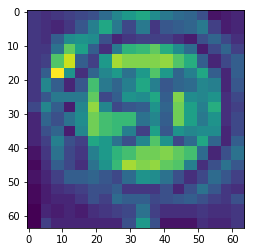

The kernel which activates/recognizes the shape: 46


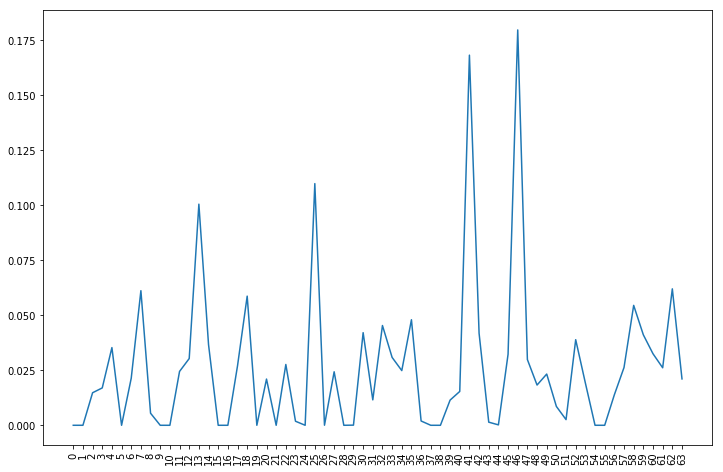

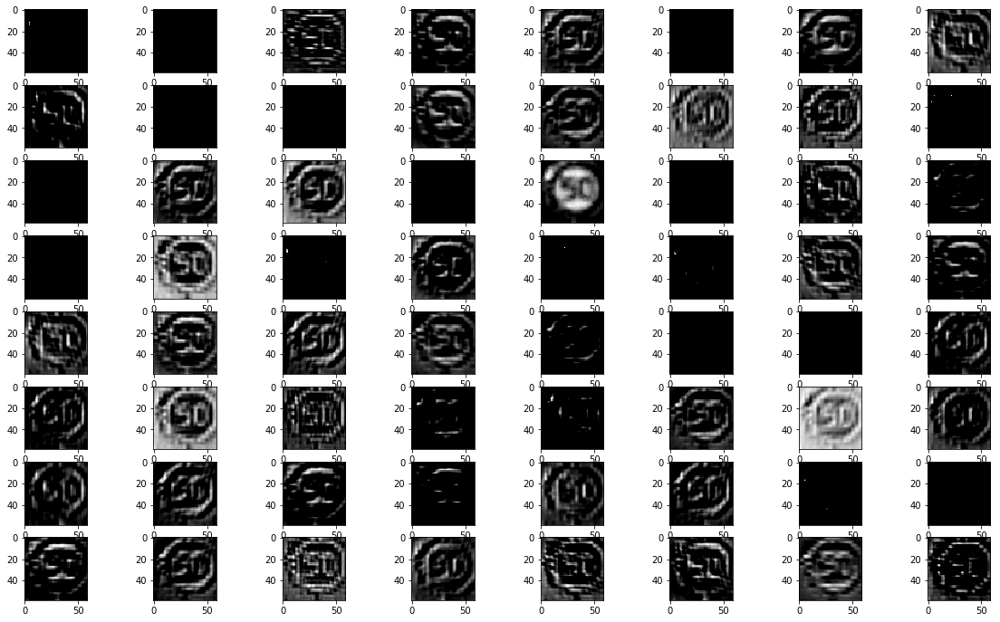

Multiple kernel activations starting from 0


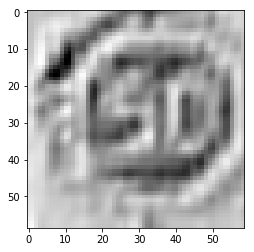

Activation for 46 kernel in 1 layer.


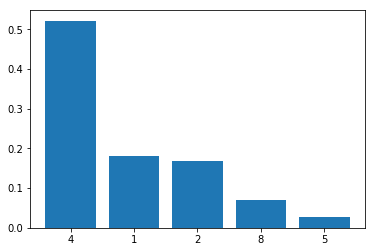

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 4
Actual training image


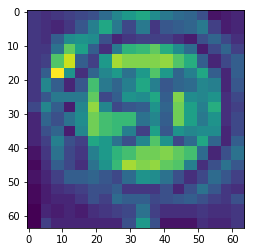

The kernel which activates/recognizes the shape: 41


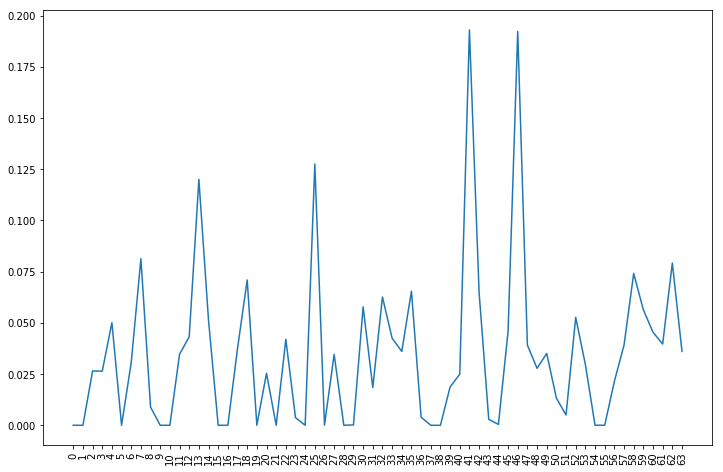

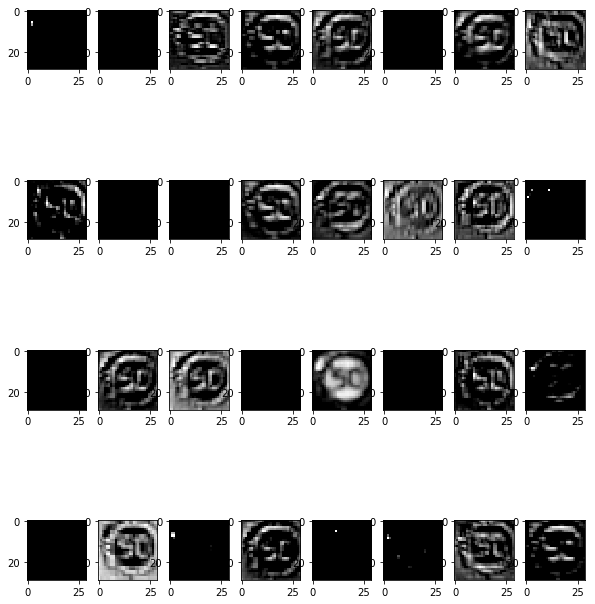

Multiple kernel activations starting from 0


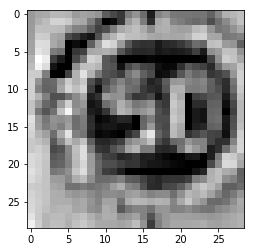

Activation for 41 kernel in 2 layer.


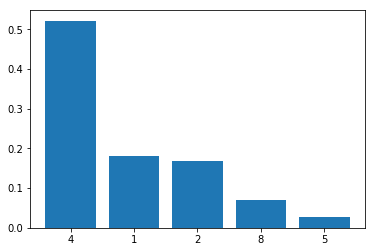

Probabilities of top 5 classes.


In [0]:
idx = 11078
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 2, y_true, y_prediction)

Actual class it belongs to: 2
Predicted class 2
Actual training image


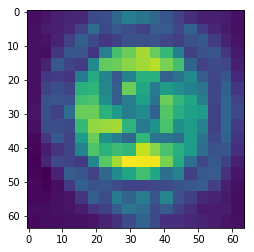

The kernel which activates/recognizes the shape: 16


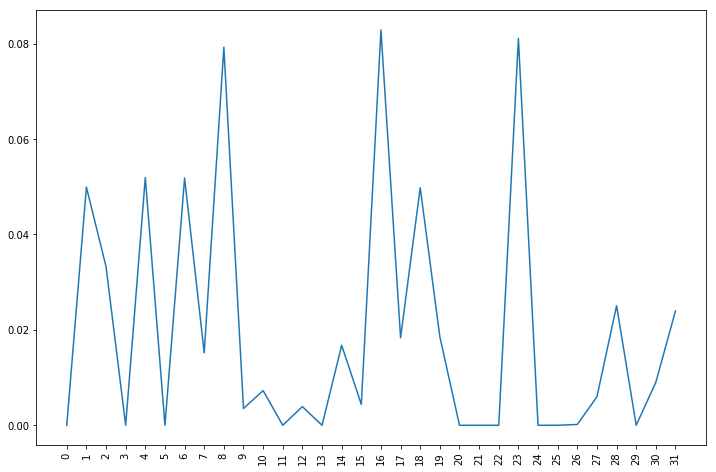

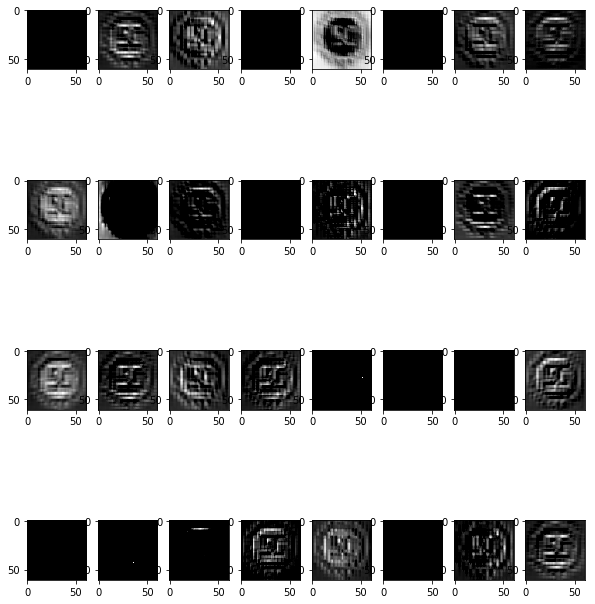

Multiple kernel activations starting from 0


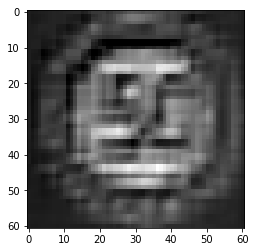

Activation for 16 kernel in 0 layer.


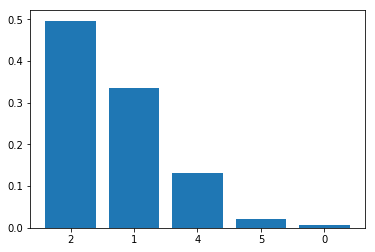

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


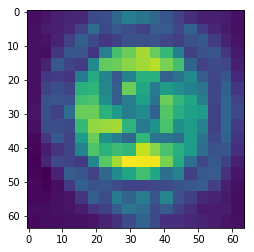

The kernel which activates/recognizes the shape: 20


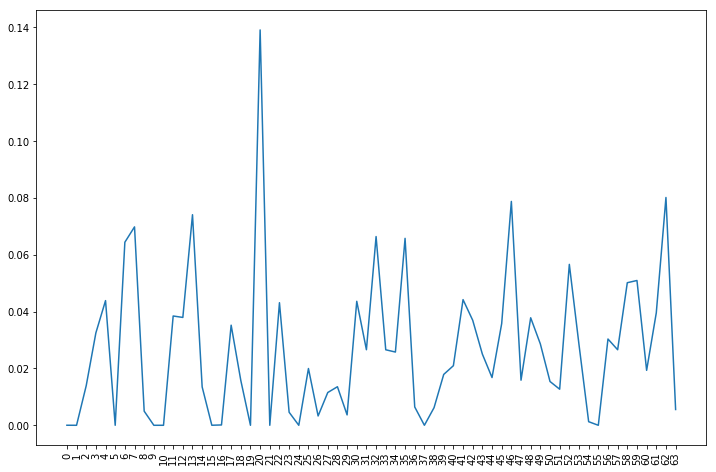

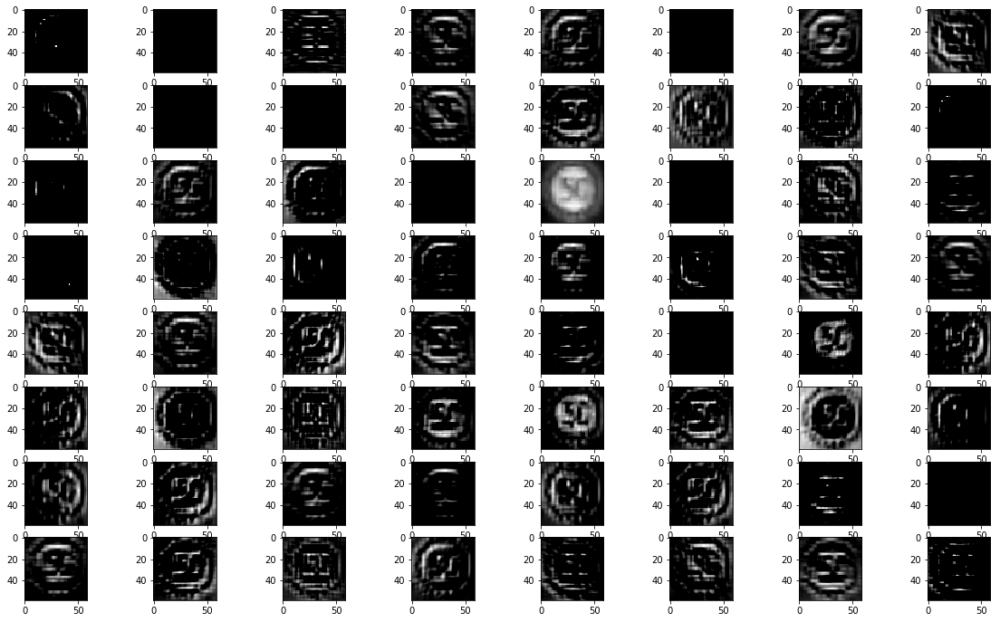

Multiple kernel activations starting from 0


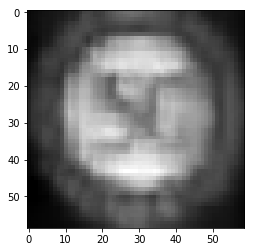

Activation for 20 kernel in 1 layer.


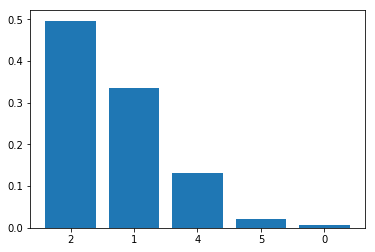

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


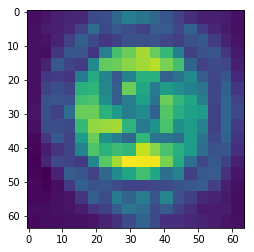

The kernel which activates/recognizes the shape: 20


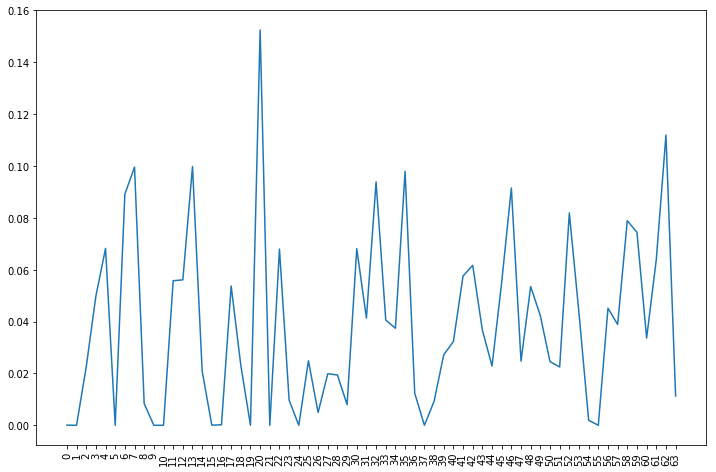

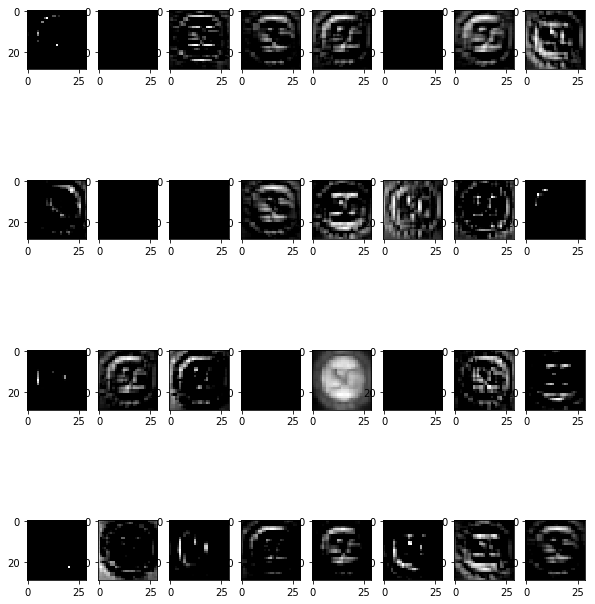

Multiple kernel activations starting from 0


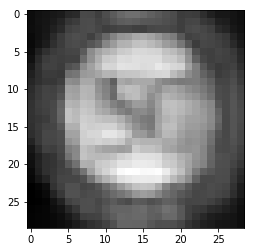

Activation for 20 kernel in 2 layer.


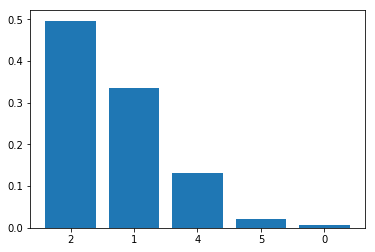

Probabilities of top 5 classes.


In [0]:
idx = 11527
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 2, y_true, y_prediction)

### [5.5] Conv(32 -- 4x4) - Conv(64 -- 3x3) - MaxPool(2x2) - Conv(32 -- 4x4) - Dropout(0.75) - MaxPool(2x2) - Conv(32 -- 3x3) - Dense(256) - Dropout(0.5) - Dense(128) - Dropout(0.5)

In [0]:
epochs = 15
model = Sequential()
model.add(Conv2D(
    32, kernel_size=(4, 4), activation='relu', input_shape=input_shape
))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (4, 4), activation='relu'))
model.add(Dropout(rate=0.75))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
    #class_weight=class_weights
)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_12 (Conv2D)           (None, 61, 61, 32)        544       
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 59, 59, 64)        18496     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 29, 29, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 26, 26, 32)        32800     
_________________________________________________________________
dropout_11 (Dropout)         (None, 26, 26, 32)        0         
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 13, 13, 32)        0         
_________________________________________________________________
conv2d_15 (Conv2D)           (None, 11, 11, 32)        9248      
__________

Test loss: 0.0455806721879902
Test accuracy: 0.9916687919748364


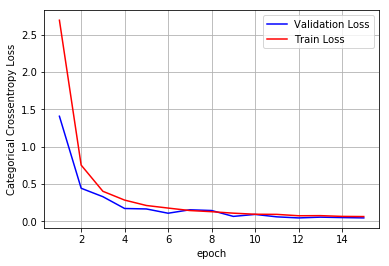

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9907992327028173
------------------------------------------------------


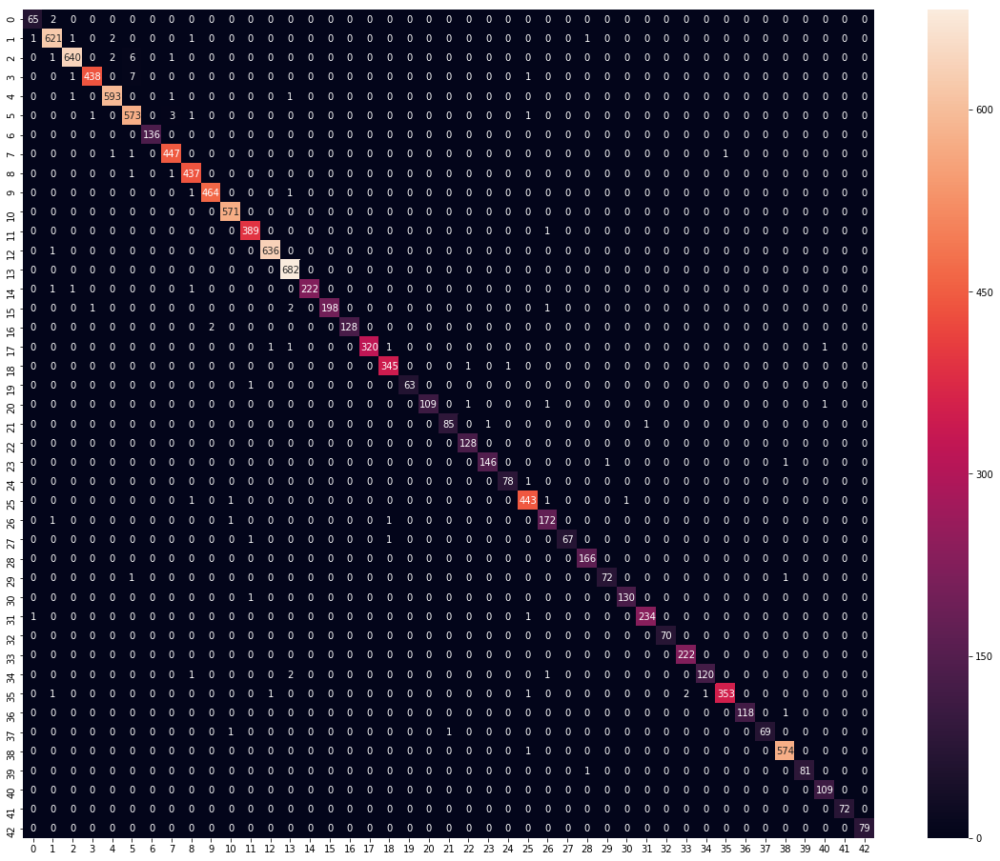

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 2
Predicted class 2
Actual training image


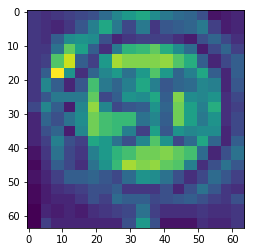

The kernel which activates/recognizes the shape: 3


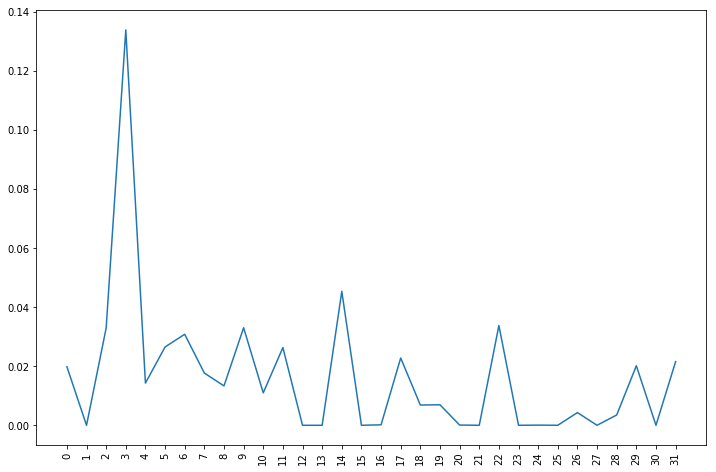

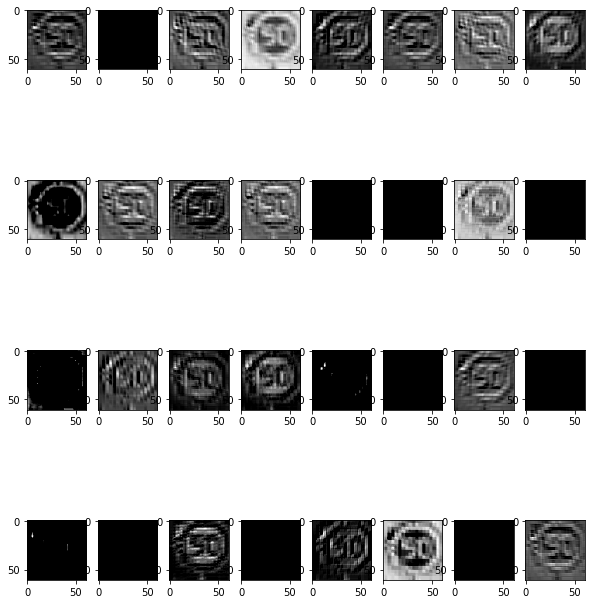

Multiple kernel activations starting from 0


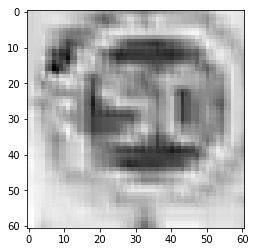

Activation for 3 kernel in 0 layer.


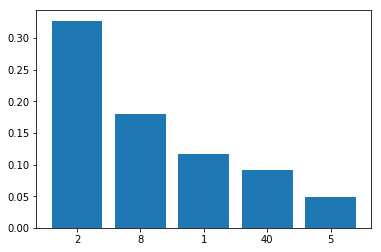

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


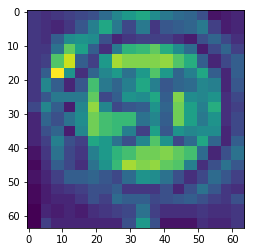

The kernel which activates/recognizes the shape: 17


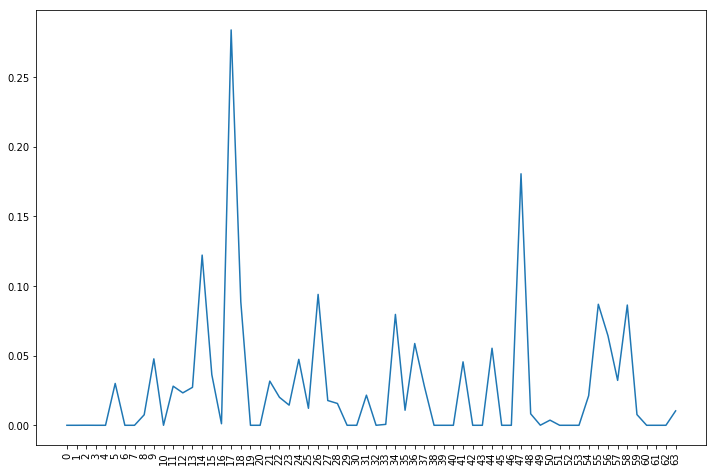

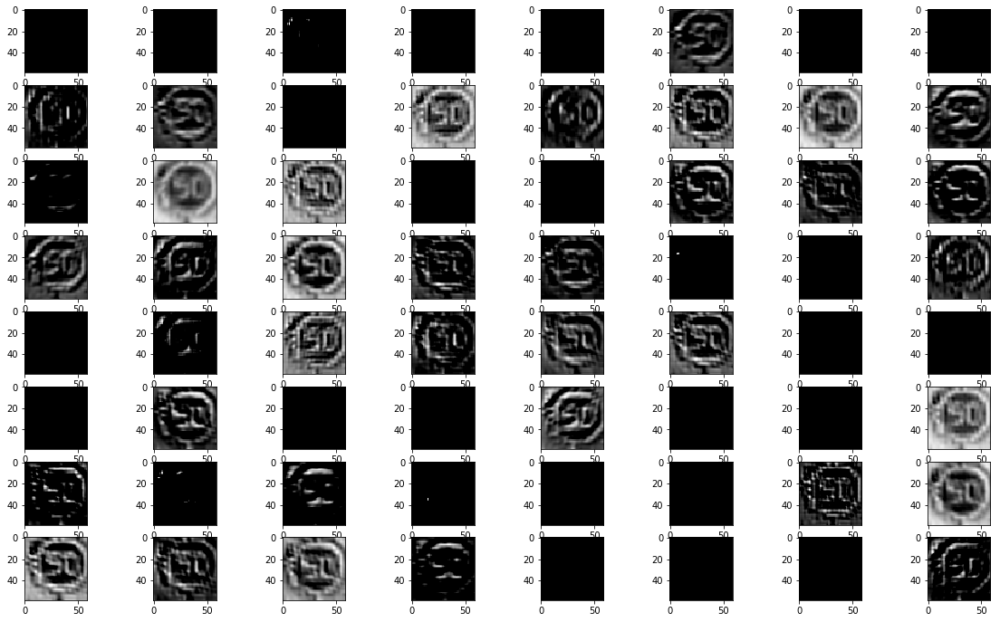

Multiple kernel activations starting from 0


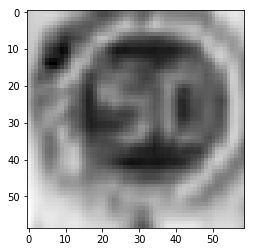

Activation for 17 kernel in 1 layer.


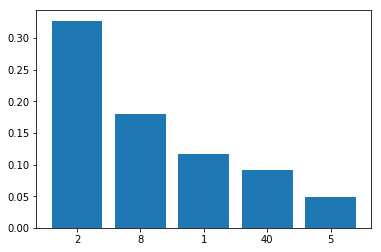

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


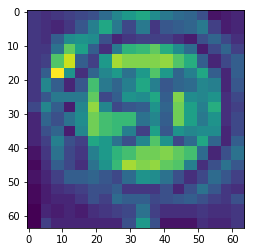

The kernel which activates/recognizes the shape: 13


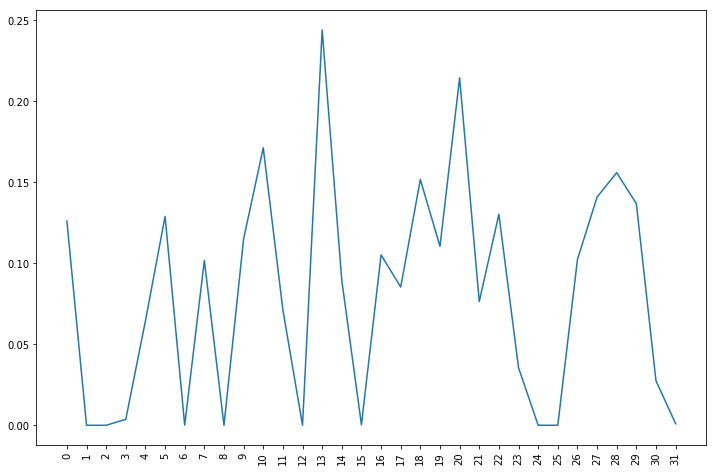

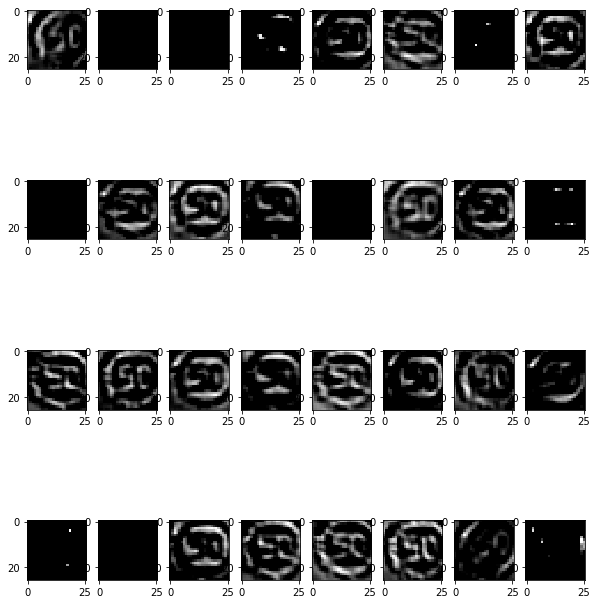

Multiple kernel activations starting from 0


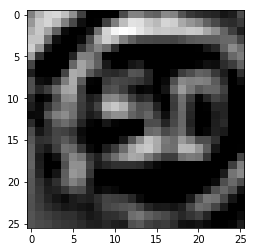

Activation for 13 kernel in 3 layer.


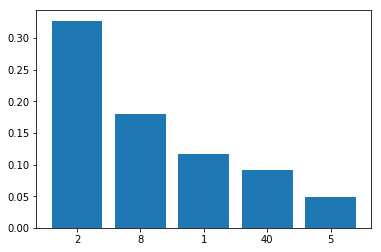

Probabilities of top 5 classes.


In [0]:
idx = 11078
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 2
Predicted class 2
Actual training image


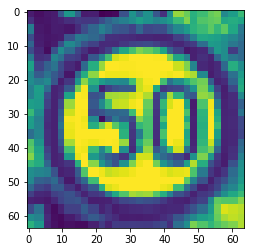

The kernel which activates/recognizes the shape: 7


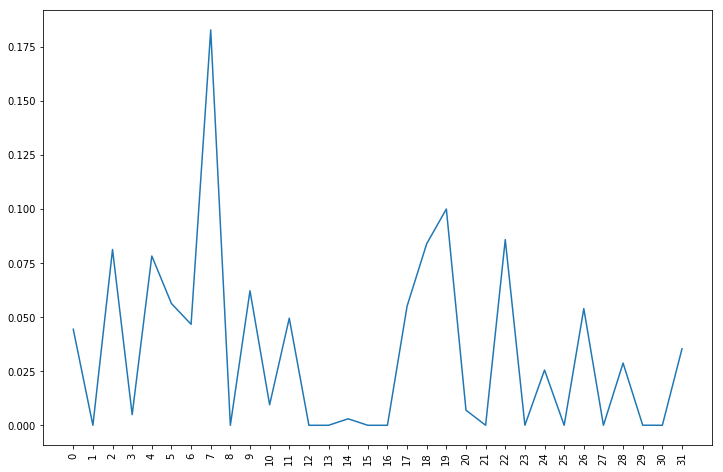

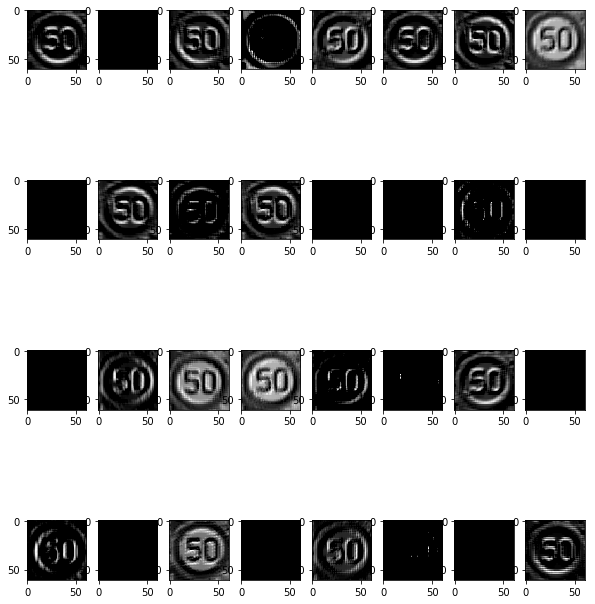

Multiple kernel activations starting from 0


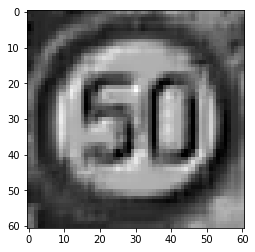

Activation for 7 kernel in 0 layer.


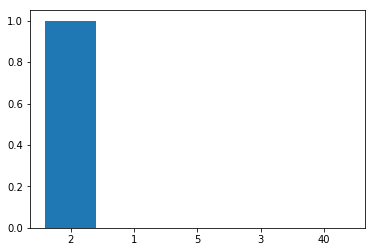

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


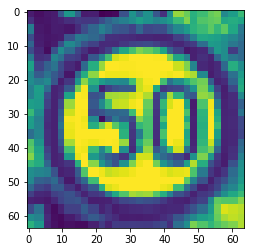

The kernel which activates/recognizes the shape: 36


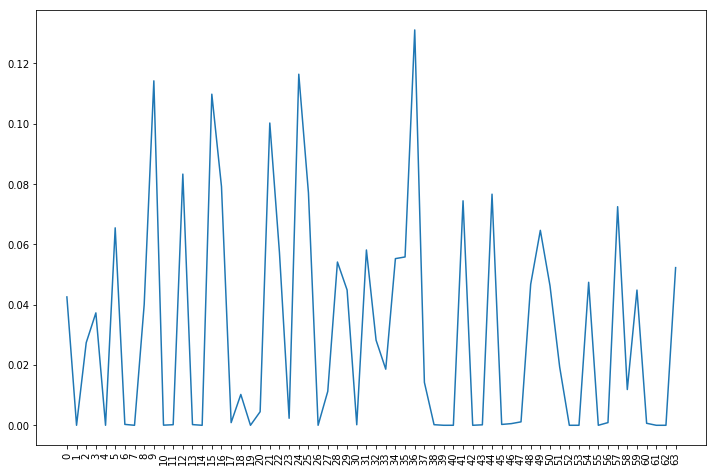

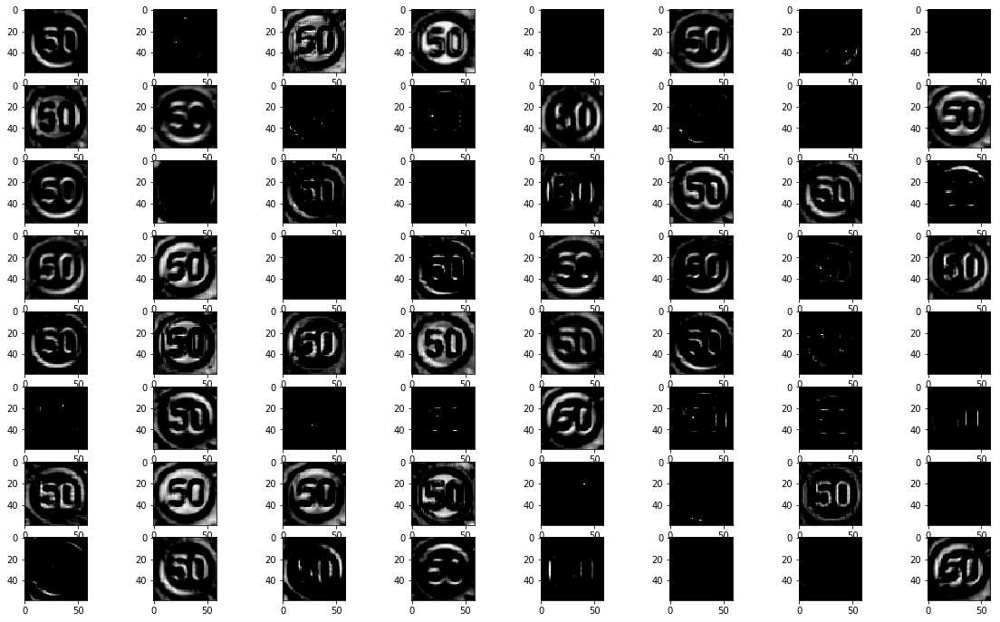

Multiple kernel activations starting from 0


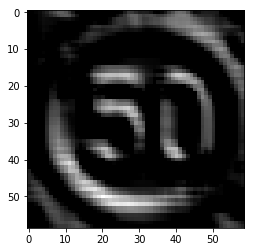

Activation for 36 kernel in 1 layer.


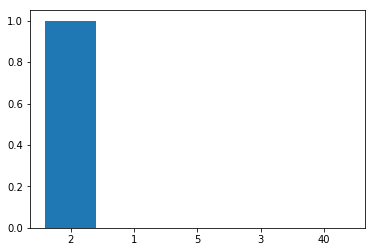

Probabilities of top 5 classes.
Actual class it belongs to: 2
Predicted class 2
Actual training image


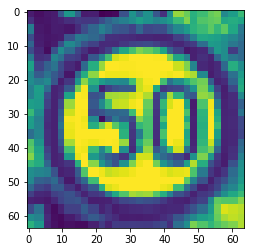

The kernel which activates/recognizes the shape: 29


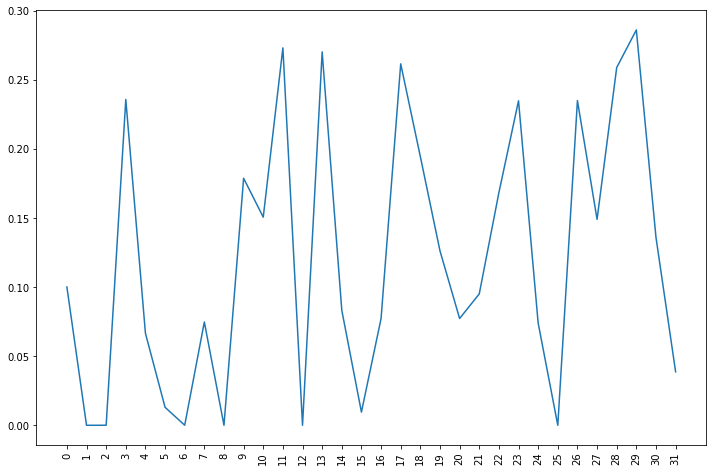

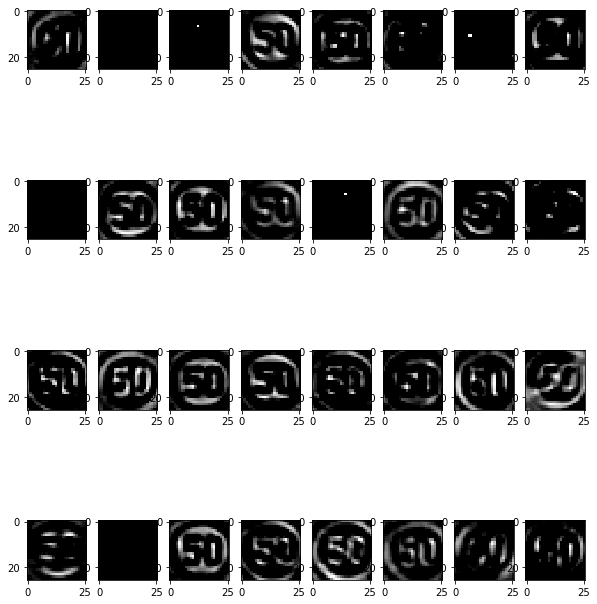

Multiple kernel activations starting from 0


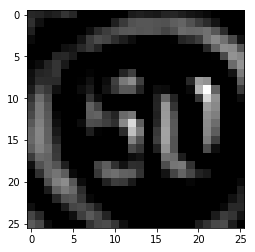

Activation for 29 kernel in 3 layer.


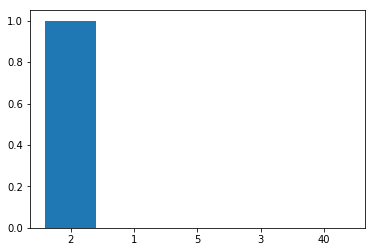

Probabilities of top 5 classes.


In [0]:
idx = 9777
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 5
Predicted class 5
Actual training image


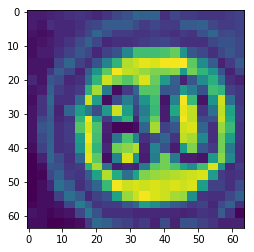

The kernel which activates/recognizes the shape: 3


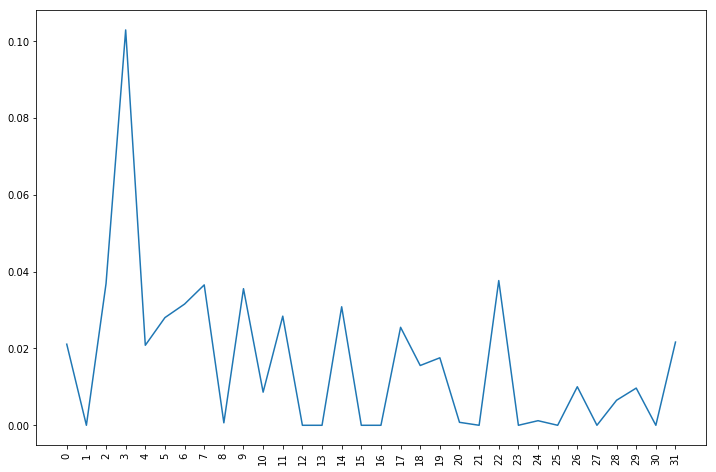

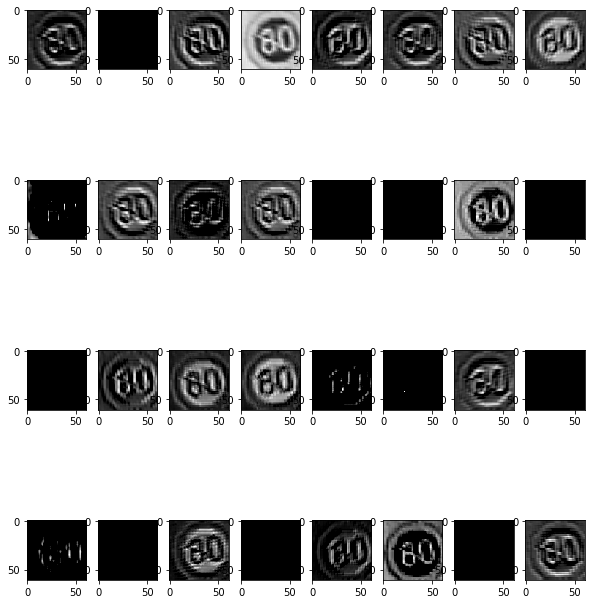

Multiple kernel activations starting from 0


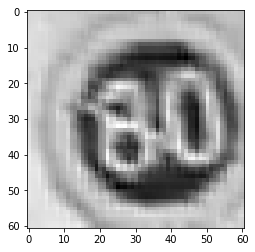

Activation for 3 kernel in 0 layer.


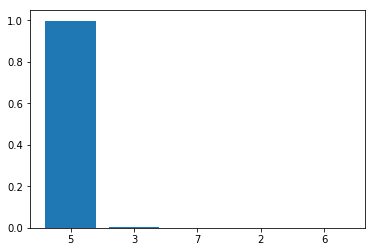

Probabilities of top 5 classes.
Actual class it belongs to: 5
Predicted class 5
Actual training image


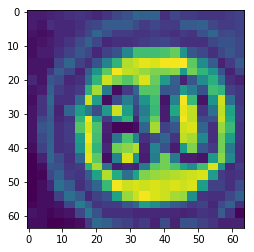

The kernel which activates/recognizes the shape: 17


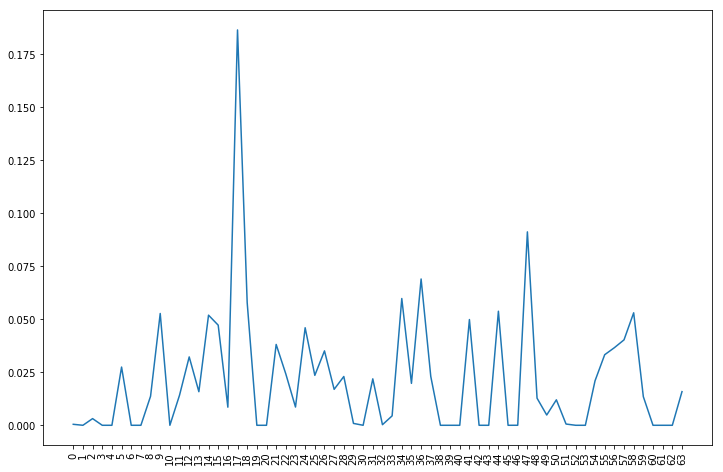

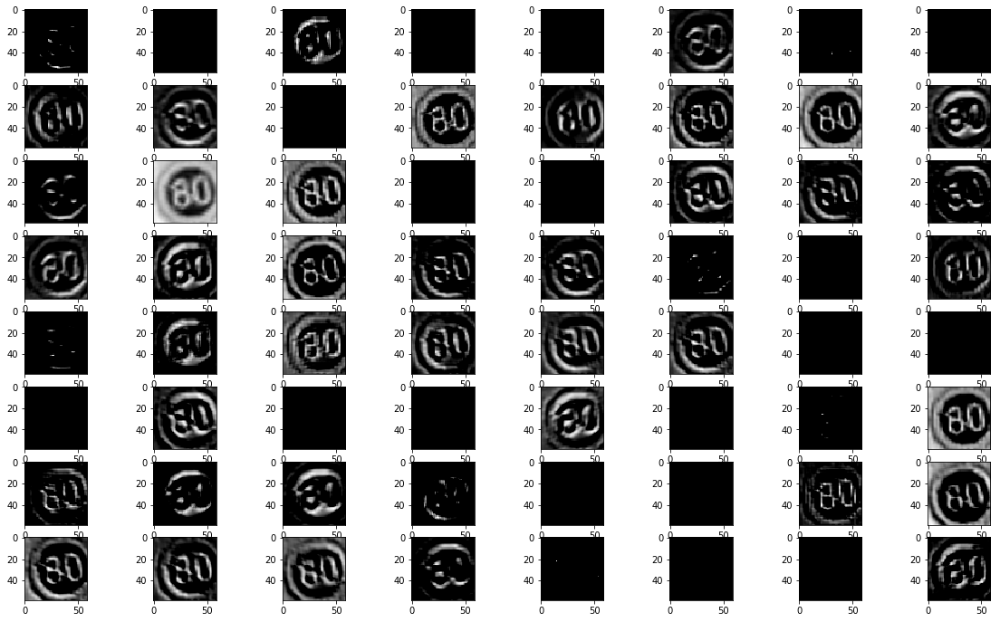

Multiple kernel activations starting from 0


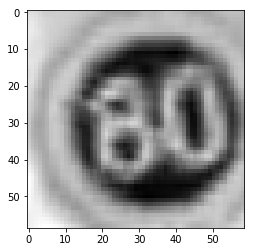

Activation for 17 kernel in 1 layer.


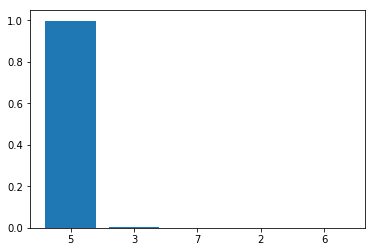

Probabilities of top 5 classes.
Actual class it belongs to: 5
Predicted class 5
Actual training image


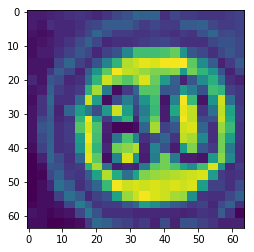

The kernel which activates/recognizes the shape: 13


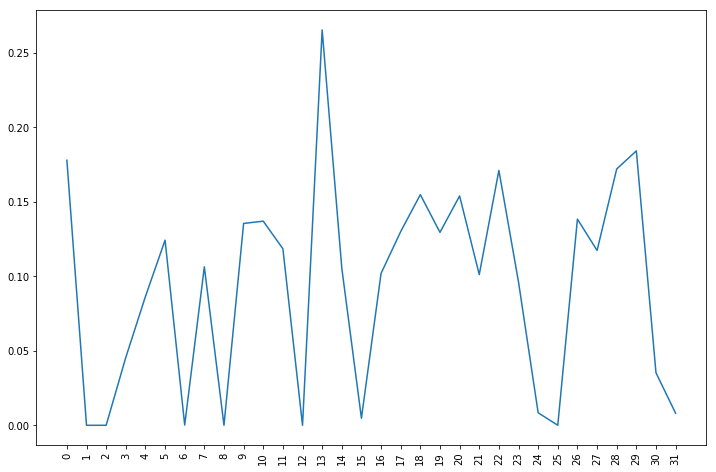

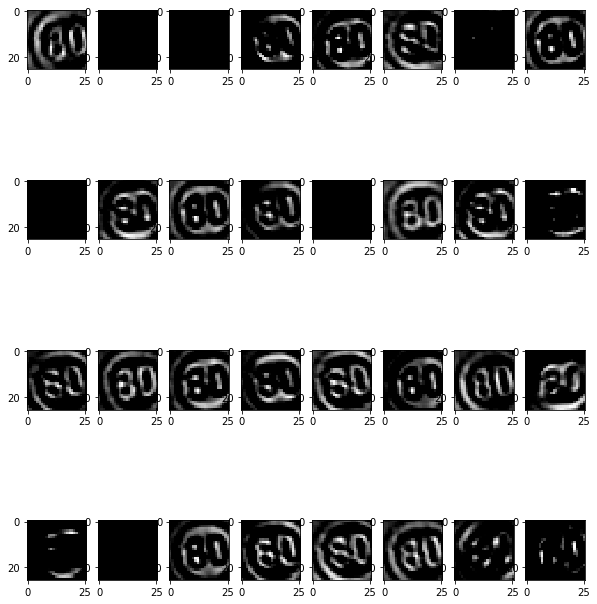

Multiple kernel activations starting from 0


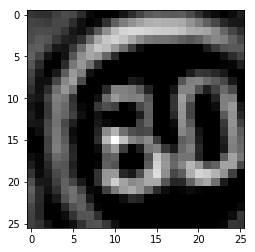

Activation for 13 kernel in 3 layer.


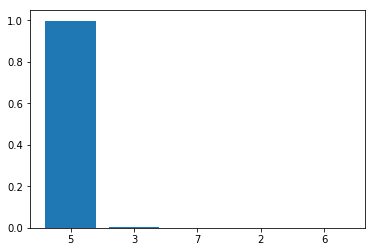

Probabilities of top 5 classes.


In [0]:
idx = 11650
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

In [0]:
actual_class = []
index_image = []
predicted_class = []
for idx, im in enumerate(y_true):
    if im != np.argmax(y_prediction[idx]):
        actual_class.append(im)
        predicted_class.append(np.argmax(y_prediction[idx]))
        index_image.append(idx)
np.array(index_image)

array([   37,    41,   151,   365,   569,   572,   592,   621,   654,
         696,   836,   972,   981,  1193,  1204,  1210,  1321,  1395,
        1518,  1593,  1748,  1750,  1880,  1915,  1926,  2165,  2288,
        2325,  2365,  2392,  2639,  2925,  2967,  2978,  3080,  3450,
        3510,  3592,  3669,  3823,  3853,  3950,  4083,  4316,  4558,
        4738,  4854,  4926,  5032,  5089,  5189,  5240,  5491,  5513,
        5618,  5666,  5995,  6102,  6166,  6175,  6806,  6930,  7086,
        7210,  7269,  7378,  7481,  7520,  7521,  7533,  7570,  7626,
        7678,  7700,  7716,  7796,  7914,  8200,  8207,  8235,  8346,
        8348,  8412,  8492,  8510,  8578,  8598,  8632,  8723,  8735,
        8739,  9361,  9664,  9878, 10073, 10125, 10589, 10621, 10651,
       10814, 10845, 10917, 11042, 11090, 11211, 11301, 11307, 11333,
       11361, 11366, 11527, 11653, 11697, 11711])

Actual class it belongs to: 28
Predicted class 23
Actual training image


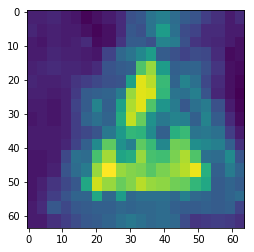

The kernel which activates/recognizes the shape: 3


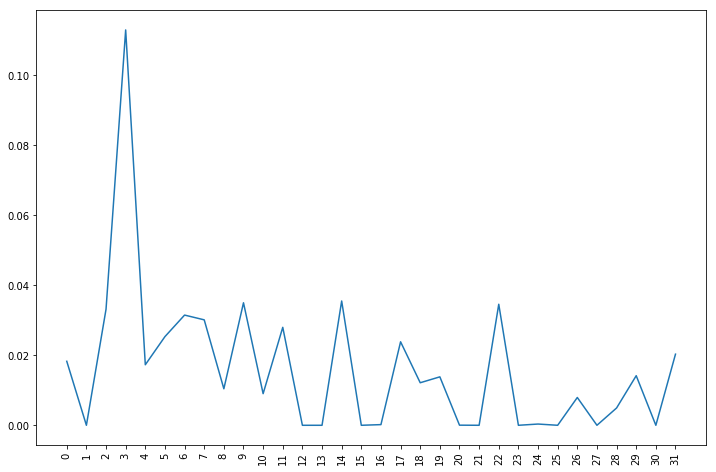

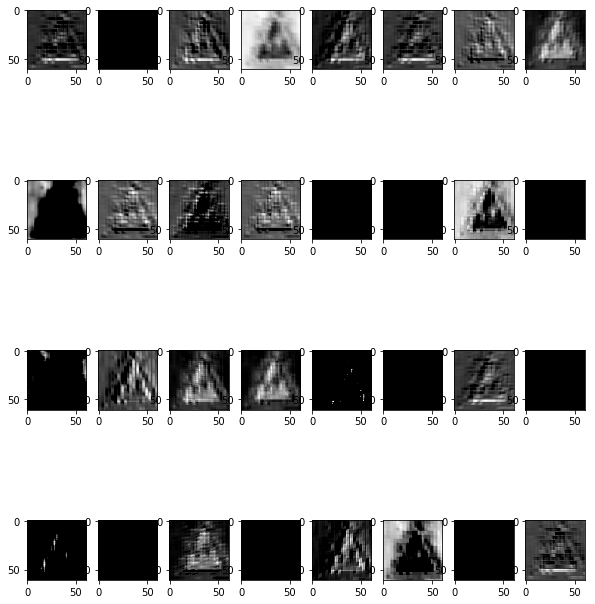

Multiple kernel activations starting from 0


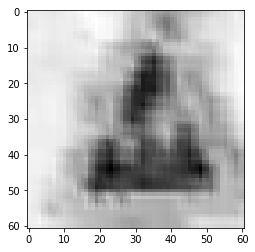

Activation for 3 kernel in 0 layer.


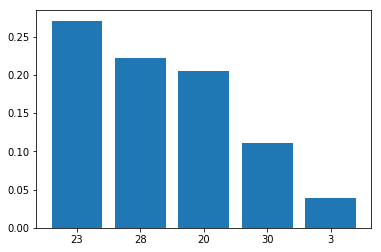

Probabilities of top 5 classes.
Actual class it belongs to: 28
Predicted class 23
Actual training image


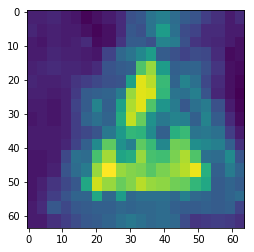

The kernel which activates/recognizes the shape: 17


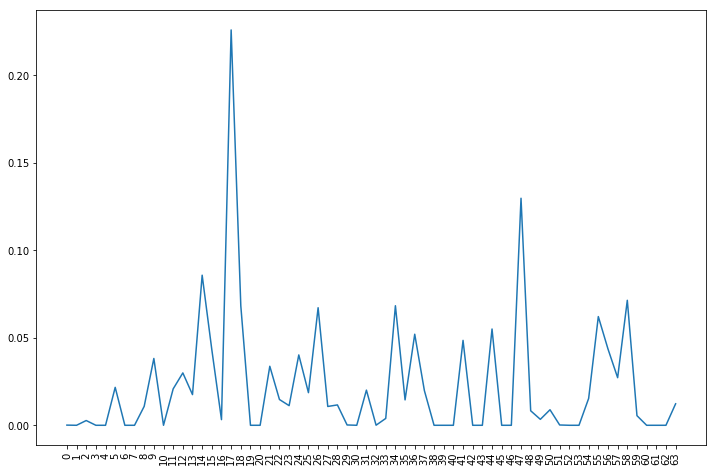

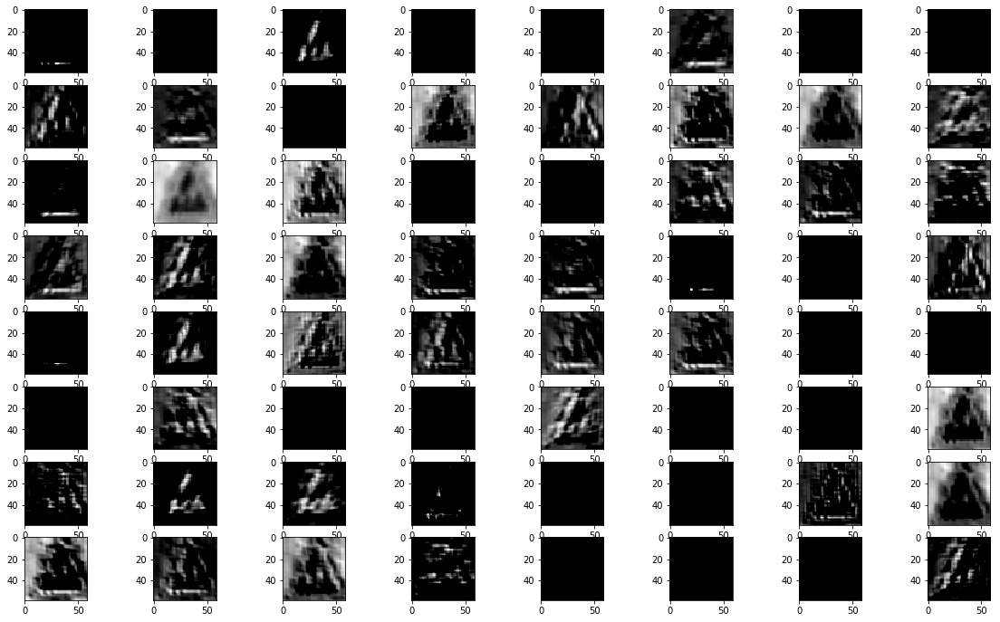

Multiple kernel activations starting from 0


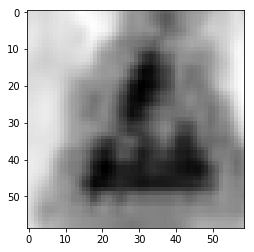

Activation for 17 kernel in 1 layer.


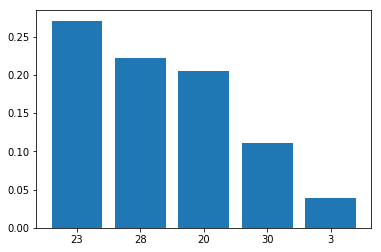

Probabilities of top 5 classes.
Actual class it belongs to: 28
Predicted class 23
Actual training image


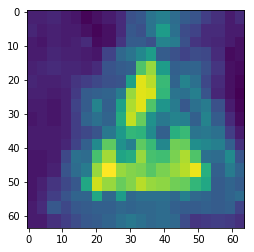

The kernel which activates/recognizes the shape: 13


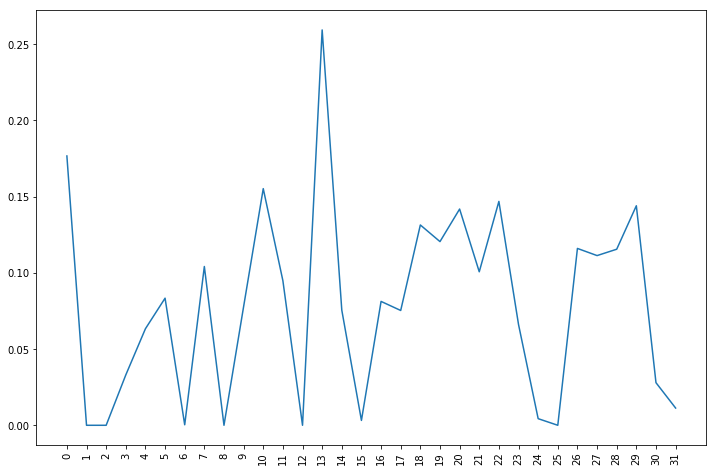

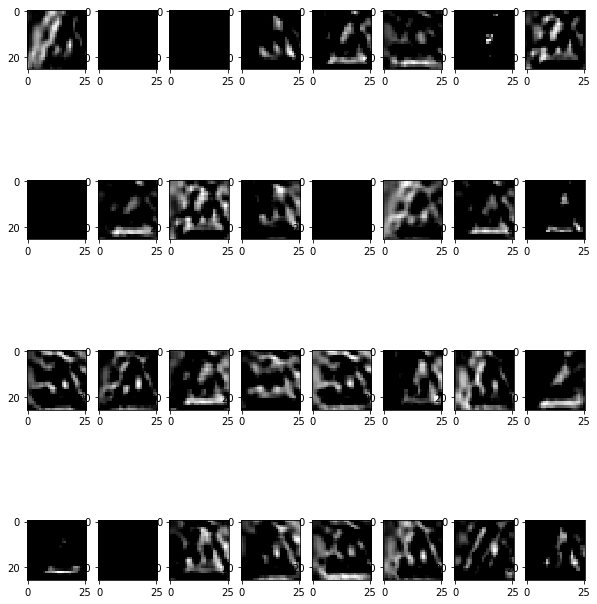

Multiple kernel activations starting from 0


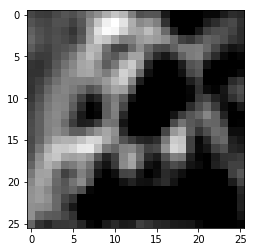

Activation for 13 kernel in 3 layer.


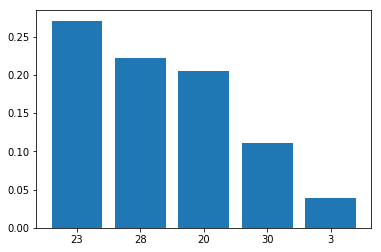

Probabilities of top 5 classes.


In [0]:
idx = 7210
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 34
Predicted class 9
Actual training image


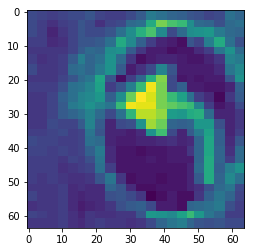

The kernel which activates/recognizes the shape: 3


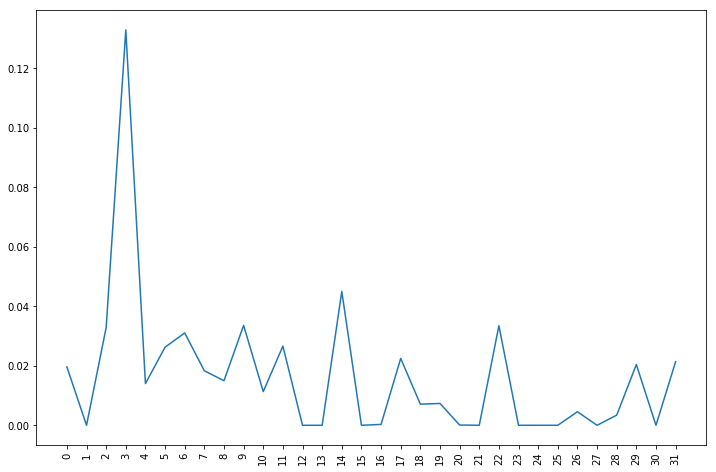

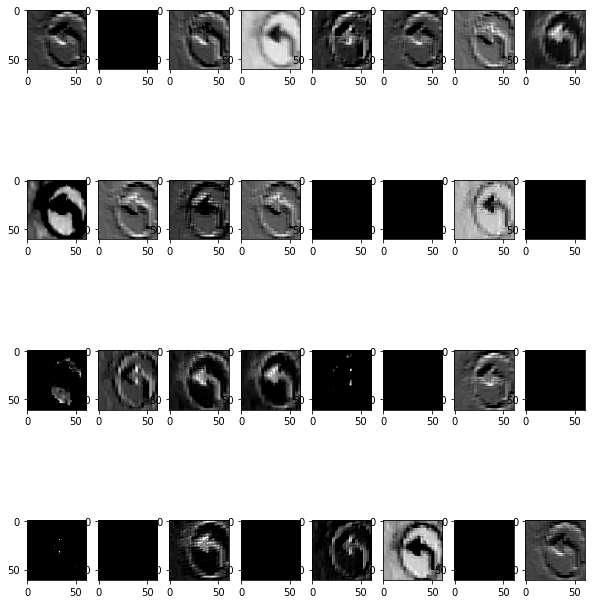

Multiple kernel activations starting from 0


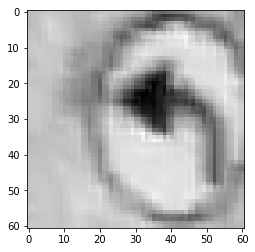

Activation for 3 kernel in 0 layer.


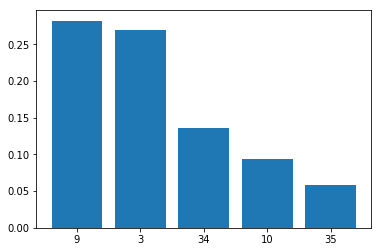

Probabilities of top 5 classes.
Actual class it belongs to: 34
Predicted class 9
Actual training image


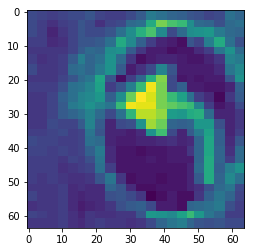

The kernel which activates/recognizes the shape: 17


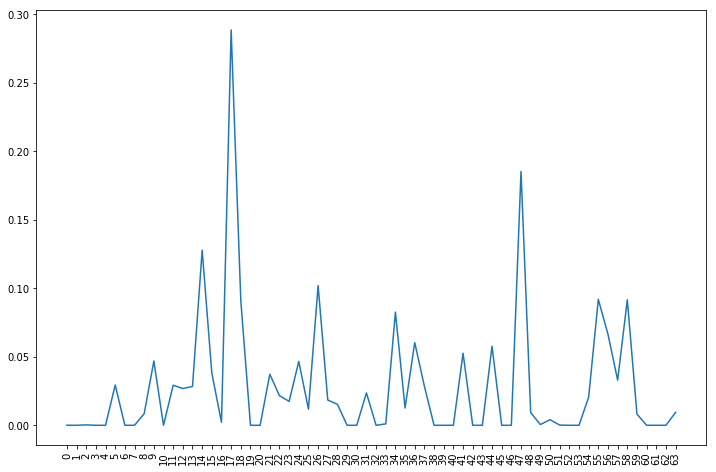

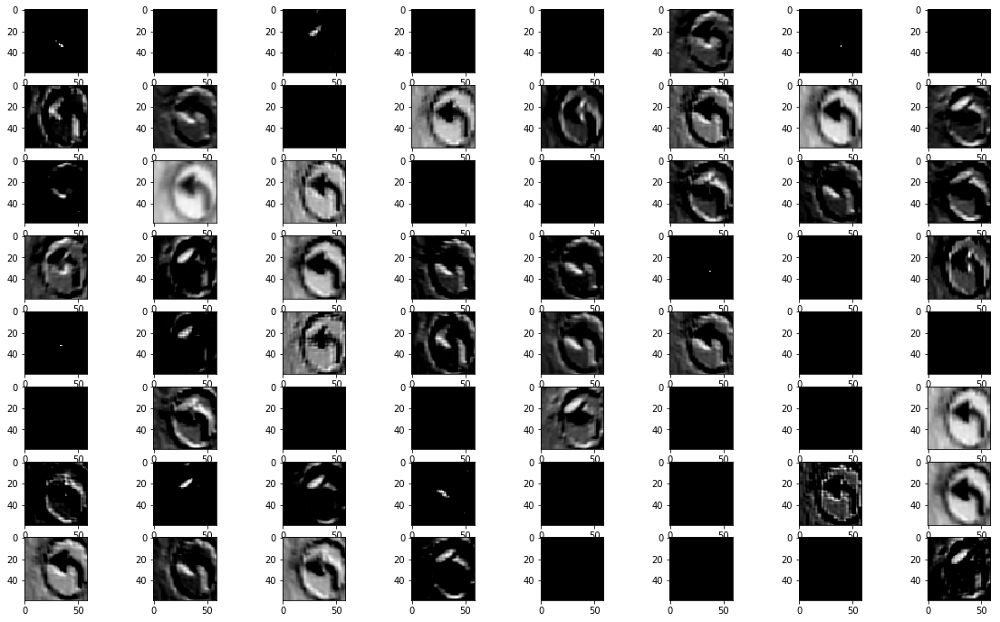

Multiple kernel activations starting from 0


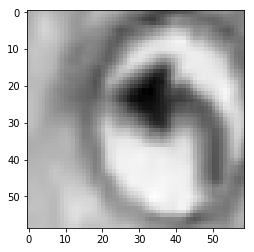

Activation for 17 kernel in 1 layer.


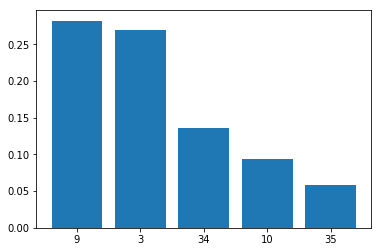

Probabilities of top 5 classes.
Actual class it belongs to: 34
Predicted class 9
Actual training image


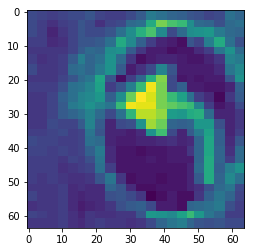

The kernel which activates/recognizes the shape: 13


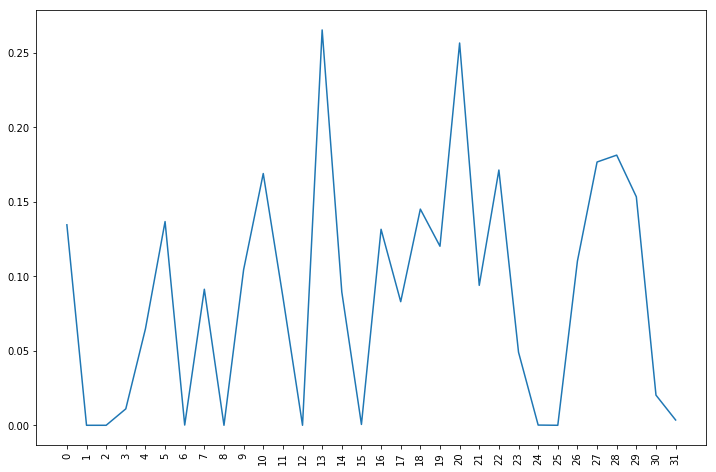

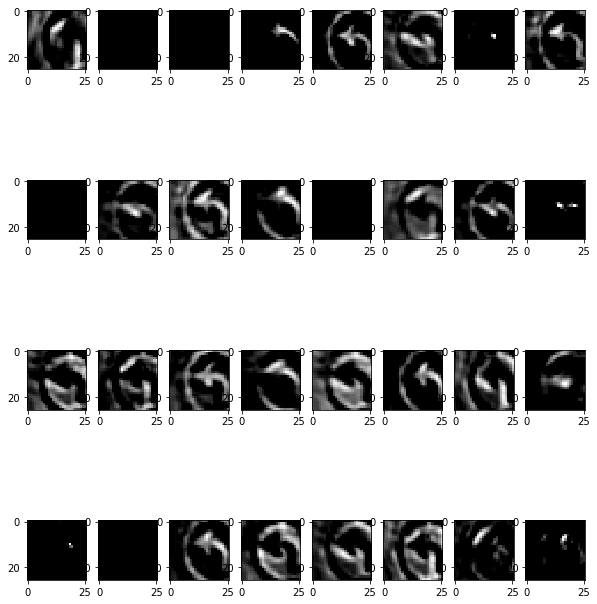

Multiple kernel activations starting from 0


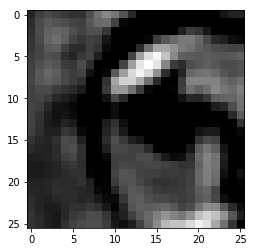

Activation for 13 kernel in 3 layer.


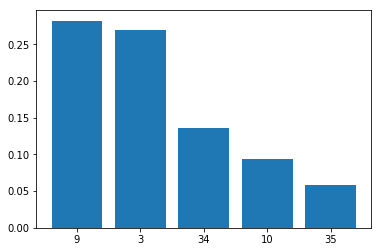

Probabilities of top 5 classes.


In [0]:
idx = 572
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 40
Predicted class 2
Actual training image


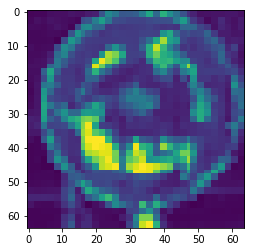

The kernel which activates/recognizes the shape: 7


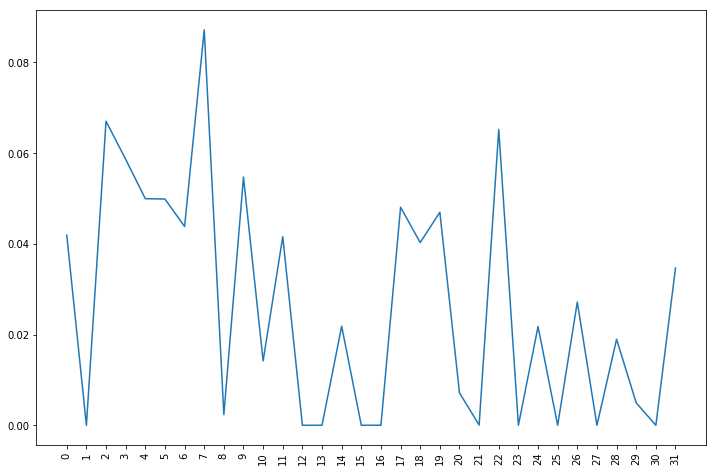

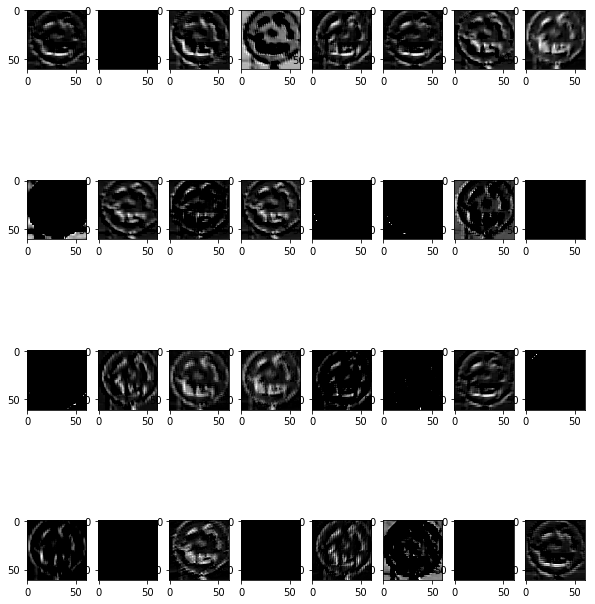

Multiple kernel activations starting from 0


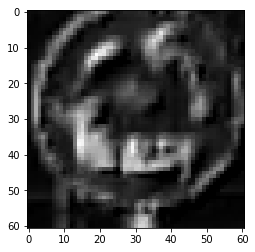

Activation for 7 kernel in 0 layer.


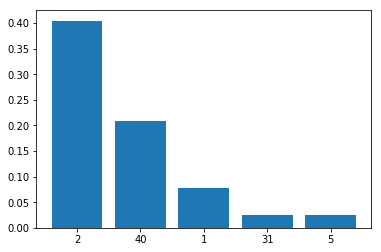

Probabilities of top 5 classes.
Actual class it belongs to: 40
Predicted class 2
Actual training image


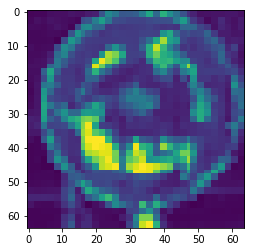

The kernel which activates/recognizes the shape: 36


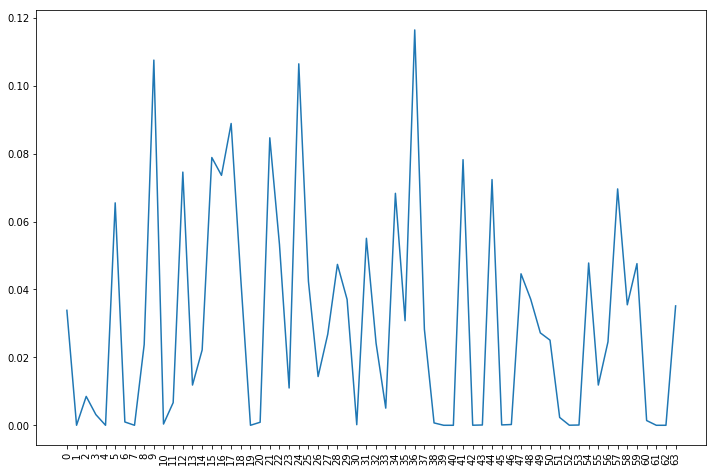

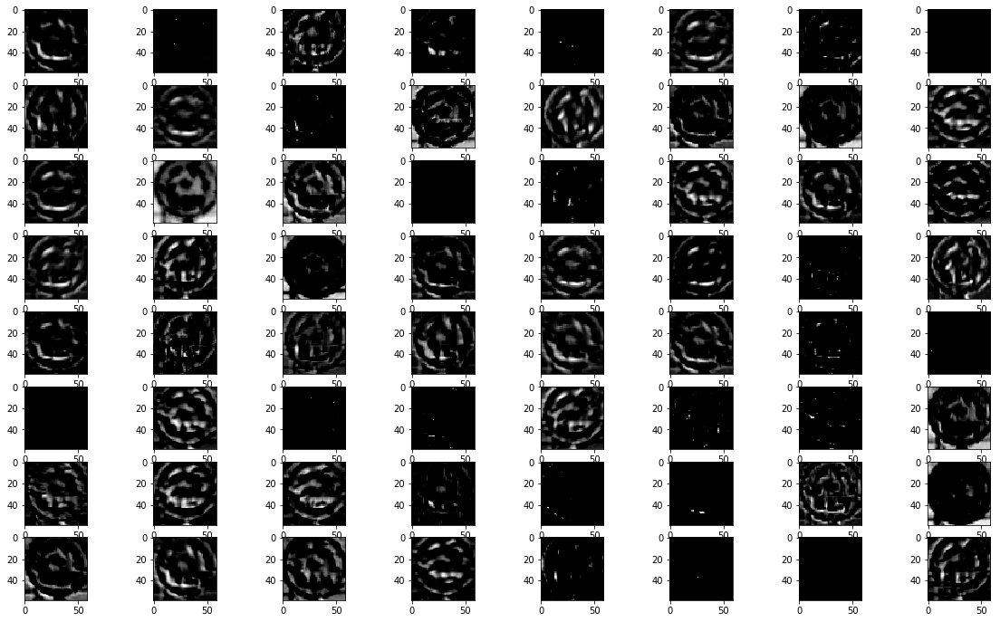

Multiple kernel activations starting from 0


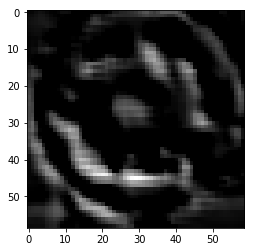

Activation for 36 kernel in 1 layer.


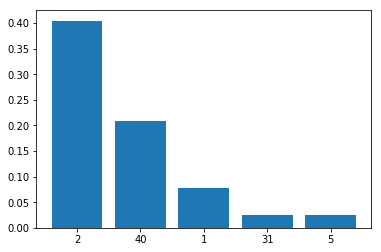

Probabilities of top 5 classes.
Actual class it belongs to: 40
Predicted class 2
Actual training image


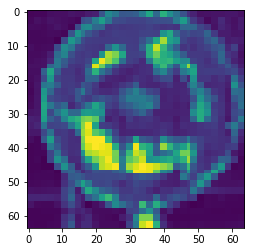

The kernel which activates/recognizes the shape: 11


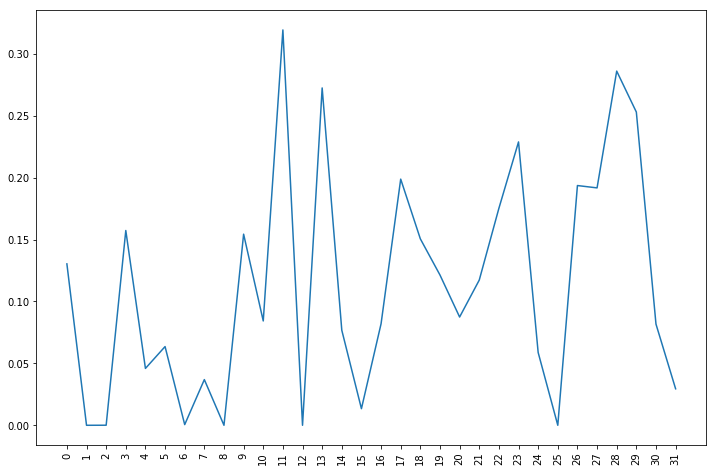

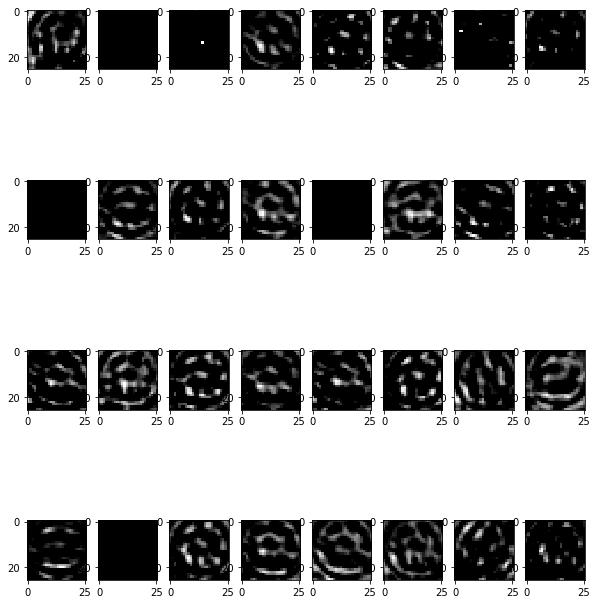

Multiple kernel activations starting from 0


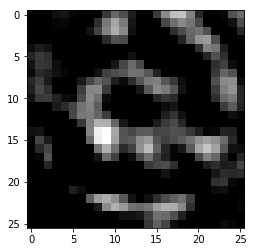

Activation for 11 kernel in 3 layer.


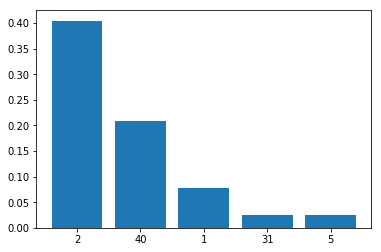

Probabilities of top 5 classes.


In [0]:
idx = 151
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

### [5.6] Conv(32 -- 3x3) - Conv(64 -- 3x3) - MaxPool(2x2) - Conv(32 -- 3x3) -  Dropout(0.75) - MaxPool(2x2) - Conv(32 -- 3x3) - Dense(256) - Dropout(0.5) - Dense(128) - Dropout(0.5) with class weights

In [0]:
from sklearn.utils import class_weight
class_weights = class_weight.compute_class_weight(
    'balanced', np.unique(np.argmax(y_test, axis=1)), 
    np.argmax(y_test, axis=1)
)
class_weights = dict(enumerate(class_weights))
class_weights

{0: 4.082957306490802,
 1: 0.43629687326137756,
 2: 0.42085867620751344,
 3: 0.6119868893397846,
 4: 0.45899016700483847,
 5: 0.47246656223641403,
 6: 2.011456908344733,
 7: 0.607906976744186,
 8: 0.6231392700111247,
 9: 0.5870346341950294,
 10: 0.4790860587300941,
 11: 0.7014311270125224,
 12: 0.42944762878317694,
 13: 0.40111164154675033,
 14: 1.215813953488372,
 15: 1.3542482155192264,
 16: 2.104293381037567,
 17: 0.8443152454780362,
 18: 0.7883519871322298,
 19: 4.274345930232558,
 20: 2.442483388704319,
 21: 3.1443464314354452,
 22: 2.137172965116279,
 23: 1.8483658076681333,
 24: 3.462761259935237,
 25: 0.6119868893397846,
 26: 1.563189368770764,
 27: 3.9646107178968655,
 28: 1.6479405996077332,
 29: 3.6967316153362666,
 30: 2.0882300727853718,
 31: 1.1591446590461174,
 32: 3.9079734219269104,
 33: 1.2322438717787556,
 34: 2.206114028507127,
 35: 0.7620003886765563,
 36: 2.2988078952511235,
 37: 3.852931542744841,
 38: 0.47575328614762386,
 39: 3.336074872376631,
 40: 2.509707702

In [0]:
epochs = 20
model = Sequential()
model.add(Conv2D(
    32, kernel_size=(3, 3), activation='relu', input_shape=input_shape
))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(Dropout(rate=0.75))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(32, (3, 3), activation='relu'))
model.add(Flatten())
model.add(Dense(256, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(128, activation='relu'))
model.add(Dropout(rate=0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adadelta(), metrics=['accuracy']
)

model.summary()

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test),
    class_weight=class_weights
)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_16 (Conv2D)           (None, 62, 62, 32)        320       
_________________________________________________________________
conv2d_17 (Conv2D)           (None, 60, 60, 64)        18496     
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 30, 30, 64)        0         
_________________________________________________________________
conv2d_18 (Conv2D)           (None, 28, 28, 32)        18464     
_________________________________________________________________
dropout_14 (Dropout)         (None, 28, 28, 32)        0         
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_19 (Conv2D)           (None, 12, 12, 32)        9248      
__________

Test loss: 0.05675644269047607
Test accuracy: 0.990478619399813


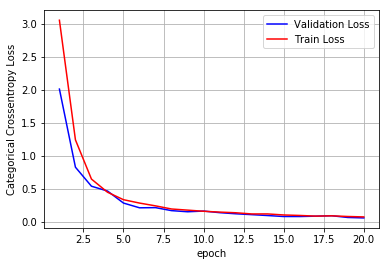

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9890381708275221
------------------------------------------------------


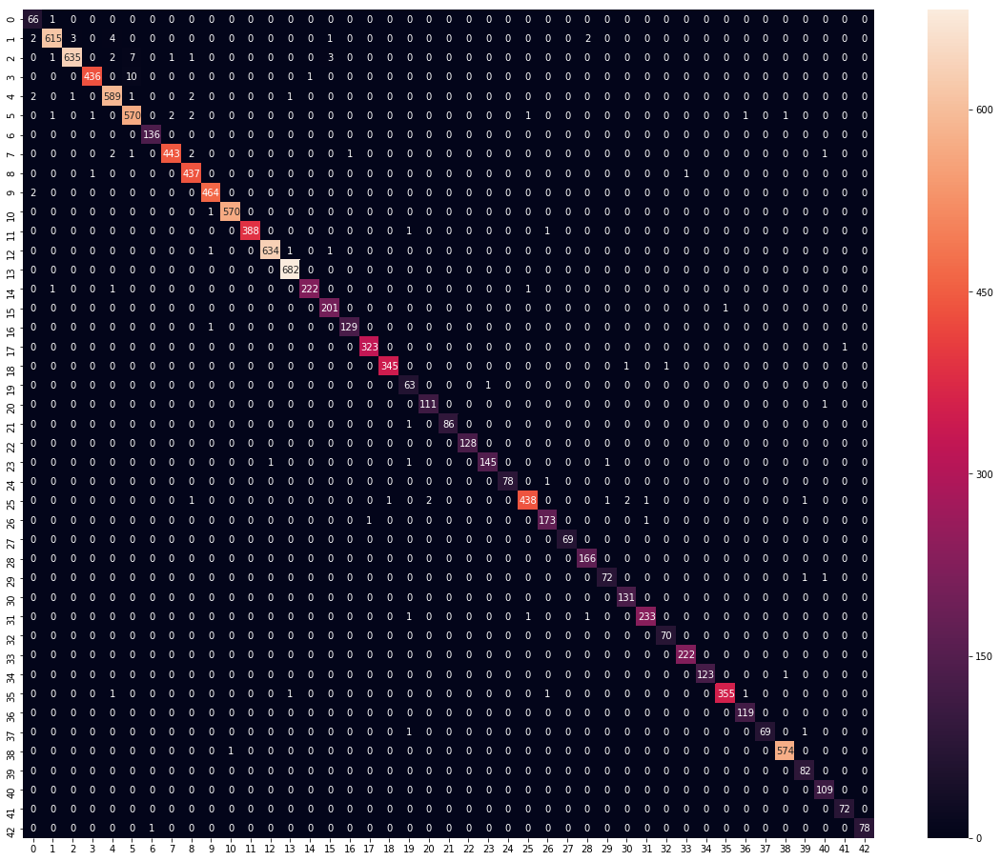

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [0]:
layer_outputs = [layer.output for layer in model.layers]
activation_model = Model(inputs=model.input, outputs=layer_outputs)

Actual class it belongs to: 28
Predicted class 28
Actual training image


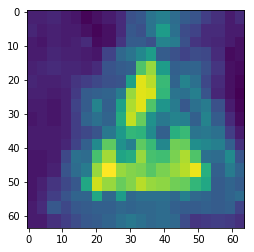

The kernel which activates/recognizes the shape: 1


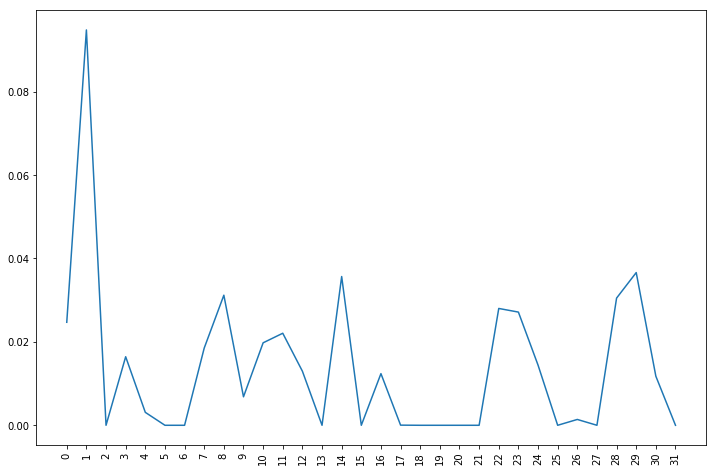

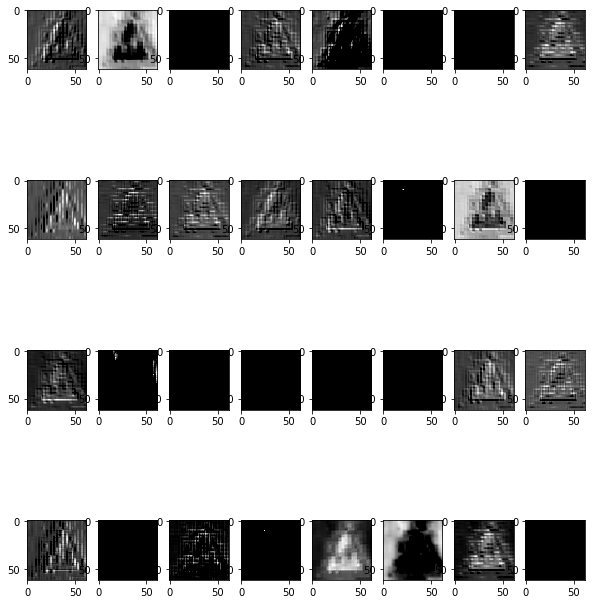

Multiple kernel activations starting from 0


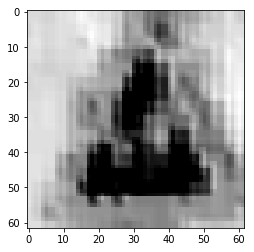

Activation for 1 kernel in 0 layer.


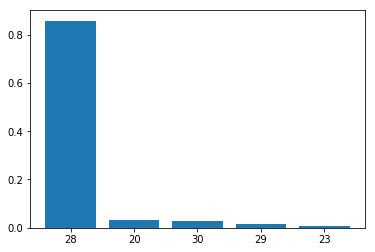

Probabilities of top 5 classes.
Actual class it belongs to: 28
Predicted class 28
Actual training image


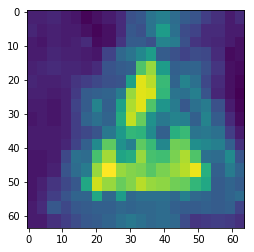

The kernel which activates/recognizes the shape: 53


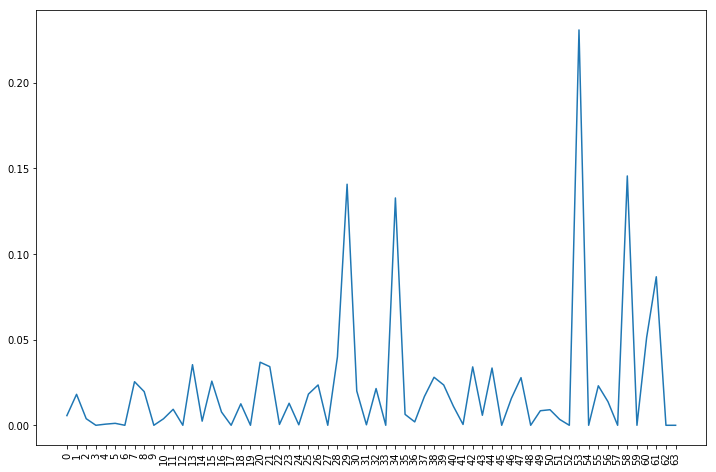

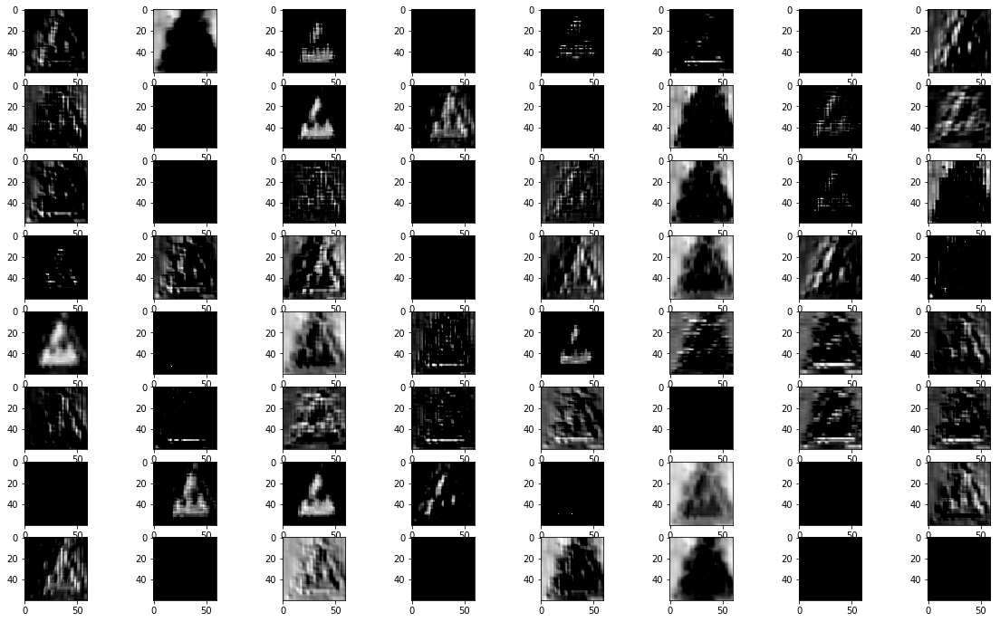

Multiple kernel activations starting from 0


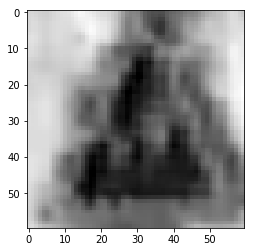

Activation for 53 kernel in 1 layer.


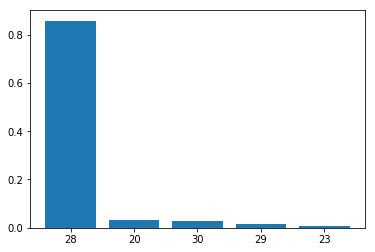

Probabilities of top 5 classes.
Actual class it belongs to: 28
Predicted class 28
Actual training image


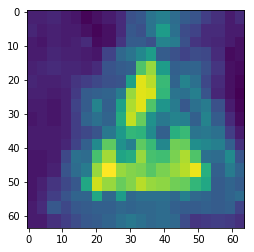

The kernel which activates/recognizes the shape: 22


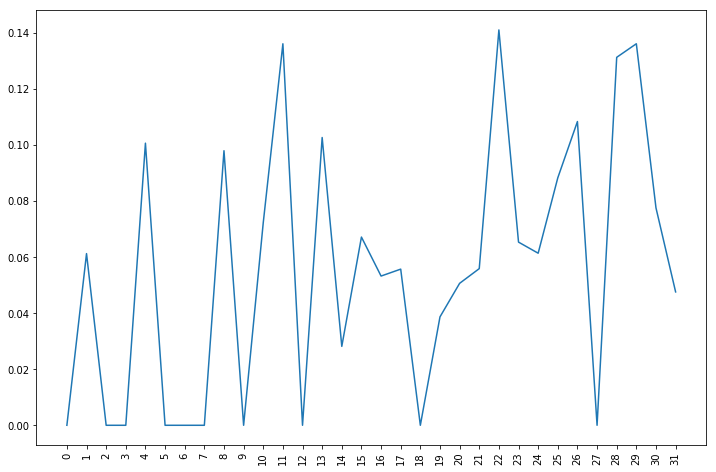

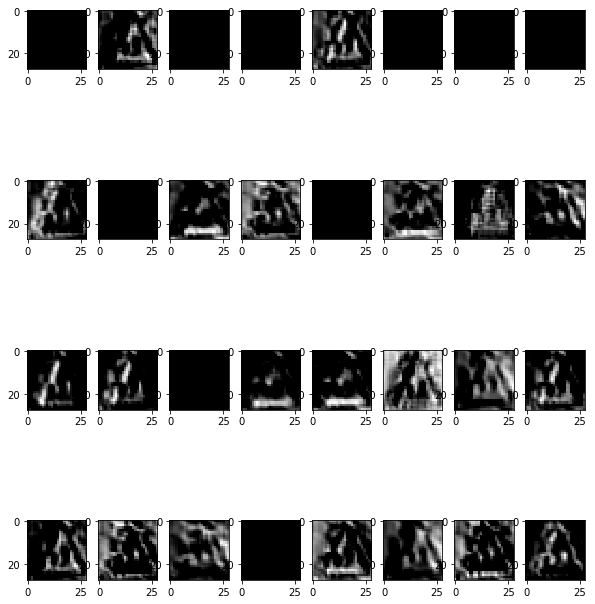

Multiple kernel activations starting from 0


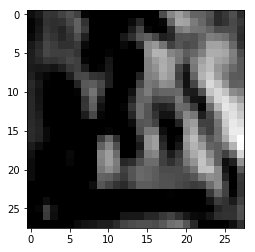

Activation for 22 kernel in 3 layer.


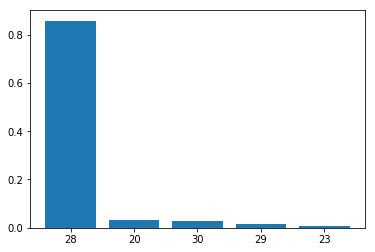

Probabilities of top 5 classes.


In [0]:
idx = 7210
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 34
Predicted class 34
Actual training image


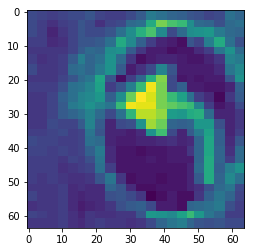

The kernel which activates/recognizes the shape: 1


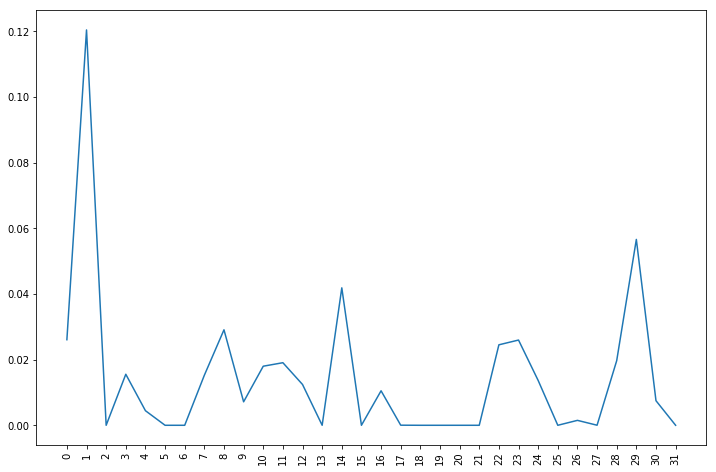

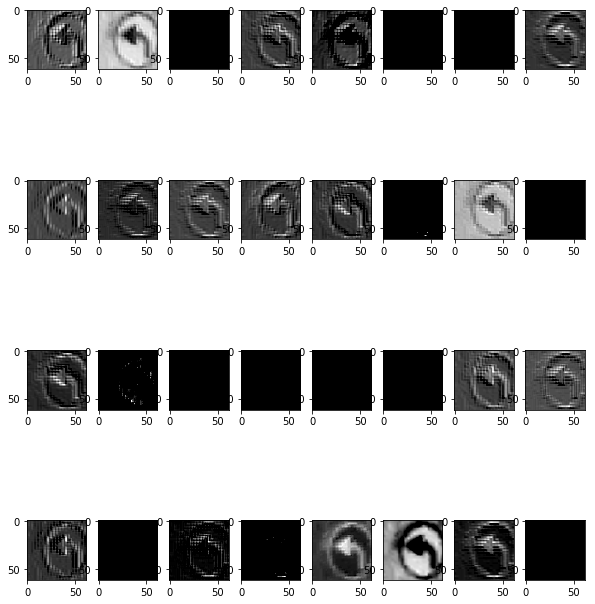

Multiple kernel activations starting from 0


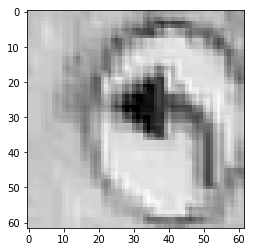

Activation for 1 kernel in 0 layer.


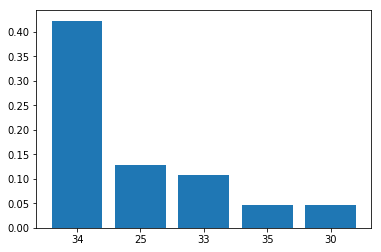

Probabilities of top 5 classes.
Actual class it belongs to: 34
Predicted class 34
Actual training image


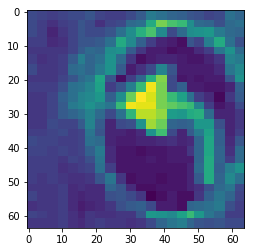

The kernel which activates/recognizes the shape: 53


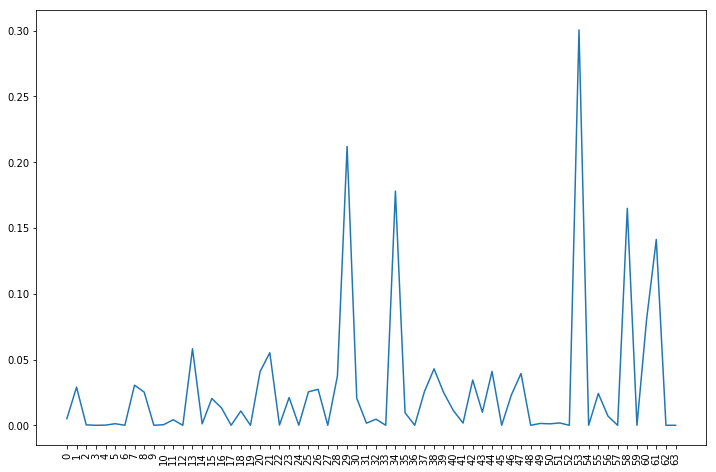

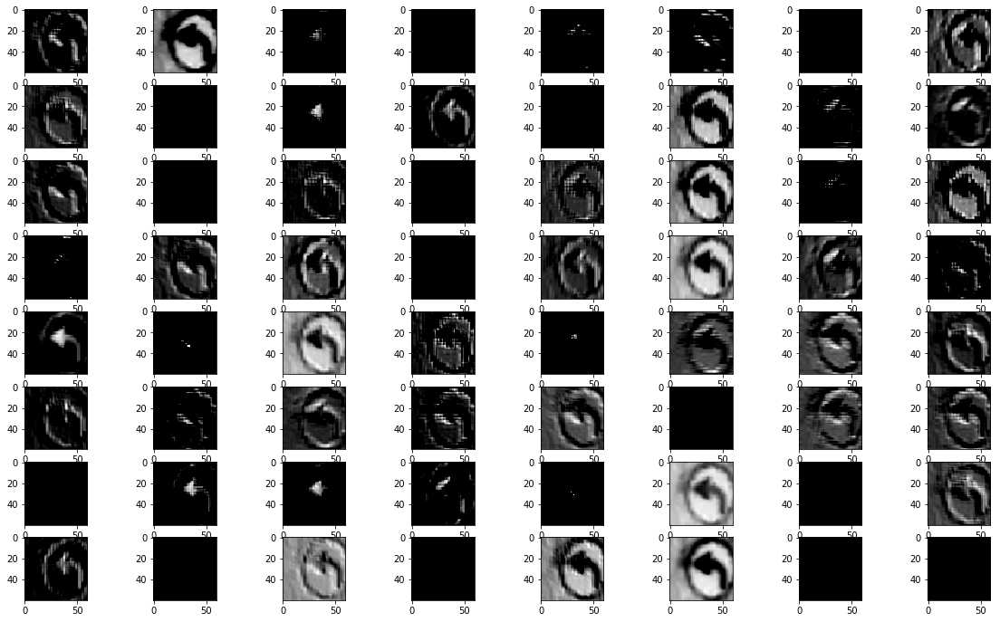

Multiple kernel activations starting from 0


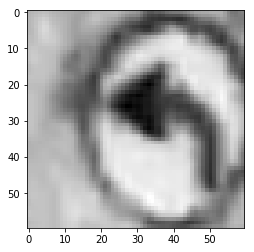

Activation for 53 kernel in 1 layer.


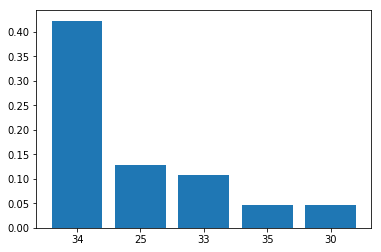

Probabilities of top 5 classes.
Actual class it belongs to: 34
Predicted class 34
Actual training image


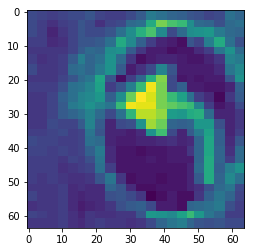

The kernel which activates/recognizes the shape: 11


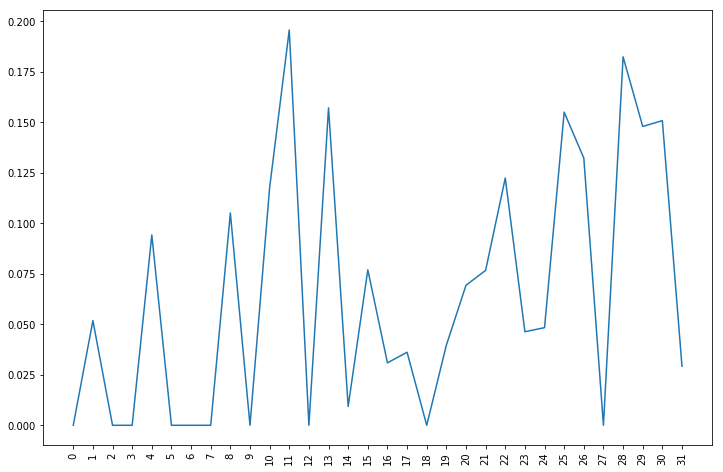

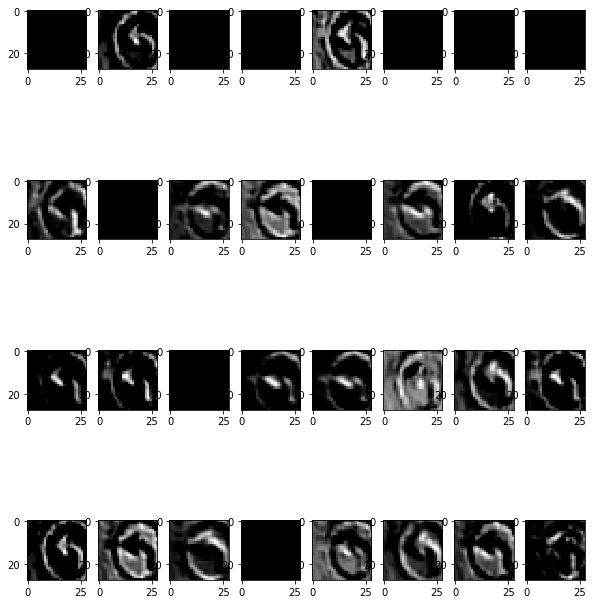

Multiple kernel activations starting from 0


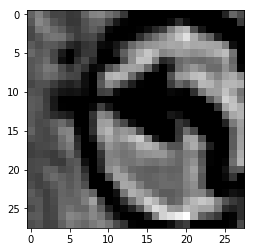

Activation for 11 kernel in 3 layer.


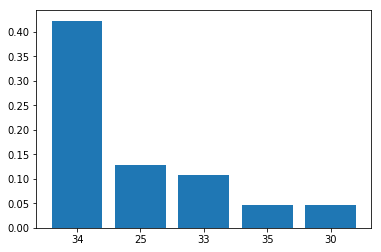

Probabilities of top 5 classes.


In [0]:
idx = 572
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

Actual class it belongs to: 40
Predicted class 2
Actual training image


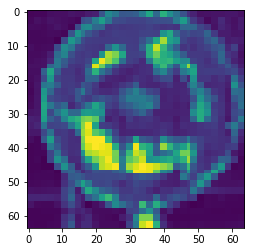

The kernel which activates/recognizes the shape: 28


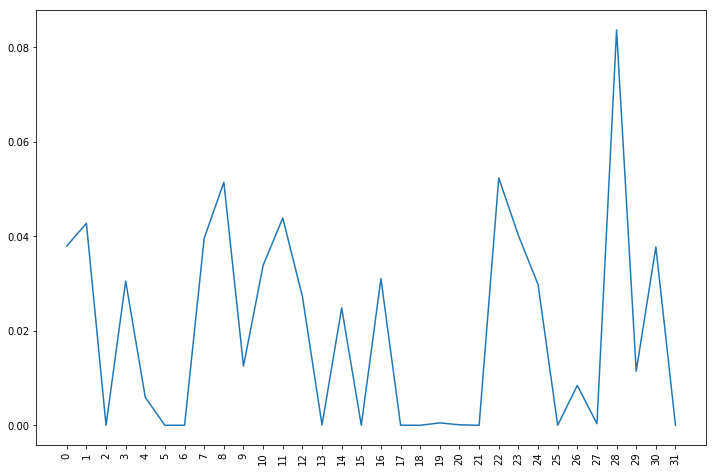

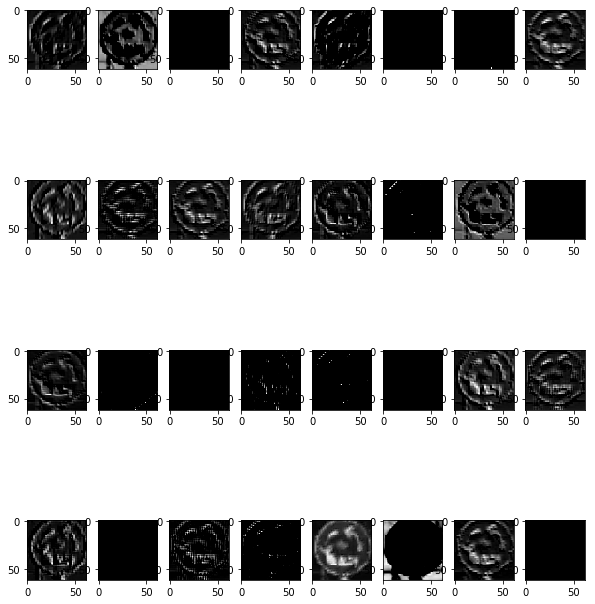

Multiple kernel activations starting from 0


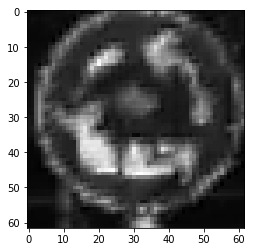

Activation for 28 kernel in 0 layer.


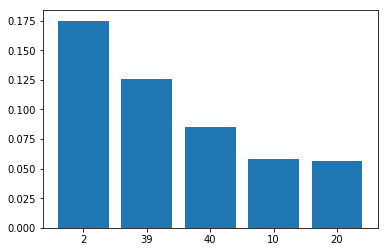

Probabilities of top 5 classes.
Actual class it belongs to: 40
Predicted class 2
Actual training image


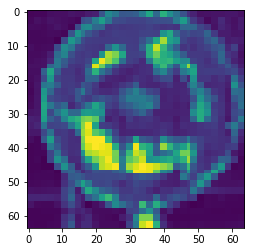

The kernel which activates/recognizes the shape: 53


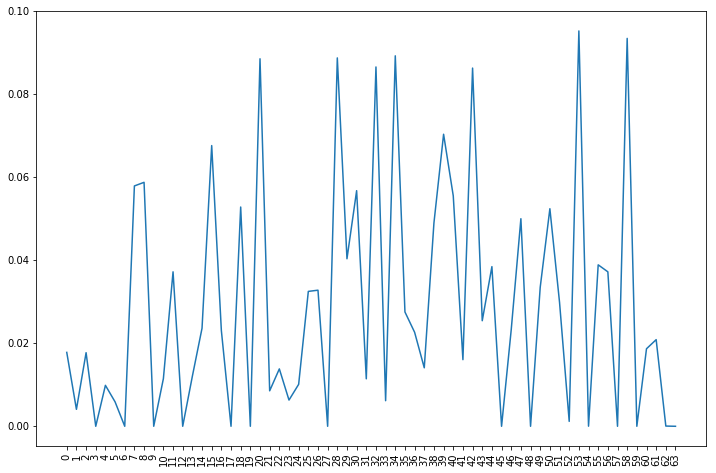

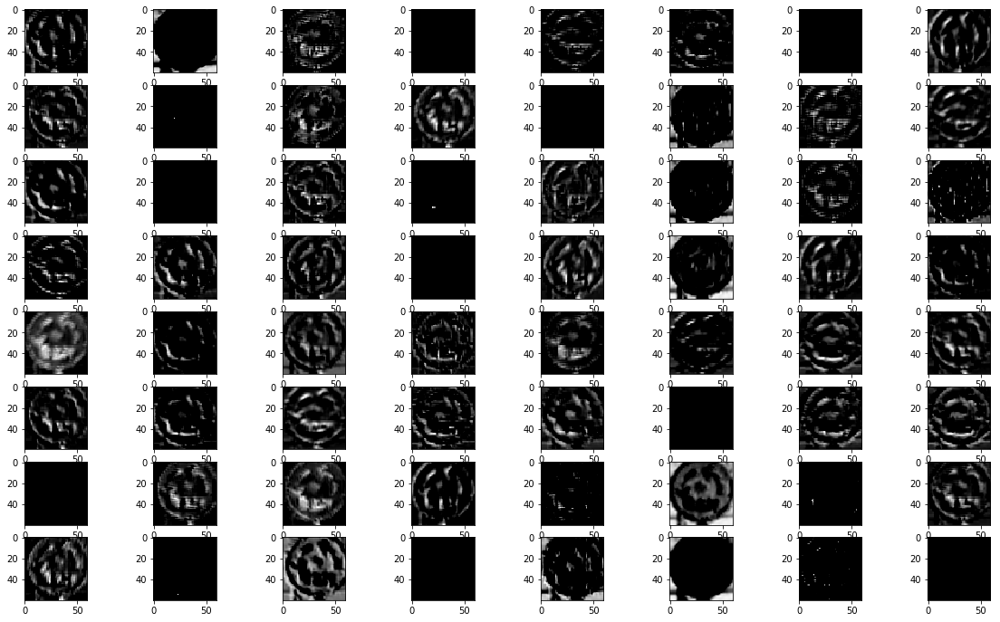

Multiple kernel activations starting from 0


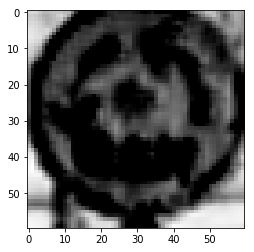

Activation for 53 kernel in 1 layer.


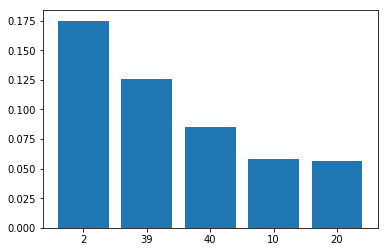

Probabilities of top 5 classes.
Actual class it belongs to: 40
Predicted class 2
Actual training image


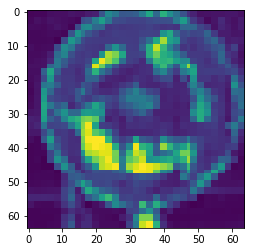

The kernel which activates/recognizes the shape: 31


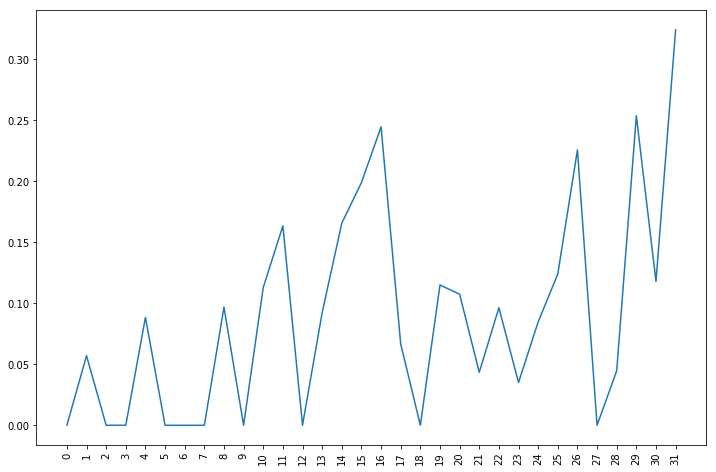

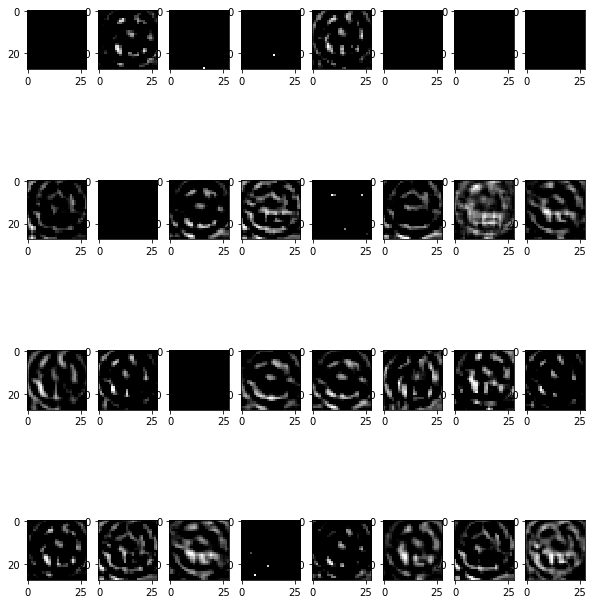

Multiple kernel activations starting from 0


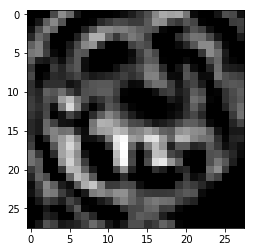

Activation for 31 kernel in 3 layer.


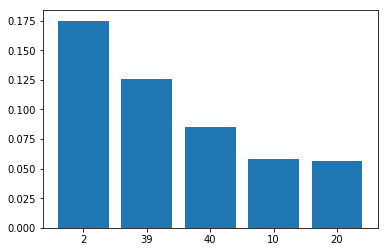

Probabilities of top 5 classes.


In [0]:
idx = 151
activations = activation_model.predict(x_test[idx].reshape(1, 64, 64, 1))
call_utilities_features(idx, activations, 8, 4, 0, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 8, 1, y_true, y_prediction)
call_utilities_features(idx, activations, 8, 4, 3, y_true, y_prediction)

In [0]:
actual_class = []
index_image = []
predicted_class = []
for idx, im in enumerate(y_true):
    if im != np.argmax(y_prediction[idx]):
        actual_class.append(im)
        predicted_class.append(np.argmax(y_prediction[idx]))
        index_image.append(idx)
np.array(index_image)

array([   41,    80,   151,   163,   592,   621,   657,   696,   836,
         981,  1009,  1053,  1097,  1148,  1193,  1204,  1210,  1314,
        1326,  1391,  1395,  1485,  1500,  1720,  1748,  1750,  1755,
        1769,  1840,  1852,  1880,  1915,  1926,  1993,  2165,  2290,
        2361,  2465,  2516,  2873,  2895,  2917,  2925,  2963,  2970,
        2978,  3055,  3450,  3510,  3592,  3669,  3909,  3950,  3962,
        4083,  4123,  4157,  4162,  4316,  4475,  4743,  4921,  4926,
        5051,  5089,  5240,  5491,  5607,  5666,  5734,  5755,  5818,
        6102,  6166,  6175,  6384,  6446,  6464,  6795,  6806,  6867,
        6985,  6995,  7156,  7269,  7358,  7377,  7378,  7423,  7481,
        7520,  7521,  7570,  7626,  7678,  7725,  7796,  7870,  7871,
        7914,  8047,  8200,  8207,  8218,  8346,  8348,  8412,  8466,
        8492,  8510,  8542,  8569,  8578,  8598,  8675,  8723,  8735,
        8739,  8767,  8970,  9518,  9749,  9771,  9873,  9973, 10073,
       10098, 10125,

### [5.7] RetinaNet - Installation and training

In [0]:
!git clone https://github.com/fizyr/keras-retinanet.git

Cloning into 'keras-retinanet'...
remote: Enumerating objects: 4750, done.
remote: Total 4750 (delta 0), reused 0 (delta 0), pack-reused 4750
Receiving objects: 100% (4750/4750), 13.04 MiB | 5.66 MiB/s, done.
Resolving deltas: 100% (3165/3165), done.


In [0]:
!pip install keras-retinanet/

Processing ./keras-retinanet
  Stored in directory: /root/.cache/pip/wheels/b2/9f/57/cb0305f6f5a41fc3c11ad67b8cedfbe9127775b563337827ba
  Stored in directory: /root/.cache/pip/wheels/5f/09/a5/497a30fd9ad9964e98a1254d1e164bcd1b8a5eda36197ecb3c
Successfully built keras-retinanet keras-resnet


In [0]:
import keras_retinanet

In [0]:
model = keras_retinanet.models.backbone('resnet50').retinanet(num_classes=43)

In [0]:
df.head()

,Filename,Width,Height,Roi.X1,Roi.Y1,Roi.X2,Roi.Y2,ClassId
0,9_00000_00000.ppm,34,33,6,5,29,28,9
1,9_00000_00001.ppm,34,34,6,6,29,29,9
2,9_00000_00002.ppm,35,34,6,5,30,29,9
3,9_00000_00003.ppm,35,35,5,5,30,30,9
4,9_00000_00004.ppm,36,36,6,6,31,31,9


In [0]:
# this code snippet contains code for ppm to jpg conversion
# and resizing the image 
!mkdir jpg_data
for idx, row in tqdm(df.iterrows(), total=df.shape[0]):
    im = Image.open('data/'+row['Filename'])
    im.save('jpg_data/'+row['Filename'].split(".")[0]+".jpg", format='jpeg')
!ls jpg_data

100%|██████████| 39209/39209 [00:21<00:00, 1862.15it/s]


0_00000_00000.jpg   13_00064_00023.jpg	25_00037_00016.jpg  38_00066_00010.jpg
0_00000_00001.jpg   13_00064_00024.jpg	25_00037_00017.jpg  38_00066_00011.jpg
0_00000_00002.jpg   13_00064_00025.jpg	25_00037_00018.jpg  38_00066_00012.jpg
0_00000_00003.jpg   13_00064_00026.jpg	25_00037_00019.jpg  38_00066_00013.jpg
0_00000_00004.jpg   13_00064_00027.jpg	25_00037_00020.jpg  38_00066_00014.jpg
0_00000_00005.jpg   13_00064_00028.jpg	25_00037_00021.jpg  38_00066_00015.jpg
0_00000_00006.jpg   13_00064_00029.jpg	25_00037_00022.jpg  38_00066_00016.jpg
0_00000_00007.jpg   13_00065_00000.jpg	25_00037_00023.jpg  38_00066_00017.jpg
0_00000_00008.jpg   13_00065_00001.jpg	25_00037_00024.jpg  38_00066_00018.jpg
0_00000_00009.jpg   13_00065_00002.jpg	25_00037_00025.jpg  38_00066_00019.jpg
0_00000_00010.jpg   13_00065_00003.jpg	25_00037_00026.jpg  38_00066_00020.jpg
0_00000_00011.jpg   13_00065_00004.jpg	25_00037_00027.jpg  38_00066_00021.jpg
0_00000_00012.jpg   13_00065_00005.jpg	25_00037_00028.jpg  38_00

In [0]:
tqdm.pandas(desc='filename_rename')
df['Filename'] = df['Filename'].progress_apply(lambda x: '/content/jpg_data/'+str(x))
df['Filename'] = df['Filename'].progress_apply(lambda x: x.split(".")[0]+".jpg")

filename_rename: 100%|██████████| 39209/39209 [00:00<00:00, 569223.86it/s]


In [0]:
df.head()

,Filename,Width,Height,Roi.X1,Roi.Y1,Roi.X2,Roi.Y2,ClassId
0,/content/jpg_data/9_00000_00000.jpg,34,33,6,5,29,28,9
1,/content/jpg_data/9_00000_00001.jpg,34,34,6,6,29,29,9
2,/content/jpg_data/9_00000_00002.jpg,35,34,6,5,30,29,9
3,/content/jpg_data/9_00000_00003.jpg,35,35,5,5,30,30,9
4,/content/jpg_data/9_00000_00004.jpg,36,36,6,6,31,31,9


In [0]:
data =  df[['Filename', 'Roi.X1', 'Roi.Y1', 'Roi.X2', 'Roi.Y2', 'ClassId']].rename(columns={"Roi.X1":"x1", 'Roi.Y1':'y1', 'Roi.X2':'x2', 'Roi.Y2':'y2'})
data.head()

,Filename,x1,y1,x2,y2,ClassId
0,/content/jpg_data/9_00000_00000.jpg,6,5,29,28,9
1,/content/jpg_data/9_00000_00001.jpg,6,6,29,29,9
2,/content/jpg_data/9_00000_00002.jpg,6,5,30,29,9
3,/content/jpg_data/9_00000_00003.jpg,5,5,30,30,9
4,/content/jpg_data/9_00000_00004.jpg,6,6,31,31,9


In [0]:
mapping_df = pd.DataFrame({'class_id':[i for i in range(43)], 'id':[i for i in range(43)]})
mapping_df.head()

,class_id,id
0,0,0
1,1,1
2,2,2
3,3,3
4,4,4


In [0]:
x_train, x_test, y_train, y_test = train_test_split(data, data['ClassId'], stratify=data['ClassId'], test_size=0.20, random_state=42)
x_train.shape, x_test.shape

((31367, 6), (7842, 6))

In [0]:
x_train.to_csv("train.csv", index=False, header=False)
x_test.to_csv("test.csv", index=False, header=False)
mapping_df.to_csv("mapping.csv", index=False, header=False)

In [0]:
x_train.head()

,Filename,x1,y1,x2,y2,ClassId
21917,/content/jpg_data/12_00031_00018.jpg,5,5,51,51,12
15750,/content/jpg_data/5_00031_00001.jpg,6,5,22,23,5
23067,/content/jpg_data/12_00069_00028.jpg,8,9,84,86,12
30291,/content/jpg_data/13_00052_00022.jpg,6,5,54,48,13
38543,/content/jpg_data/18_00017_00024.jpg,6,5,59,53,18


In [0]:
!nvidia-smi

Thu Jun 27 06:14:58 2019       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 418.67       Driver Version: 410.79       CUDA Version: 10.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P0    31W /  70W |   2635MiB / 15079MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
                                                                               
+-----------------------------------------------------------------------------+
| Processes:                                                       GPU Memory |
|  GPU  

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
!ls /content/drive/My\ Drive/retinanet_model

resnet50_csv_04_new.h5	resnet50_csv_10_naya.h5
resnet50_csv_05_new.h5	resnet50_csv_12_latest.h5


### Notes:
1. Training was performed in three phases because colab terminates session.
2. Training was stopped after 12th epoch because there was not much improvement in regression loss (improved only by 0.0012) and in classification loss (improved only by 0.0049).

In [0]:
!retinanet-train --epochs 5 csv /content/train.csv /content/mapping.csv

Using TensorFlow backend.
W0618 06:52:55.301011 140596749281152 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:66: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0618 06:52:55.301325 140596749281152 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:68: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

2019-06-18 06:52:55.317231: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2300000000 Hz
2019-06-18 06:52:55.317491: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x18a0840 executing computations on platform Host. Devices:
2019-06-18 06:52:55.317536: I tensorflow/compiler/xla/service/service.cc:175]   StreamExecutor device (0): <undefined>, <undefined>
2019-06-18 06:52:55.319916: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library l

In [0]:
!cp /content/drive/My\ Drive/retinanet_model/resnet50_csv_10_naya.h5 /content/

In [0]:
!ls

data				   images	    resnet50_csv_10_naya.h5
drive				   jpg_data	    sample_data
GTSRB_Final_Training_Images.zip    keras-retinanet  test.csv
GTSRB_Final_Training_Images.zip.1  mapping.csv	    train.csv


In [0]:
!retinanet-train --epochs 5 --weights /content/resnet50_csv_05_new.h5 csv /content/train.csv /content/mapping.csv

Using TensorFlow backend.
W0620 04:02:20.347955 139847697983360 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:66: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0620 04:02:20.348261 139847697983360 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:68: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

2019-06-20 04:02:20.398283: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2300000000 Hz
2019-06-20 04:02:20.400691: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x26e0840 executing computations on platform Host. Devices:
2019-06-20 04:02:20.400782: I tensorflow/compiler/xla/service/service.cc:175]   StreamExecutor device (0): <undefined>, <undefined>
2019-06-20 04:02:20.409916: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library l

In [0]:
!retinanet-train --epochs 2 --weights /content/resnet50_csv_10_naya.h5 csv /content/train.csv /content/mapping.csv

Using TensorFlow backend.
W0621 04:42:18.014223 140293684475776 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:66: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0621 04:42:18.014537 140293684475776 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/train.py:68: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

2019-06-21 04:42:18.072847: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2300000000 Hz
2019-06-21 04:42:18.076454: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x1b80840 executing computations on platform Host. Devices:
2019-06-21 04:42:18.076495: I tensorflow/compiler/xla/service/service.cc:175]   StreamExecutor device (0): <undefined>, <undefined>
2019-06-21 04:42:18.086039: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened dynamic library l

In [0]:
!cp /content/snapshots/resnet50_csv_02.h5 /content/drive/My\ Drive/retinanet_model/resnet50_csv_12_latest.h5 

In [0]:
!cp /content/drive/My\ Drive/retinanet_model/resnet50_csv_12_latest.h5 /content/resnet50_csv_12_latest.h5

In [0]:
# import keras_retinanet
from keras_retinanet import models
from keras_retinanet.utils.image import read_image_bgr, preprocess_image, resize_image
from keras_retinanet.utils.visualization import draw_box, draw_caption
from keras_retinanet.utils.colors import label_color
import os
import cv2
import time
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
import tensorflow as tf
import keras
def get_session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    return tf.Session(config=config)

Using TensorFlow backend.


In [0]:
keras.backend.tensorflow_backend.set_session(get_session())

In [0]:
!retinanet-convert-model /content/resnet50_csv_12_latest.h5 /content/resnet50_csv_12_latest.h5

Using TensorFlow backend.
W0627 06:13:18.629806 140357621602176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/convert_model.py:40: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0627 06:13:18.630151 140357621602176 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/bin/convert_model.py:42: The name tf.Session is deprecated. Please use tf.compat.v1.Session instead.

2019-06-27 06:13:18.653743: I tensorflow/core/platform/profile_utils/cpu_utils.cc:94] CPU Frequency: 2300000000 Hz
2019-06-27 06:13:18.654031: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x1a0d2c0 executing computations on platform Host. Devices:
2019-06-27 06:13:18.654072: I tensorflow/compiler/xla/service/service.cc:175]   StreamExecutor device (0): <undefined>, <undefined>
2019-06-27 06:13:18.670721: I tensorflow/stream_executor/platform/default/dso_loader.cc:42] Successfully opened d

In [0]:
# model_path = os.path.join('/content', 'resnet50_csv_20_converted.h5')
# load retinanet model
model = models.load_model('/content/resnet50_csv_12_latest.h5', backbone_name='resnet50')

W0627 06:13:54.958691 140709411673984 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:1919: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm instead.

W0627 06:13:56.000060 140709411673984 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras_retinanet/backend/tensorflow_backend.py:68: The name tf.image.resize_images is deprecated. Please use tf.image.resize instead.



In [0]:
labels_to_names = {i:i for i in range(43)}
labels_to_names

{0: 0,
 1: 1,
 2: 2,
 3: 3,
 4: 4,
 5: 5,
 6: 6,
 7: 7,
 8: 8,
 9: 9,
 10: 10,
 11: 11,
 12: 12,
 13: 13,
 14: 14,
 15: 15,
 16: 16,
 17: 17,
 18: 18,
 19: 19,
 20: 20,
 21: 21,
 22: 22,
 23: 23,
 24: 24,
 25: 25,
 26: 26,
 27: 27,
 28: 28,
 29: 29,
 30: 30,
 31: 31,
 32: 32,
 33: 33,
 34: 34,
 35: 35,
 36: 36,
 37: 37,
 38: 38,
 39: 39,
 40: 40,
 41: 41,
 42: 42}

processing time:  0.3018159866333008
Label: 25


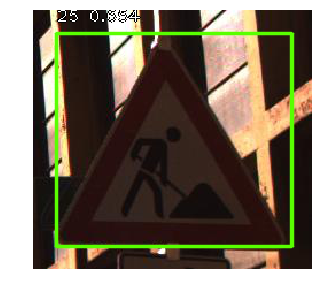

In [0]:
# load image
image = read_image_bgr('/content/jpg_data/25_00003_00029.jpg')

# copy to draw on
draw = image.copy()
draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

# preprocess image for network
image = preprocess_image(image)
image, scale = resize_image(image)

# process image
start = time.time()
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
print("processing time: ", time.time() - start)

# correct for image scale
boxes /= scale
# print(boxes[0], scores[0], labels[0])
# visualize detections
for box, score, label in zip(boxes[0], scores[0], labels[0]):
    # scores are sorted so we can break
    if score < 0.6:
        break
        
    color = label_color(label)
    print("Label:", labels_to_names[label])
    b = box.astype(int)
    draw_box(draw, b, color=color)
    
    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(draw, b, caption)
    
plt.figure(figsize=(5, 5))
plt.axis('off')
plt.imshow(draw)
plt.show()

processing time:  0.3089919090270996
Label: 18


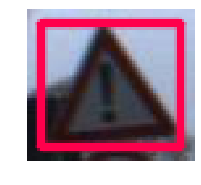

In [0]:
# load image
image = read_image_bgr('/content/jpg_data/18_00017_00024.jpg')

# copy to draw on
draw = image.copy()
draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

# preprocess image for network
image = preprocess_image(image)
image, scale = resize_image(image)

# process image
start = time.time()
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
print("processing time: ", time.time() - start)

# correct for image scale
boxes /= scale
# print(boxes[0], scores[0], labels[0])
# visualize detections
for box, score, label in zip(boxes[0], scores[0], labels[0]):
    # scores are sorted so we can break
    if score < 0.6:
        break
        
    color = label_color(label)
    print("Label:", labels_to_names[label])
    b = box.astype(int)
    draw_box(draw, b, color=color)
    
    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(draw, b, caption)
    
plt.figure(figsize=(3, 3))
plt.axis('off')
plt.imshow(draw)
plt.show()

processing time:  0.30597877502441406
Label: 12


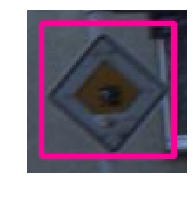

In [0]:
# load image
image = read_image_bgr('/content/jpg_data/12_00069_00028.jpg')

# copy to draw on
draw = image.copy()
draw = cv2.cvtColor(draw, cv2.COLOR_BGR2RGB)

# preprocess image for network
image = preprocess_image(image)
image, scale = resize_image(image)

# process image
start = time.time()
boxes, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
print("processing time: ", time.time() - start)

# correct for image scale
boxes /= scale
# print(boxes[0], scores[0], labels[0])
# visualize detections
for box, score, label in zip(boxes[0], scores[0], labels[0]):
    # scores are sorted so we can break
    if score < 0.7:
        break
        
    color = label_color(label)
    print("Label:", labels_to_names[label])
    b = box.astype(int)
    draw_box(draw, b, color=color)
    
    caption = "{} {:.3f}".format(labels_to_names[label], score)
    draw_caption(draw, b, caption)
    
plt.figure(figsize=(3, 3))
plt.axis('off')
plt.imshow(draw)
plt.show()

In [0]:
x_test.head()

,Filename,x1,y1,x2,y2,ClassId
37876,/content/jpg_data/28_00013_00017.jpg,6,6,61,60,28
36808,/content/jpg_data/2_00066_00029.jpg,5,5,42,44,2
13802,/content/jpg_data/1_00040_00003.jpg,5,6,29,33,1
32726,/content/jpg_data/25_00011_00027.jpg,12,15,134,150,25
10910,/content/jpg_data/38_00060_00021.jpg,5,6,41,47,38


In [0]:
y_test = x_test['ClassId'].values.tolist()
len(y_test)

7842

In [0]:
y_pred = []
for img in tqdm(x_test['Filename'].values, total=x_test.shape[0]):
    # load image
    image = read_image_bgr(img)

    # preprocess image for network
    image = preprocess_image(image)
    image, scale = resize_image(image)

    # process image
#     start = time.time()
    _, scores, labels = model.predict_on_batch(np.expand_dims(image, axis=0))
    y_pred.append(labels[0][np.argmax(scores[0])])

100%|██████████| 7842/7842 [20:04<00:00,  7.94it/s]


------------------------------------------------------
Macro F1 score 0.9137298711811357
------------------------------------------------------


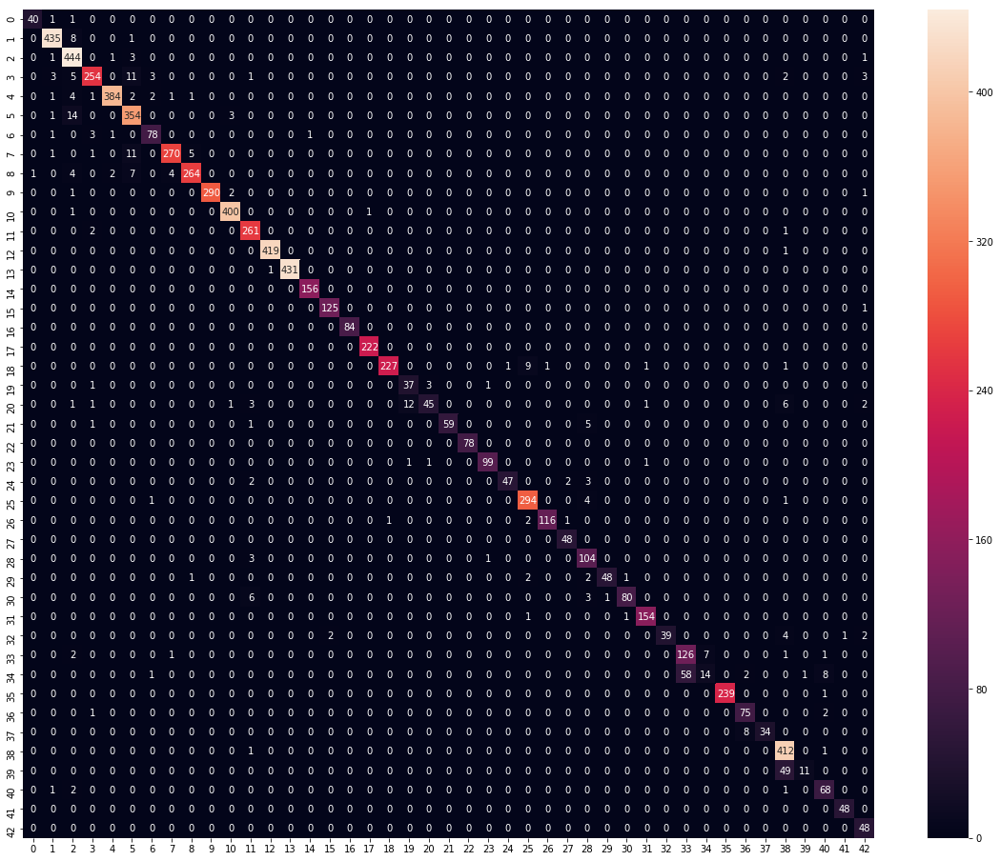

In [0]:
plt.figure(figsize=(20,16))
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_test, y_pred, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_test, y_pred) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

### [5.8] Pretrained Model - VGG16

In [10]:
# we extract features from each image in ndarray format
labels = []
img_feats_grey = []
for img in tqdm(os.listdir('cropped_data')):
        im = Image.open('cropped_data/'+img)
        img_feats_grey.append(np.array(im))
        labels.append(int(img.split("_")[0]))
img_feats_grey = np.array(img_feats_grey)
img_feats_grey.shape, len(labels)

100%|██████████| 39209/39209 [00:03<00:00, 11467.76it/s]


((39209, 64, 64, 3), 39209)

In [11]:
x_train, x_test, y_train, y_test = train_test_split(img_feats_grey, labels, test_size=0.3, random_state=42)
x_train.shape, len(y_train)

((27446, 64, 64, 3), 27446)

In [12]:
batch_size = 128
num_classes = 43

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
# convert class vectors to binary class matrices
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)
# x_train = x_train.reshape(x_train.shape[0], 64, 64, 1)
# x_test = x_test.reshape(x_test.shape[0], 64, 64, 1)
x_train.shape, len(y_train)

((27446, 64, 64, 3), 27446)

In [0]:
from keras import applications
from keras.layers import Input

In [0]:
input_tensor = Input(shape=(64, 64, 3))
base_model = applications.VGG16(
    weights='imagenet', include_top=False, input_tensor=input_tensor
)
x = base_model.output
x = Flatten()(x)
x = Dense(1024, activation='relu')(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x) 
preds = Dense(43, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=preds)
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         (None, 64, 64, 3)         0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 64, 64, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 64, 64, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 32, 32, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 32, 32, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 32, 32, 128)       147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 16, 16, 128)       0         
__________

In [0]:
epochs = 15
batch_size = 128
model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer='adam', metrics=['accuracy']
)

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

Train on 27446 samples, validate on 11763 samples
Epoch 1/15
27446/27446 [==============================] - 45s 2ms/step - loss: 3.1141 - acc: 0.1387 - val_loss: 2.2633 - val_acc: 0.2789
Epoch 2/15
27446/27446 [==============================] - 41s 1ms/step - loss: 1.1526 - acc: 0.6111 - val_loss: 0.5667 - val_acc: 0.7958
Epoch 3/15
27446/27446 [==============================] - 40s 1ms/step - loss: 0.3536 - acc: 0.8861 - val_loss: 0.2215 - val_acc: 0.9328
Epoch 4/15
27446/27446 [==============================] - 41s 1ms/step - loss: 0.2013 - acc: 0.9416 - val_loss: 0.1161 - val_acc: 0.9679
Epoch 5/15
27446/27446 [==============================] - 40s 1ms/step - loss: 0.1062 - acc: 0.9701 - val_loss: 0.0964 - val_acc: 0.9724
Epoch 6/15
27446/27446 [==============================] - 40s 1ms/step - loss: 0.1141 - acc: 0.9708 - val_loss: 0.0999 - val_acc: 0.9748
Epoch 7/15
27446/27446 [==============================] - 40s 1ms/step - loss: 0.0790 - acc: 0.9809 - val_loss: 0.1270 - val_acc

Test loss: 0.14245834784402964
Test accuracy: 0.9742412649834226


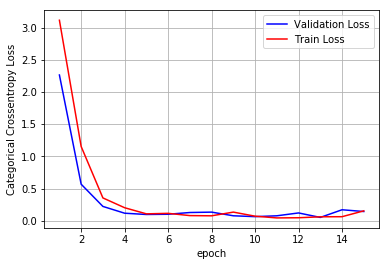

In [0]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9636527764362784
------------------------------------------------------


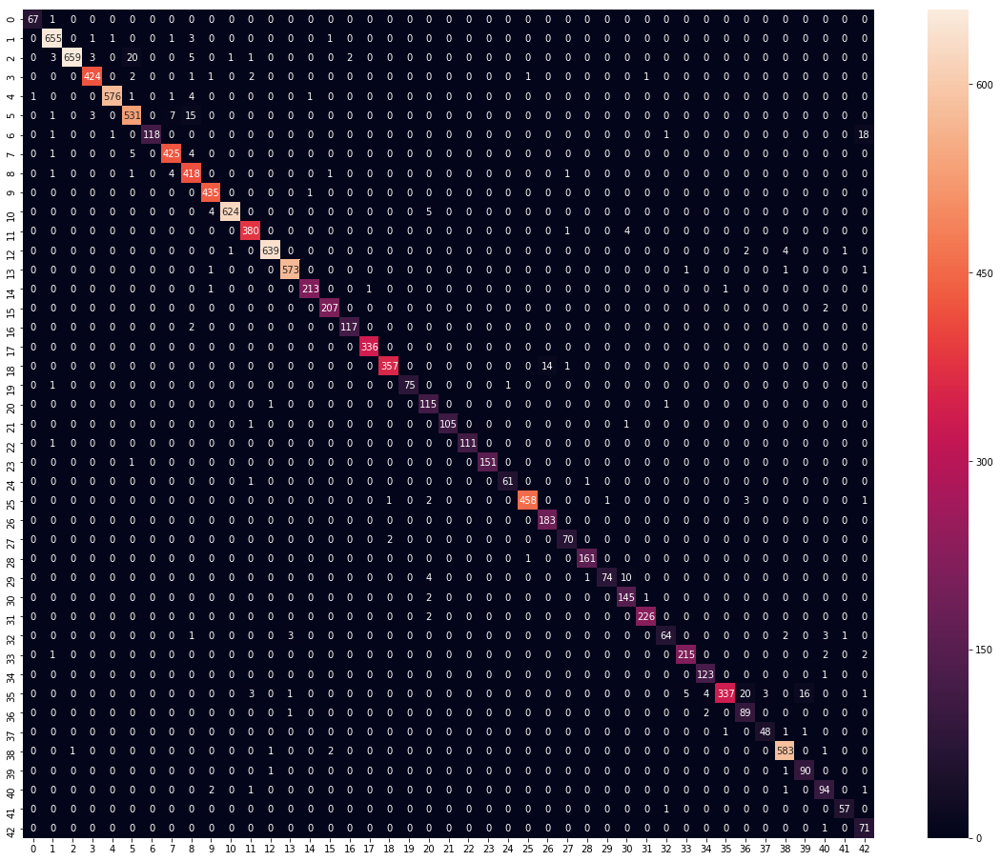

In [0]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

### [5.9] Pretrained model - Inception

In [0]:
from keras.applications.inception_v3 import InceptionV3

In [18]:
# this code snippet contains code for cropping the images based on coordinates
# and resizing the image 
!mkdir cropped_data
for idx, row in tqdm(df.iterrows(), total=df.shape[0]):
    im = Image.open('data/'+row['Filename'])
    im_crop = im.crop((row['Roi.X1'], row['Roi.Y1'], row['Roi.X2'], row['Roi.Y2']))
    im_resize = im_crop.resize((75, 75))
    im_resize.save('cropped_data/'+row['Filename'])

mkdir: cannot create directory ‘cropped_data’: File exists


100%|██████████| 39209/39209 [00:21<00:00, 1790.68it/s]


In [19]:
# we extract features from each image in ndarray format
labels = []
img_feats_grey = []
for img in tqdm(os.listdir('cropped_data')):
        im = Image.open('cropped_data/'+img)
        img_feats_grey.append(np.array(im))
        labels.append(int(img.split("_")[0]))
img_feats_grey = np.array(img_feats_grey)
img_feats_grey.shape, len(labels)

100%|██████████| 39209/39209 [00:04<00:00, 9766.35it/s]


((39209, 75, 75, 3), 39209)

In [20]:
x_train, x_test, y_train, y_test = train_test_split(img_feats_grey, labels, test_size=0.3, random_state=42)
x_train.shape, len(y_train)

((27446, 75, 75, 3), 27446)

In [21]:
batch_size = 128
num_classes = 43

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')
x_train /= 255
x_test /= 255
# convert class vectors to binary class matrices
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)
# x_train = x_train.reshape(x_train.shape[0], 64, 64, 1)
# x_test = x_test.reshape(x_test.shape[0], 64, 64, 1)
x_train.shape, len(y_train)

((27446, 75, 75, 3), 27446)

In [22]:
input_tensor = Input(shape=(75, 75, 3))
base_model = InceptionV3(
    weights='imagenet', include_top=False, input_tensor=input_tensor
)

87916544/87910968 [==============================] - 1s 0us/step


In [23]:
x = base_model.output
x = Flatten()(x)
x = Dense(1024, activation='relu')(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x) 
preds = Dense(43, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=preds)
model.summary()

W0629 10:39:54.360414 139698426890112 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 75, 75, 3)    0                                            
__________________________________________________________________________________________________
conv2d_145 (Conv2D)             (None, 37, 37, 32)   864         input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_143 (BatchN (None, 37, 37, 32)   96          conv2d_145[0][0]                 
__________________________________________________________________________________________________
activation_143 (Activation)     (None, 37, 37, 32)   0           batch_normalization_143[0][0]    
__________________________________________________________________________________________________
conv2d_146

In [24]:
epochs = 15
batch_size = 128
model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer='adam', metrics=['accuracy']
)

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

W0629 10:40:57.141192 139698426890112 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0629 10:40:57.322298 139698426890112 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/math_grad.py:1250: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a future version.
Instructions for updating:
Use tf.where in 2.0, which has the same broadcast rule as np.where


Train on 27446 samples, validate on 11763 samples
Epoch 1/15
27446/27446 [==============================] - 57s 2ms/step - loss: 0.8105 - acc: 0.7692 - val_loss: 0.3591 - val_acc: 0.9241
Epoch 2/15
27446/27446 [==============================] - 35s 1ms/step - loss: 0.1237 - acc: 0.9699 - val_loss: 0.5636 - val_acc: 0.9299
Epoch 3/15
27446/27446 [==============================] - 35s 1ms/step - loss: 0.0710 - acc: 0.9858 - val_loss: 0.0654 - val_acc: 0.9810
Epoch 4/15
27446/27446 [==============================] - 35s 1ms/step - loss: 0.5060 - acc: 0.8891 - val_loss: 5.2001 - val_acc: 0.3032
Epoch 5/15
27446/27446 [==============================] - 34s 1ms/step - loss: 0.6522 - acc: 0.8618 - val_loss: 12.8533 - val_acc: 0.0748
Epoch 6/15
27446/27446 [==============================] - 34s 1ms/step - loss: 0.1772 - acc: 0.9613 - val_loss: 0.0463 - val_acc: 0.9887
Epoch 7/15
27446/27446 [==============================] - 34s 1ms/step - loss: 0.1938 - acc: 0.9715 - val_loss: 0.1126 - val_ac

Test loss: 0.04822152521887046
Test accuracy: 0.9880982742497663


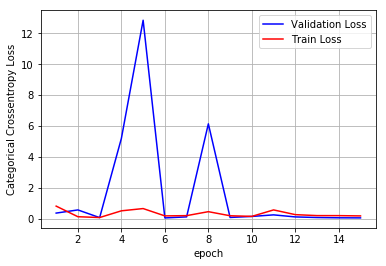

In [28]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9863473241729825
------------------------------------------------------


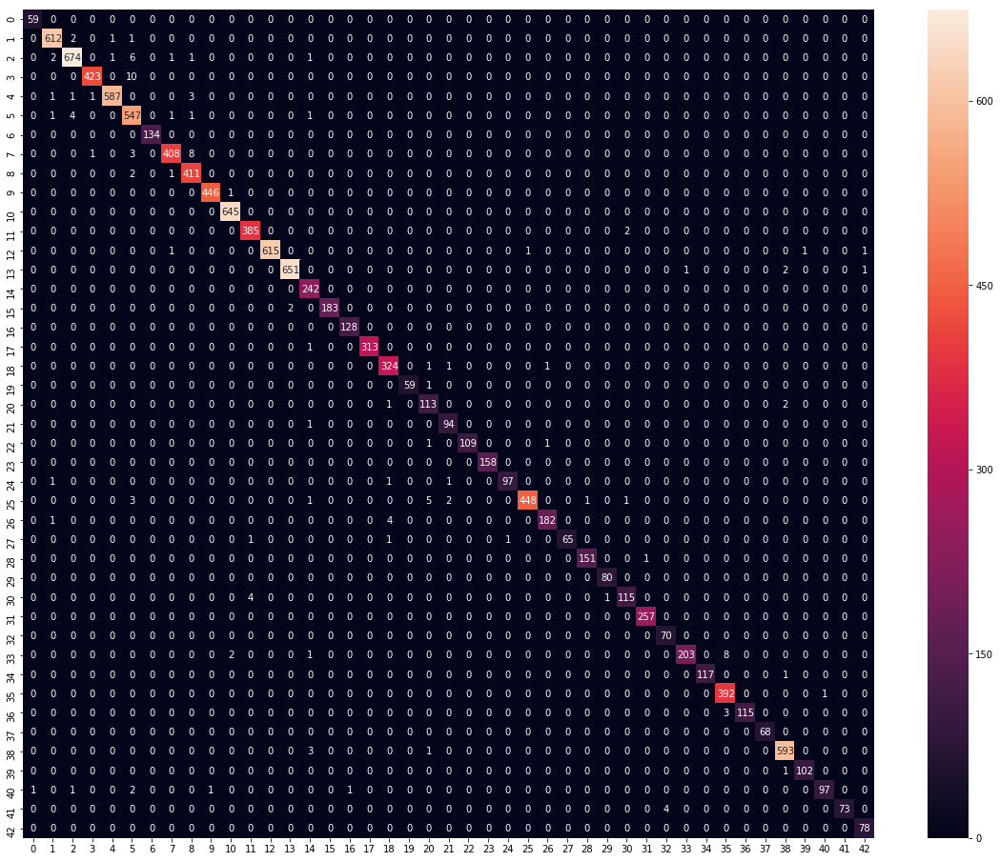

In [29]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [57]:
input_tensor = Input(shape=(75, 75, 3))
base_model = InceptionV3(
    weights='imagenet', include_top=False, input_tensor=input_tensor
)
x = base_model.output
x = Flatten()(x)
x = Dense(2048, activation='relu')(x)
x = Dense(1024, activation='relu')(x) # changed this
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x) 
preds = Dense(43, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=preds)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_12 (InputLayer)           (None, 75, 75, 3)    0                                            
__________________________________________________________________________________________________
conv2d_427 (Conv2D)             (None, 37, 37, 32)   864         input_12[0][0]                   
__________________________________________________________________________________________________
batch_normalization_425 (BatchN (None, 37, 37, 32)   96          conv2d_427[0][0]                 
__________________________________________________________________________________________________
activation_572 (Activation)     (None, 37, 37, 32)   0           batch_normalization_425[0][0]    
__________________________________________________________________________________________________
conv2d_428

In [58]:
epochs = 30
batch_size = 128
model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer='adam', metrics=['accuracy']
)

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

Train on 27446 samples, validate on 11763 samples
Epoch 1/30
27446/27446 [==============================] - 65s 2ms/step - loss: 1.0975 - acc: 0.6950 - val_loss: 1.6912 - val_acc: 0.7741
Epoch 2/30
27446/27446 [==============================] - 37s 1ms/step - loss: 0.1491 - acc: 0.9561 - val_loss: 0.0463 - val_acc: 0.9903
Epoch 3/30
27446/27446 [==============================] - 37s 1ms/step - loss: 0.0685 - acc: 0.9851 - val_loss: 0.1176 - val_acc: 0.9799
Epoch 4/30
27446/27446 [==============================] - 37s 1ms/step - loss: 0.0759 - acc: 0.9834 - val_loss: 0.0272 - val_acc: 0.9946
Epoch 5/30
27446/27446 [==============================] - 37s 1ms/step - loss: 0.2616 - acc: 0.9694 - val_loss: 0.2340 - val_acc: 0.9781
Epoch 6/30
27446/27446 [==============================] - 37s 1ms/step - loss: 0.5625 - acc: 0.8856 - val_loss: 12.4812 - val_acc: 0.1757
Epoch 7/30
27446/27446 [==============================] - 36s 1ms/step - loss: 0.1165 - acc: 0.9729 - val_loss: 0.0570 - val_ac

Test loss: 0.05815705022400936
Test accuracy: 0.9909886933605373


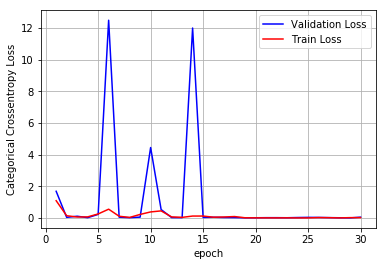

In [59]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9895633903074775
------------------------------------------------------


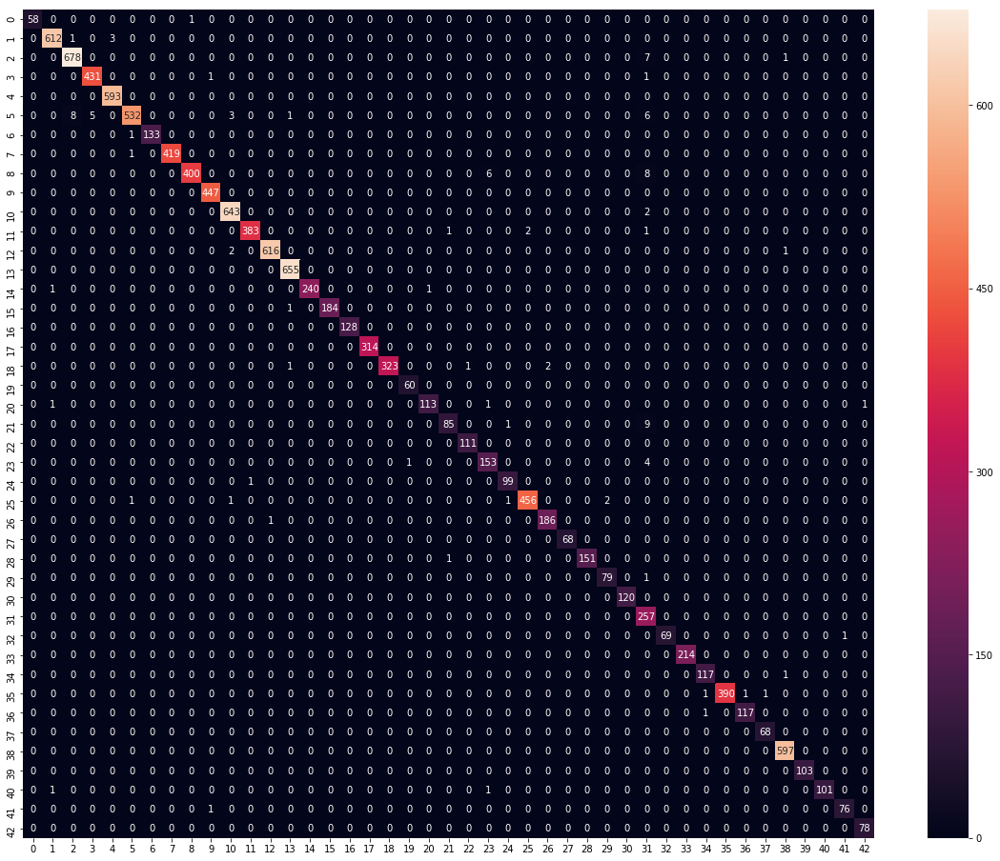

In [60]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

### [5.10] Pretrained model - ResNet

In [0]:
from keras.applications.resnet50 import ResNet50

In [44]:
input_tensor = Input(shape=(75, 75, 3))
base_model = ResNet50(
    weights='imagenet', include_top=False, input_tensor=input_tensor
)
x = base_model.output
x = Flatten()(x)
x = Dense(1024, activation='relu')(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x) 
preds = Dense(43, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=preds)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_9 (InputLayer)            (None, 75, 75, 3)    0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 81, 81, 3)    0           input_9[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 38, 38, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 38, 38, 64)   256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [45]:
epochs = 10
batch_size = 128
model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer='adam', metrics=['accuracy']
)

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

Train on 27446 samples, validate on 11763 samples
Epoch 1/10
27446/27446 [==============================] - 87s 3ms/step - loss: 0.7010 - acc: 0.8371 - val_loss: 2.0186 - val_acc: 0.6619
Epoch 2/10
27446/27446 [==============================] - 67s 2ms/step - loss: 0.3925 - acc: 0.9297 - val_loss: 4.9518 - val_acc: 0.4046
Epoch 3/10
27446/27446 [==============================] - 67s 2ms/step - loss: 0.3809 - acc: 0.9383 - val_loss: 14.5182 - val_acc: 0.0807
Epoch 4/10
27446/27446 [==============================] - 68s 2ms/step - loss: 0.3514 - acc: 0.9551 - val_loss: 0.5712 - val_acc: 0.8674
Epoch 5/10
27446/27446 [==============================] - 68s 2ms/step - loss: 0.3414 - acc: 0.9418 - val_loss: 15.1771 - val_acc: 0.0583
Epoch 6/10
27446/27446 [==============================] - 67s 2ms/step - loss: 0.6216 - acc: 0.8790 - val_loss: 0.3520 - val_acc: 0.9090
Epoch 7/10
27446/27446 [==============================] - 67s 2ms/step - loss: 0.3003 - acc: 0.9504 - val_loss: 0.5493 - val_a

Test loss: 0.06837457236981444
Test accuracy: 0.9802771401853269


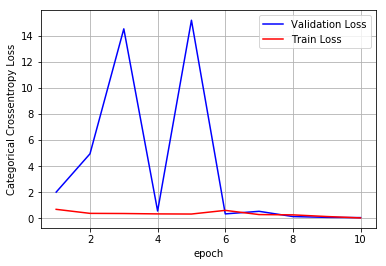

In [46]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9738579678014587
------------------------------------------------------


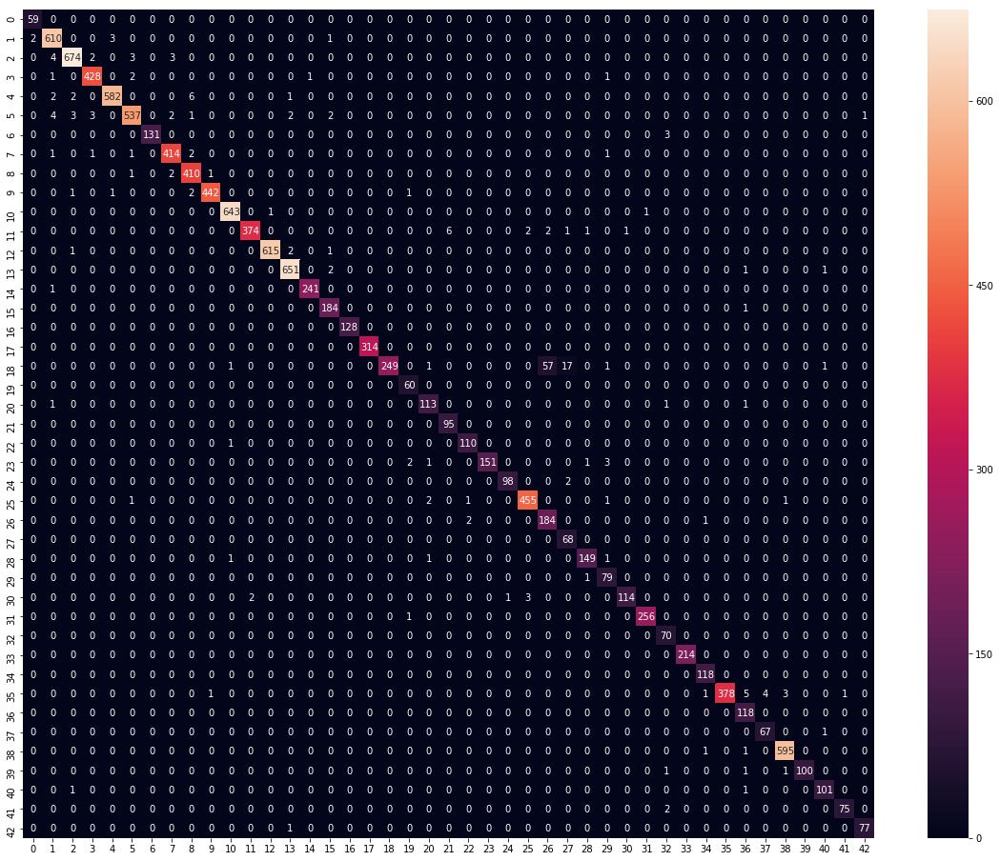

In [47]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

In [65]:
input_tensor = Input(shape=(75, 75, 3))
base_model = ResNet50(
    weights='imagenet', include_top=False, input_tensor=input_tensor
)
x = base_model.output
x = Flatten()(x)
x = Dense(2048, activation='relu')(x) # changed this
x = Dropout(0.5)(x)
x = Dense(1024, activation='relu')(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x) 
preds = Dense(43, activation='softmax')(x)
model = Model(inputs=base_model.input, outputs=preds)
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_14 (InputLayer)           (None, 75, 75, 3)    0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 81, 81, 3)    0           input_14[0][0]                   
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 38, 38, 64)   9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 38, 38, 64)   256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [66]:
epochs = 30
batch_size = 128
model.compile(
    loss=keras.losses.categorical_crossentropy, 
    optimizer='adam', metrics=['accuracy']
)

history = model.fit(
    x_train, y_train, batch_size=batch_size, epochs=epochs, 
    verbose=1, validation_data=(x_test, y_test)
)

Train on 27446 samples, validate on 11763 samples
Epoch 1/30
27446/27446 [==============================] - 104s 4ms/step - loss: 0.8291 - acc: 0.7990 - val_loss: 0.2670 - val_acc: 0.9413
Epoch 2/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.4732 - acc: 0.9277 - val_loss: 15.5796 - val_acc: 0.0334
Epoch 3/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.4766 - acc: 0.9243 - val_loss: 0.1417 - val_acc: 0.9722
Epoch 4/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.0486 - acc: 0.9901 - val_loss: 0.0397 - val_acc: 0.9908
Epoch 5/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.0789 - acc: 0.9863 - val_loss: 0.0682 - val_acc: 0.9862
Epoch 6/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.0744 - acc: 0.9866 - val_loss: 6.8046 - val_acc: 0.4894
Epoch 7/30
27446/27446 [==============================] - 73s 3ms/step - loss: 0.7481 - acc: 0.8361 - val_loss: 0.5024 - val_a

Test loss: 0.06375567363019534
Test accuracy: 0.9865680523675933


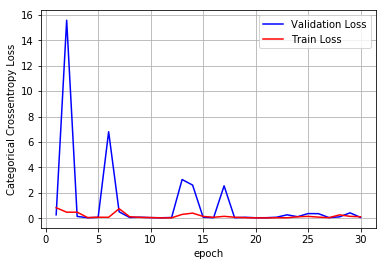

In [67]:
score = model.evaluate(x_test, y_test, verbose=0) 
print('Test loss:', score[0]) 
print('Test accuracy:', score[1])

fig,ax = plt.subplots(1,1)
ax.set_xlabel('epoch') 
ax.set_ylabel('Categorical Crossentropy Loss')

# list of epoch numbers
x = list(range(1,epochs+1))

vy = history.history['val_loss']
ty = history.history['loss']
plt_dynamic(fig, x, vy, ty, ax)

------------------------------------------------------
Macro F1 score 0.9856152128724683
------------------------------------------------------


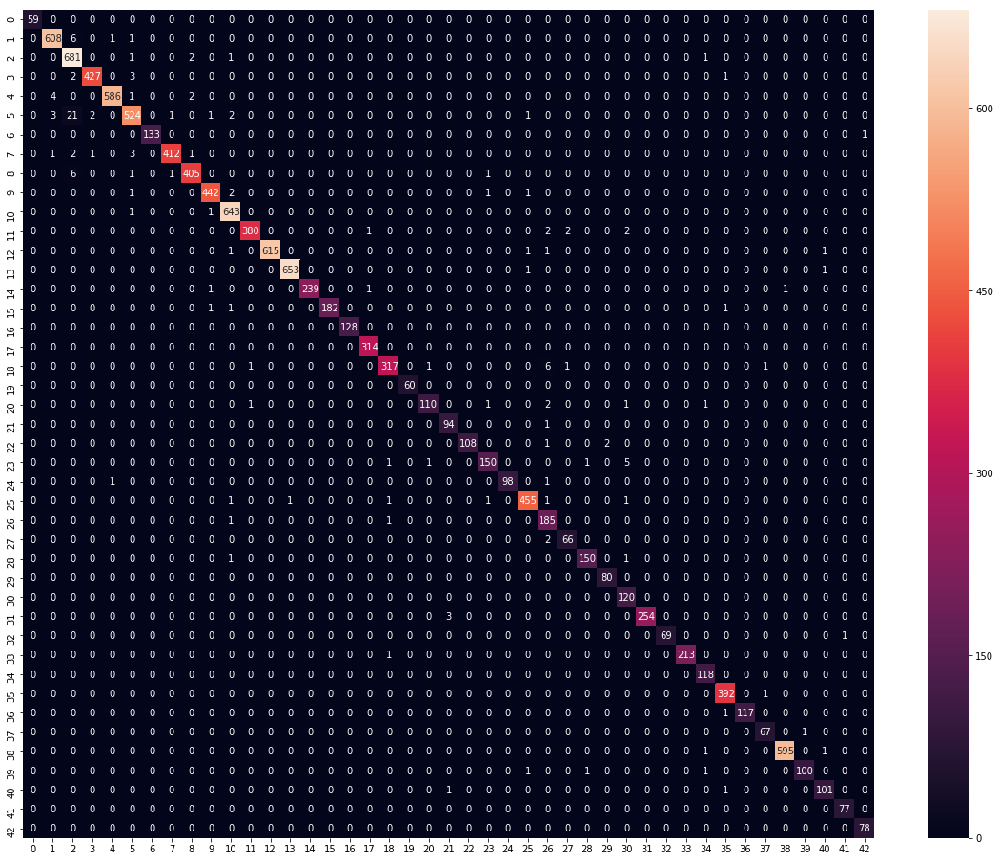

In [68]:
plt.figure(figsize=(20,16))
y_prediction = model.predict(x_test)
# Convert predictions classes to one hot vectors 
y_pred_classes = np.argmax(y_prediction, axis = 1) 
# Convert validation observations to one hot vectors
y_true = np.argmax(y_test, axis = 1) 
# compute the confusion matrix
print("------------------------------------------------------")
print("Macro F1 score", f1_score(y_true, y_pred_classes, average='macro'))
print("------------------------------------------------------")
confusion_mtx = confusion_matrix(y_true, y_pred_classes) 
sns.heatmap(confusion_mtx, annot=True, fmt="d")

## [6] Conclusion

In [2]:
from prettytable import PrettyTable
x = PrettyTable()
x.field_names = ["Model", "Test Macro F1 score"]

In [3]:
x.add_row(["Conv(8-3x3)-Conv(16-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)", 0.9713559900036074])
x.add_row(["Conv(16-3x3)-Conv(32-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)", 0.9825943781471229])
x.add_row(["Conv(32-4x4)-Conv(64-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)", 0.9849328128373525])
x.add_row(['''Conv(32-4x4)-Conv(64-3x3)-MaxPool(2x2)-Conv(32-4x4)
-Dropout(0.75)-Dense(128)-Dropout(0.5)''', 0.989949258229611])
x.add_row(['''Conv(32-4x4)-Conv(64-3x3)-MaxPool(2x2)-Conv(32-4x4)-Dropout(0.75)
-MaxPool(2x2)-Conv(32-3x3)-Dense(256)-Dropout(0.5)-Dense(128)-Dropout(0.5)''', 0.9907992327028173])
x.add_row(['''Conv(32-3x3)-Conv(64-3x3)-MaxPool(2x2)-Conv(32-3x3)-Dropout(0.75)
-MaxPool(2x2)-Conv(32-3x3)-Dense(256)-Dropout(0.5)-Dense(128)-Dropout(0.5) with Class Weights''', 0.9890381708275221])
x.add_row(["RetinaNet", 0.9137298711811357])
x.add_row(["VGG16", 0.9636527764362784])
x.add_row(["Inception", 0.9895633903074775])
x.add_row(["ResNet", 0.9856152128724683])
print(x)

+-----------------------------------------------------------------------------------------------+---------------------+
|                                             Model                                             | Test Macro F1 score |
+-----------------------------------------------------------------------------------------------+---------------------+
|          Conv(8-3x3)-Conv(16-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)          |  0.9713559900036074 |
|          Conv(16-3x3)-Conv(32-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)         |  0.9825943781471229 |
|          Conv(32-4x4)-Conv(64-3x3)-MaxPool(2x2)-Dropout(0.75)-Dense(128)-Dropout(0.5)         |  0.9849328128373525 |
|                      Conv(32-4x4)-Conv(64-3x3)-MaxPool(2x2)-Conv(32-4x4)                      |  0.989949258229611  |
|                             -Dropout(0.75)-Dense(128)-Dropout(0.5)                            |                     |
|               Conv(32-4x4)-Conv(64-3x3

## Procedure

1. Downloaded the data and explored the folder structure involved.
2. Merged all the csv file into one dataframe (each class had a different csv file).
3. Appended the class id to file name and moved all images into one folder.
4. Plotted a bar graph to see the distribution of classes.
5. Cropped images and converted them into grey scale.
6. Converted all grey images into ndarray and split the data into train and test.
7. Wrote utility functions that help us better understand the neural network.
8. Built 10 different CNN models(including transfer learning) and plotted their confusion matrix using heat maps.
9. Trained RetinaNet which does both, predicts the location of traffic sign in the image and also classifies it into a class.
10. Recorded their micro F1 score and compared them in a table at the end.



